In [1]:
import sys
import os
from glob import glob
sys.path.append("../NEAT")
from NEATModels import NEATStatic, nets
from NEATModels.Staticconfig  import static_config
from NEATUtils import helpers
from NEATUtils.helpers import save_json, load_json
os.environ["CUDA_VISIBLE_DEVICES"]="0"
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

Using TensorFlow backend.


In [2]:
npz_directory = '/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/LandmarkData/'
npz_name = 'Landmark128.npz'
npz_val_name = 'Landmark128Val.npz'

model_dir = '/home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/'
#Model name based on wether it is residual or sequntial ONEAT network
model_name = 'Landmark128K7s48d56.h5'


In [3]:
static_categories_json = model_dir + 'StaticCategories.json'
key_categories = load_json(static_categories_json)
static_cord_json = model_dir + 'StaticCord.json'
key_cord = load_json(static_cord_json)

#For ORNET use residual = True and for OSNET use residual = False
residual = False
#NUmber of starting convolutional filters, is doubled down with increasing depth
startfilter = 48
#CNN network start layer, mid layers and lstm layer kernel size
start_kernel = 7
mid_kernel = 7
#Network depth has to be 9n + 2, n= 3 or 4 is optimal for Notum dataset
depth = 56
#Size of the gradient descent length vector, start small and use callbacks to get smaller when reaching the minima
learning_rate = 1.0E-4
#For stochastic gradient decent, the batch size used for computing the gradients
batch_size = 10
# use softmax for single event per box, sigmoid for multi event per box
multievent = False
# Trainng image size
yolo_v0 = True
show = True
#Training epochs, longer the better with proper chosen learning rate
epochs = 250
nboxes = 1
#The inbuilt model stride which is equal to the nulber of times image was downsampled by the network
stride = 4
show = True
imagex = 128
imagey = 128

In [4]:
config = static_config(npz_directory =npz_directory, npz_name = npz_name, npz_val_name = npz_val_name, 
                         key_categories = key_categories, key_cord = key_cord, 
                         residual = residual, depth = depth, start_kernel = start_kernel, stride = stride, mid_kernel = mid_kernel,
                         startfiler = startfilter, nboxes = nboxes, gridx = 1, gridy = 1, show = show,
                         epochs = epochs, learning_rate = learning_rate, imagex = imagex, imagey = imagey,
                         batch_size = batch_size, model_name = model_name, yolo_v0 = yolo_v0, multievent = multievent)

config_json = config.to_json()

print(config)
save_json(config_json, model_dir + os.path.splitext(model_name)[0] + '_Parameter.json')

static_config(batch_size=10, box_vector=2, categories=2, depth=56, epochs=250, gridx=1, gridy=1, imagex=128, imagey=128, key_categories={'Background': 0, 'Landmark': 1}, key_cord={'x': 0, 'y': 1}, learning_rate=0.0001, mid_kernel=7, model_name='Landmark128K7s48d56.h5', multievent=False, nboxes=1, npz_directory='/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/LandmarkData/', npz_name='Landmark128.npz', npz_val_name='Landmark128Val.npz', residual=False, show=True, start_kernel=7, startfilter=32, stride=(4,), yolo_v0=True)


number of  images:	 3546
image size (2D):		 (128, 128)
axes:				 SXYC
channels in / out:		 1
number of  images:	 187
image size (2D):		 (128, 128)
axes:				 SXYC
channels in / out:		 1
loading weights
(3546, 1, 1, 4) 1














Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 1 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 3 1600        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, None, None, 3 128         conv2d_1[0][0]                   
_________________________________________________________

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 3546 samples, validate on 187 samples
Epoch 1/250
3546/3546 [==============================] - 86s 24ms/step - loss: 0.5662 - acc: 0.9791 - val_loss: 0.5449 - val_acc: 0.9893

Epoch 00001: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.544946970467899, 'val_acc': 0.9893048102842933, 'loss': 0.5661620483247829, 'acc': 0.9791314120825172, 'lr': 1e-04}


<Figure size 432x288 with 0 Axes>

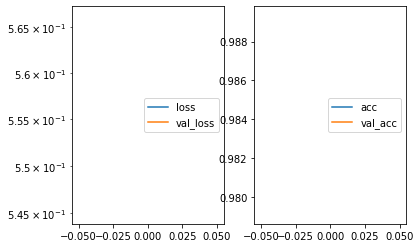

Predicted cell: Landmark Probability: [[0.99998903]]
True Cell type: Landmark
x [[0.46375376]]
True positional value x 0.421875
y [[0.4819479]]
True positional value y 0.5


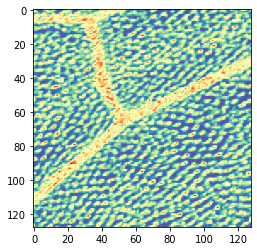

Epoch 2/250
3546/3546 [==============================] - 79s 22ms/step - loss: 0.5389 - acc: 0.9856 - val_loss: 0.6489 - val_acc: 0.9198

Epoch 00002: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.6489352207770323, 'val_acc': 0.9197860914755632, 'loss': 0.5389005316561114, 'acc': 0.9856175947041412, 'lr': 1e-04}


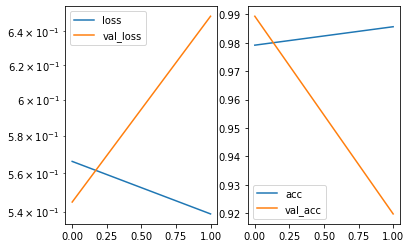

Predicted cell: Landmark Probability: [[0.9519035]]
True Cell type: Landmark
x [[0.38719037]]
True positional value x 0.421875
y [[0.48420435]]
True positional value y 0.5


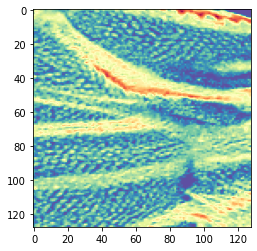

Epoch 3/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5229 - acc: 0.9901 - val_loss: 0.5780 - val_acc: 0.9679

Epoch 00003: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5780424778474206, 'val_acc': 0.9679144308528799, 'loss': 0.5229484102044211, 'acc': 0.9901297214470942, 'lr': 1e-04}


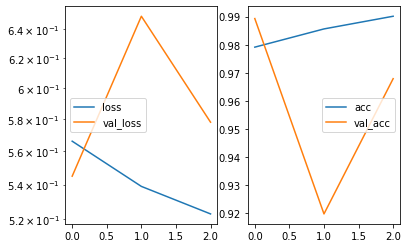

Predicted cell: Landmark Probability: [[0.99605906]]
True Cell type: Landmark
x [[0.48820877]]
True positional value x 0.5
y [[0.41248313]]
True positional value y 0.421875


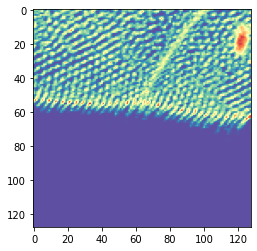

Epoch 4/250
3546/3546 [==============================] - 83s 23ms/step - loss: 0.5210 - acc: 0.9924 - val_loss: 0.5476 - val_acc: 0.9893

Epoch 00004: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5476423763336344, 'val_acc': 0.9893048102842933, 'loss': 0.5209671358267466, 'acc': 0.9923857849866605, 'lr': 1e-04}


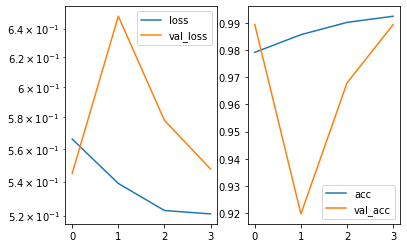

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5807539]]
True positional value x 0.578125
y [[0.5790425]]
True positional value y 0.578125


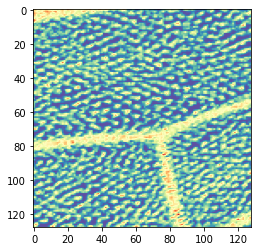

Epoch 5/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5100 - acc: 0.9946 - val_loss: 0.5494 - val_acc: 0.9893

Epoch 00005: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5493990195626244, 'val_acc': 0.9893048102842933, 'loss': 0.5100284256608353, 'acc': 0.9946418486943167, 'lr': 1e-04}


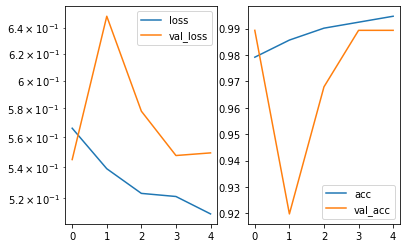

Predicted cell: Landmark Probability: [[0.98986393]]
True Cell type: Landmark
x [[0.49658954]]
True positional value x 0.421875
y [[0.52020466]]
True positional value y 0.5


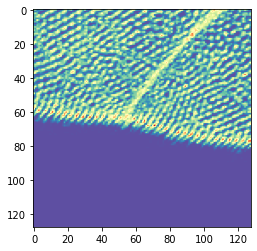

Epoch 6/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5080 - acc: 0.9969 - val_loss: 0.5316 - val_acc: 0.9947

Epoch 00006: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5315548583147998, 'val_acc': 0.9946524051421466, 'loss': 0.5079596559173026, 'acc': 0.9968979124019728, 'lr': 1e-04}


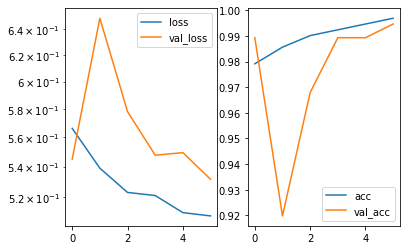

Predicted cell: Landmark Probability: [[0.99994135]]
True Cell type: Landmark
x [[0.4156893]]
True positional value x 0.421875
y [[0.40899864]]
True positional value y 0.421875


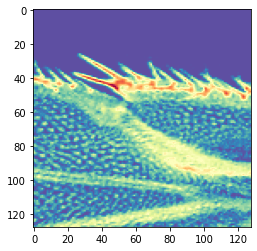

Epoch 7/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5057 - acc: 0.9977 - val_loss: 0.5617 - val_acc: 0.9947

Epoch 00007: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5616994270666398, 'val_acc': 0.9946524051421466, 'loss': 0.505669845340619, 'acc': 0.9977439362923439, 'lr': 1e-04}


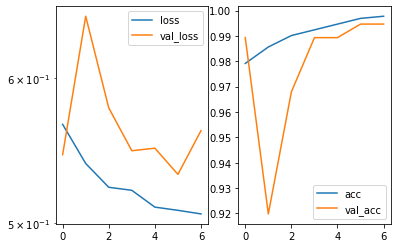

Predicted cell: Landmark Probability: [[0.9999676]]
True Cell type: Landmark
x [[0.4046456]]
True positional value x 0.421875
y [[0.55709577]]
True positional value y 0.578125


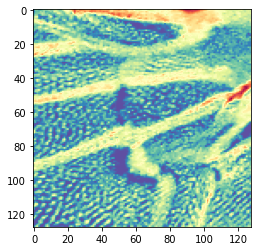

Epoch 8/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5032 - acc: 0.9977 - val_loss: 0.5532 - val_acc: 0.9893

Epoch 00008: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5531721743032894, 'val_acc': 0.9893048102842933, 'loss': 0.5031615355831045, 'acc': 0.9977439362923439, 'lr': 1e-04}


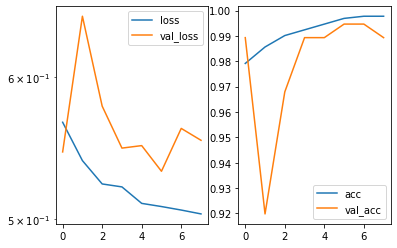

Predicted cell: Background Probability: [[0.9981179]]
True Cell type: Background
x [[0.5047324]]
True positional value x 0.5
y [[0.5399364]]
True positional value y 0.5


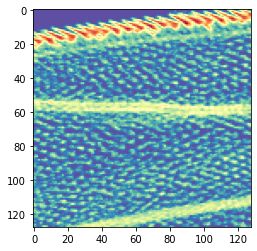

Epoch 9/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5006 - acc: 0.9980 - val_loss: 0.5378 - val_acc: 0.9947

Epoch 00009: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5377819695893455, 'val_acc': 0.9946524051421466, 'loss': 0.5005753870845446, 'acc': 0.9980259442558009, 'lr': 1e-04}


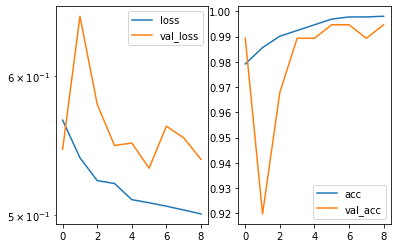

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.5759884]]
True positional value x 0.578125
y [[0.5257496]]
True positional value y 0.5


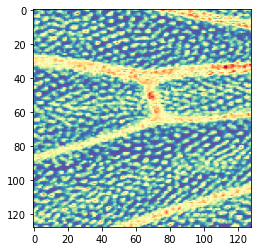

Epoch 10/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4986 - acc: 0.9980 - val_loss: 0.5332 - val_acc: 0.9893

Epoch 00010: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5332154373434138, 'val_acc': 0.9893048102842933, 'loss': 0.4985935975452365, 'acc': 0.9980259442558009, 'lr': 1e-04}


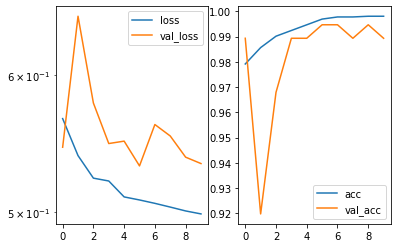

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4995473]]
True positional value x 0.5
y [[0.5085295]]
True positional value y 0.5


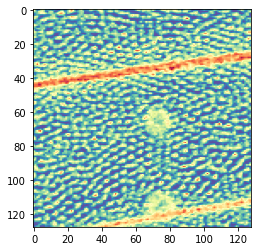

Epoch 11/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4980 - acc: 0.9980 - val_loss: 0.5702 - val_acc: 0.9947

Epoch 00011: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5702389548806583, 'val_acc': 0.9946524051421466, 'loss': 0.49800558335284895, 'acc': 0.9980259442558009, 'lr': 1e-04}


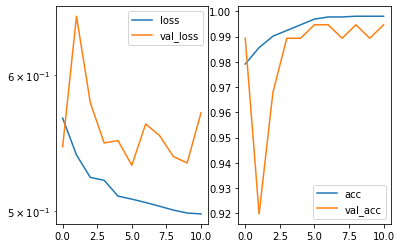

Predicted cell: Background Probability: [[0.99999845]]
True Cell type: Background
x [[0.5257887]]
True positional value x 0.5
y [[0.50692093]]
True positional value y 0.5


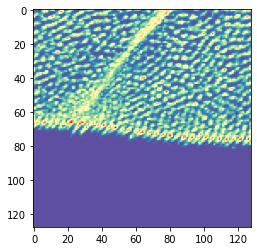

Epoch 12/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4939 - acc: 0.9997 - val_loss: 0.5107 - val_acc: 0.9947

Epoch 00012: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5106500060481821, 'val_acc': 0.9946524051421466, 'loss': 0.4938743397534667, 'acc': 0.999717992036543, 'lr': 1e-04}


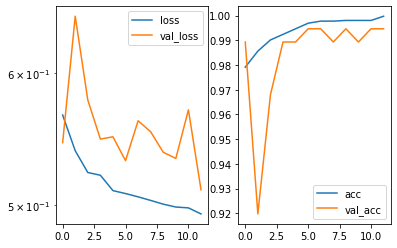

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5119143]]
True positional value x 0.5
y [[0.49337682]]
True positional value y 0.5


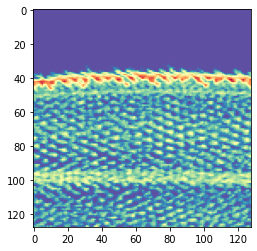

Epoch 13/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4919 - acc: 1.0000 - val_loss: 0.5025 - val_acc: 0.9947

Epoch 00013: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5024685344912789, 'val_acc': 0.9946524051421466, 'loss': 0.4919053801895869, 'acc': 1.0, 'lr': 1e-04}


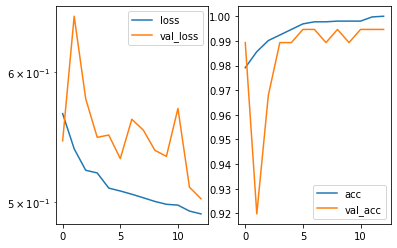

Predicted cell: Landmark Probability: [[0.87943816]]
True Cell type: Background
x [[0.5152545]]
True positional value x 0.5
y [[0.48907742]]
True positional value y 0.5


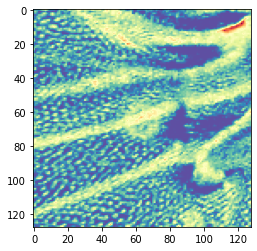

Epoch 14/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4911 - acc: 0.9997 - val_loss: 0.5173 - val_acc: 0.9947

Epoch 00014: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5172847726128318, 'val_acc': 0.9946524051421466, 'loss': 0.49110605349597186, 'acc': 0.999717992036543, 'lr': 1e-04}


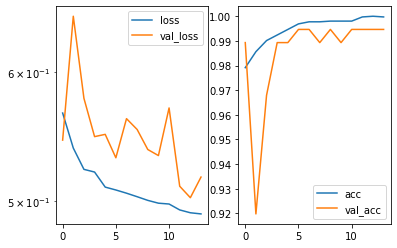

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4894272]]
True positional value x 0.5
y [[0.43461066]]
True positional value y 0.421875


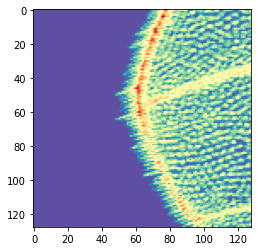

Epoch 15/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4908 - acc: 0.9997 - val_loss: 0.5142 - val_acc: 0.9947

Epoch 00015: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5141584981571544, 'val_acc': 0.9946524051421466, 'loss': 0.49075495716009987, 'acc': 0.999717992036543, 'lr': 1e-04}


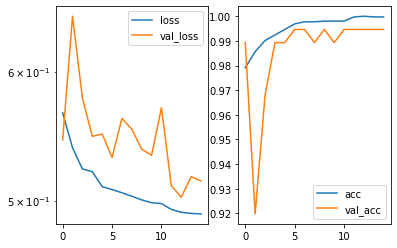

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.44115925]]
True positional value x 0.421875
y [[0.5921906]]
True positional value y 0.578125


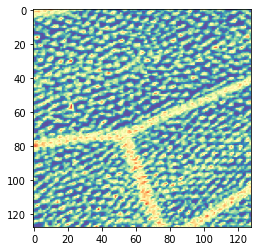

Epoch 16/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4891 - acc: 1.0000 - val_loss: 0.5169 - val_acc: 0.9947

Epoch 00016: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5168646766858942, 'val_acc': 0.9946524051421466, 'loss': 0.48913252903321874, 'acc': 1.0, 'lr': 1e-04}


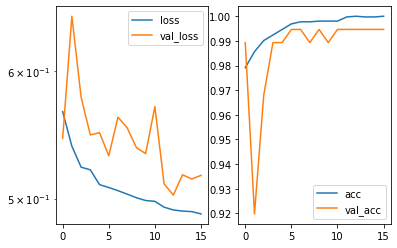

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4760966]]
True positional value x 0.5
y [[0.5078877]]
True positional value y 0.5


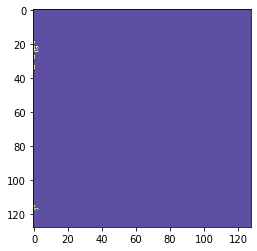

Epoch 17/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4891 - acc: 1.0000 - val_loss: 0.5118 - val_acc: 0.9947

Epoch 00017: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5118190477238619, 'val_acc': 0.9946524051421466, 'loss': 0.4890869956230351, 'acc': 1.0, 'lr': 1e-04}


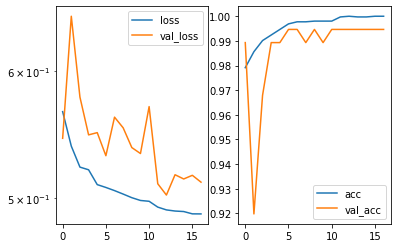

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47607905]]
True positional value x 0.5
y [[0.47297072]]
True positional value y 0.5


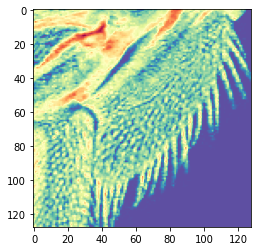

Epoch 18/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4878 - acc: 1.0000 - val_loss: 0.5176 - val_acc: 0.9947

Epoch 00018: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5175968470739171, 'val_acc': 0.9946524051421466, 'loss': 0.4878300555802575, 'acc': 1.0, 'lr': 1e-04}


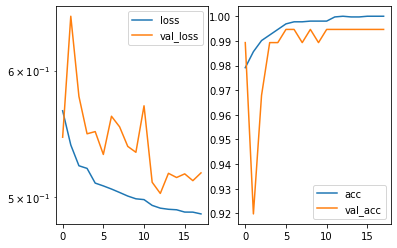

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.48755035]]
True positional value x 0.5
y [[0.47407985]]
True positional value y 0.5


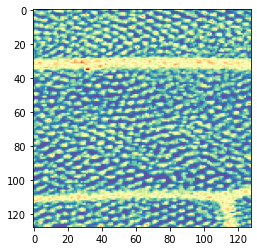

Epoch 19/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4869 - acc: 1.0000 - val_loss: 0.5182 - val_acc: 0.9947

Epoch 00019: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5181803257070123, 'val_acc': 0.9946524051421466, 'loss': 0.4869350544725914, 'acc': 1.0, 'lr': 1e-04}


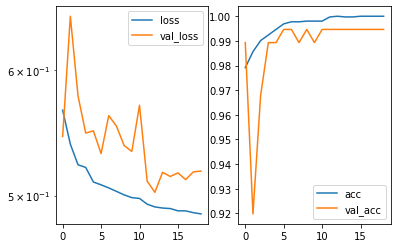

Predicted cell: Landmark Probability: [[0.999881]]
True Cell type: Landmark
x [[0.59444207]]
True positional value x 0.578125
y [[0.58294463]]
True positional value y 0.578125


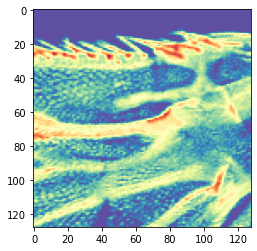

Epoch 20/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4860 - acc: 1.0000 - val_loss: 0.5102 - val_acc: 0.9947

Epoch 00020: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5102187728180605, 'val_acc': 0.9946524051421466, 'loss': 0.486030534926741, 'acc': 1.0, 'lr': 1e-04}


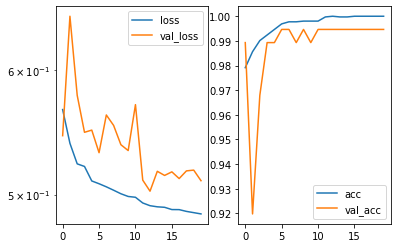

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5611685]]
True positional value x 0.578125
y [[0.48040646]]
True positional value y 0.5


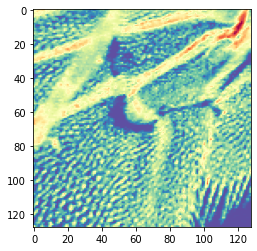

Epoch 21/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4853 - acc: 1.0000 - val_loss: 0.5066 - val_acc: 0.9947

Epoch 00021: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5066081436878858, 'val_acc': 0.9946524051421466, 'loss': 0.4852583124452033, 'acc': 1.0, 'lr': 1e-04}


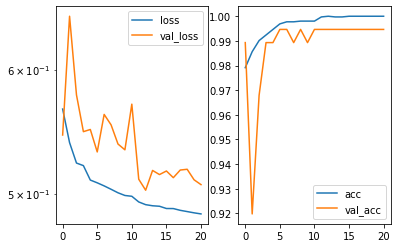

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.56906396]]
True positional value x 0.578125
y [[0.5020996]]
True positional value y 0.5


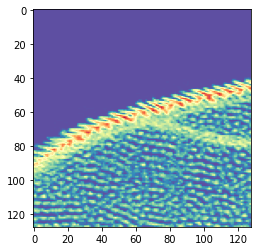

Epoch 22/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4845 - acc: 1.0000 - val_loss: 0.5054 - val_acc: 0.9947

Epoch 00022: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5053547015164626, 'val_acc': 0.9946524051421466, 'loss': 0.48453326214859194, 'acc': 1.0, 'lr': 1e-04}


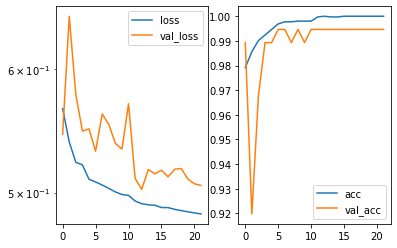

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47509587]]
True positional value x 0.5
y [[0.52478135]]
True positional value y 0.5


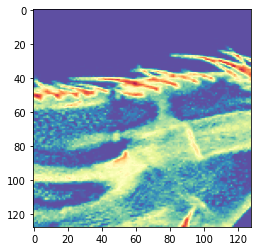

Epoch 23/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4845 - acc: 0.9997 - val_loss: 0.5276 - val_acc: 0.9893

Epoch 00023: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5276051045739077, 'val_acc': 0.9893048102842933, 'loss': 0.4844600462637846, 'acc': 0.999717992036543, 'lr': 1e-04}


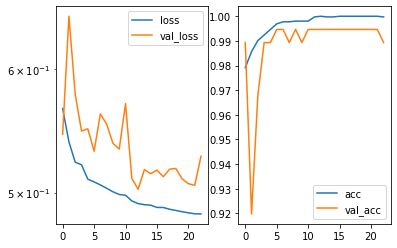

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.48862293]]
True positional value x 0.5
y [[0.49003345]]
True positional value y 0.5


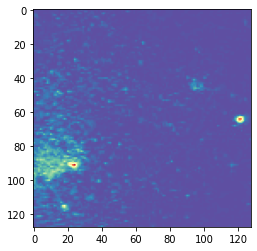

Epoch 24/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4846 - acc: 0.9994 - val_loss: 0.5130 - val_acc: 0.9893

Epoch 00024: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5130232177316186, 'val_acc': 0.9893048102842933, 'loss': 0.4845829103299607, 'acc': 0.999435984073086, 'lr': 1e-04}


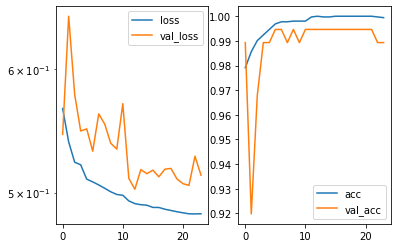

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5710608]]
True positional value x 0.578125
y [[0.49925622]]
True positional value y 0.5


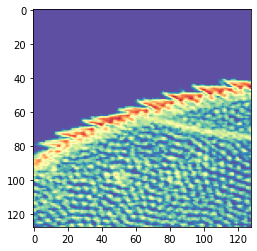

Epoch 25/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5358 - acc: 0.9836 - val_loss: 0.6540 - val_acc: 0.9679

Epoch 00025: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.6539748236138553, 'val_acc': 0.967914434040294, 'loss': 0.5358322773420804, 'acc': 0.9836435387918523, 'lr': 1e-04}


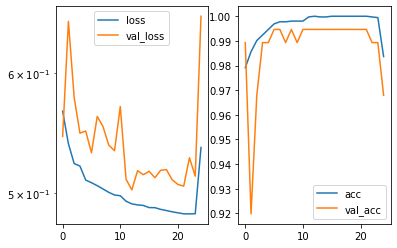

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49341828]]
True positional value x 0.5
y [[0.49069732]]
True positional value y 0.5


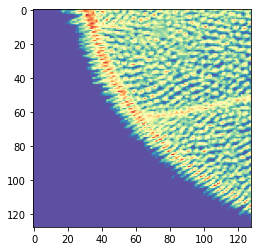

Epoch 26/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.5032 - acc: 0.9924 - val_loss: 0.5145 - val_acc: 0.9893

Epoch 00026: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.

Epoch 00026: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5144664345578076, 'val_acc': 0.9893048102842933, 'loss': 0.5031607708081107, 'acc': 0.9923857849866605, 'lr': 1e-04}


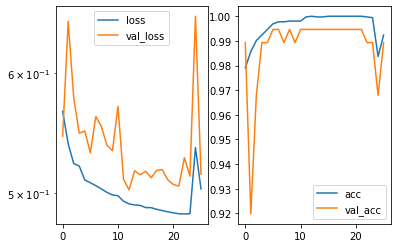

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.53535384]]
True positional value x 0.578125
y [[0.3938779]]
True positional value y 0.421875


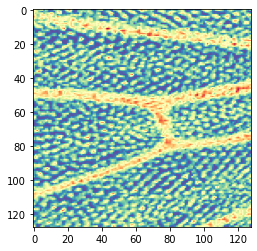

Epoch 27/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4971 - acc: 0.9955 - val_loss: 0.5348 - val_acc: 0.9947

Epoch 00027: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5347827610803798, 'val_acc': 0.9946524051421466, 'loss': 0.49710752591868945, 'acc': 0.9954878725846877, 'lr': 1e-05}


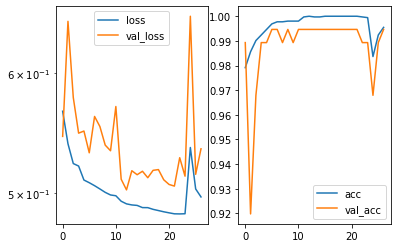

Predicted cell: Landmark Probability: [[0.99999833]]
True Cell type: Landmark
x [[0.48660743]]
True positional value x 0.421875
y [[0.57019526]]
True positional value y 0.421875


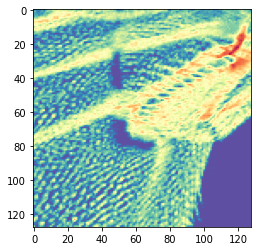

Epoch 28/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4849 - acc: 0.9989 - val_loss: 0.5290 - val_acc: 0.9947

Epoch 00028: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5290381216747876, 'val_acc': 0.9946524051421466, 'loss': 0.4849201467033167, 'acc': 0.998871968146172, 'lr': 1e-05}


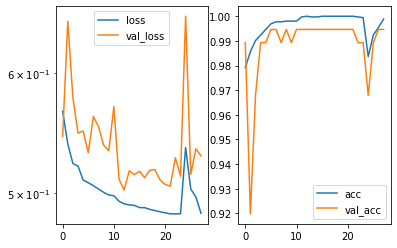

Predicted cell: Background Probability: [[0.99999905]]
True Cell type: Background
x [[0.4795811]]
True positional value x 0.5
y [[0.48968023]]
True positional value y 0.5


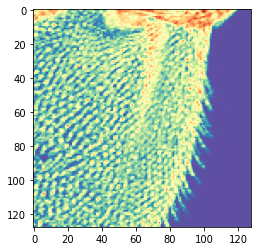

Epoch 29/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4839 - acc: 0.9992 - val_loss: 0.5283 - val_acc: 0.9947

Epoch 00029: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5282779506502304, 'val_acc': 0.9946524051421466, 'loss': 0.48385651713028105, 'acc': 0.999153976109629, 'lr': 1e-05}


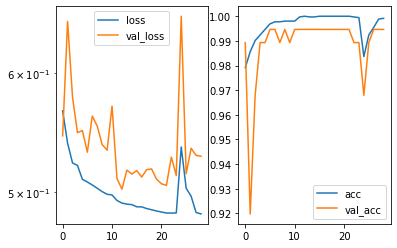

Predicted cell: Landmark Probability: [[0.9999839]]
True Cell type: Landmark
x [[0.43910807]]
True positional value x 0.421875
y [[0.4635182]]
True positional value y 0.421875


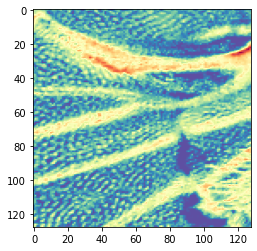

Epoch 30/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4843 - acc: 0.9992 - val_loss: 0.5229 - val_acc: 0.9947

Epoch 00030: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522929067439574, 'val_acc': 0.9946524051421466, 'loss': 0.4842666137104174, 'acc': 0.999153976109629, 'lr': 1e-05}


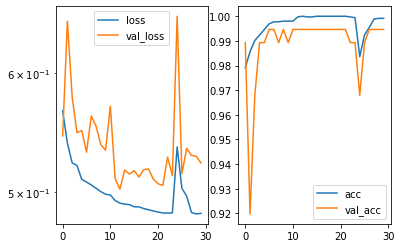

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5002288]]
True positional value x 0.5
y [[0.4876712]]
True positional value y 0.5


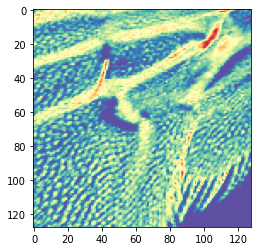

Epoch 31/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4832 - acc: 0.9997 - val_loss: 0.5255 - val_acc: 0.9947

Epoch 00031: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5255330130059451, 'val_acc': 0.9946524051421466, 'loss': 0.48320690884942463, 'acc': 0.999717992036543, 'lr': 1e-05}


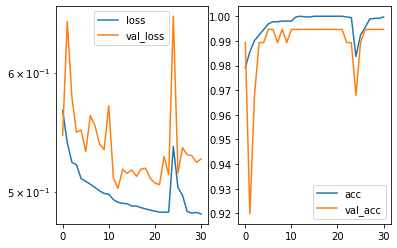

Predicted cell: Landmark Probability: [[0.9987533]]
True Cell type: Landmark
x [[0.57959056]]
True positional value x 0.578125
y [[0.5878624]]
True positional value y 0.578125


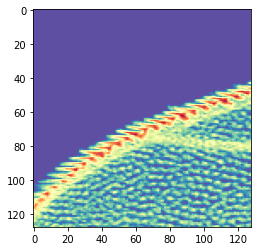

Epoch 32/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4841 - acc: 0.9989 - val_loss: 0.5238 - val_acc: 0.9947

Epoch 00032: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5238042112021523, 'val_acc': 0.9946524051421466, 'loss': 0.484135238551448, 'acc': 0.998871968146172, 'lr': 1e-05}


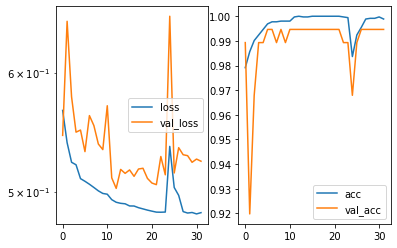

Predicted cell: Landmark Probability: [[0.9999995]]
True Cell type: Landmark
x [[0.50914294]]
True positional value x 0.421875
y [[0.5557799]]
True positional value y 0.421875


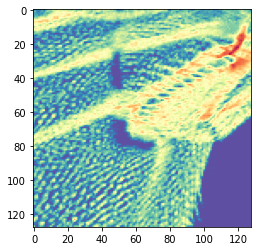

Epoch 33/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 0.9997 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00033: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216062720765404, 'val_acc': 0.9946524051421466, 'loss': 0.4823650715550123, 'acc': 0.999717992036543, 'lr': 1e-05}


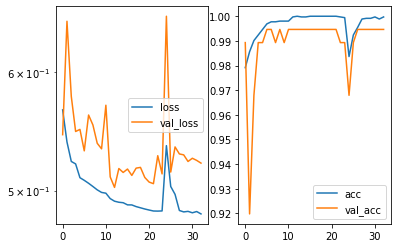

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5172875]]
True positional value x 0.5
y [[0.48802805]]
True positional value y 0.5


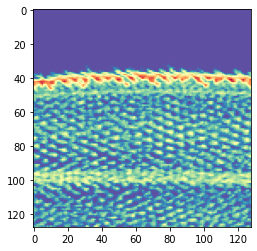

Epoch 34/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 1.0000 - val_loss: 0.5224 - val_acc: 0.9947

Epoch 00034: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5223887255166304, 'val_acc': 0.9946524051421466, 'loss': 0.48237288127628614, 'acc': 1.0, 'lr': 1e-05}


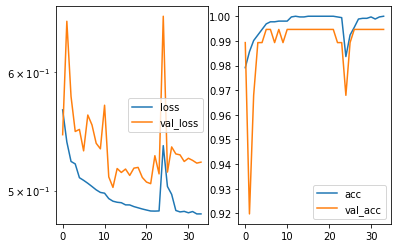

Predicted cell: Background Probability: [[0.9586206]]
True Cell type: Background
x [[0.58090657]]
True positional value x 0.5
y [[0.46764737]]
True positional value y 0.5


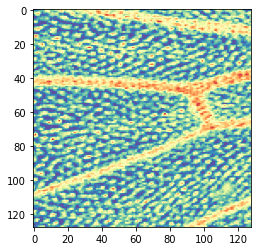

Epoch 35/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4832 - acc: 0.9997 - val_loss: 0.5240 - val_acc: 0.9947

Epoch 00035: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5240251469739619, 'val_acc': 0.9946524051421466, 'loss': 0.4831934993675854, 'acc': 0.999717992036543, 'lr': 1e-05}


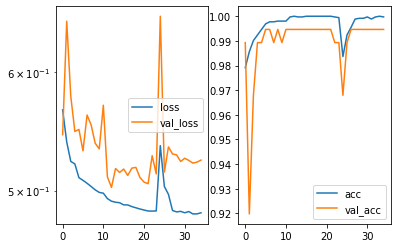

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5303278]]
True positional value x 0.578125
y [[0.50488544]]
True positional value y 0.5


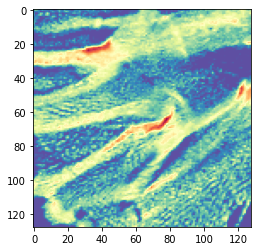

Epoch 36/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 0.9997 - val_loss: 0.5236 - val_acc: 0.9947

Epoch 00036: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5236128610085676, 'val_acc': 0.9946524051421466, 'loss': 0.4823640914233606, 'acc': 0.999717992036543, 'lr': 1e-05}


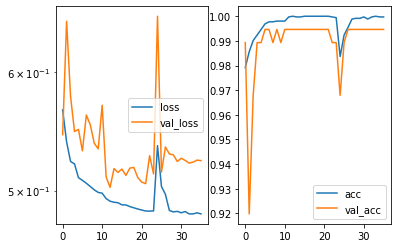

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.49526748]]
True positional value x 0.5
y [[0.5034532]]
True positional value y 0.5


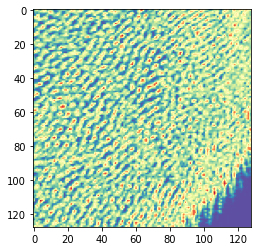

Epoch 37/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9994 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00037: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-07.

Epoch 00037: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217449024399334, 'val_acc': 0.9946524051421466, 'loss': 0.4823353599002653, 'acc': 0.999435984073086, 'lr': 1e-05}


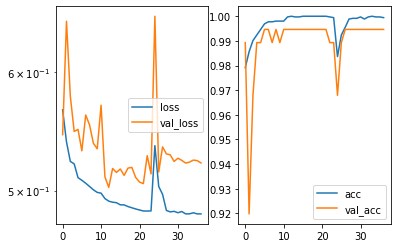

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.51801884]]
True positional value x 0.5
y [[0.5235295]]
True positional value y 0.5


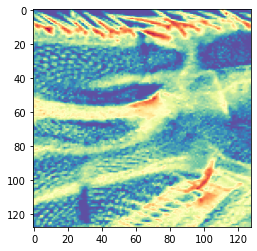

Epoch 38/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00038: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220338131654709, 'val_acc': 0.9946524051421466, 'loss': 0.48215223355476156, 'acc': 0.999717992036543, 'lr': 1e-06}


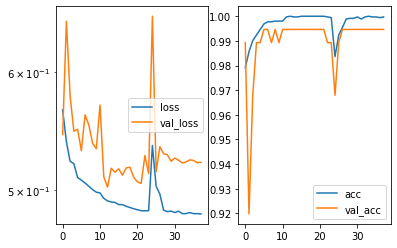

Predicted cell: Landmark Probability: [[0.9999957]]
True Cell type: Landmark
x [[0.5121163]]
True positional value x 0.5
y [[0.5934349]]
True positional value y 0.578125


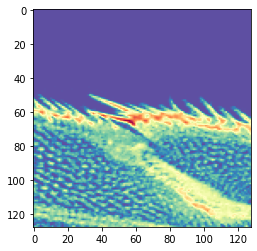

Epoch 39/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4833 - acc: 0.9992 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00039: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212136258415997, 'val_acc': 0.9946524051421466, 'loss': 0.4833138669807899, 'acc': 0.9991539762777187, 'lr': 1e-06}


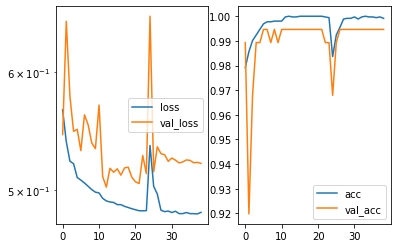

Predicted cell: Background Probability: [[0.99976045]]
True Cell type: Background
x [[0.49571007]]
True positional value x 0.5
y [[0.51160944]]
True positional value y 0.5


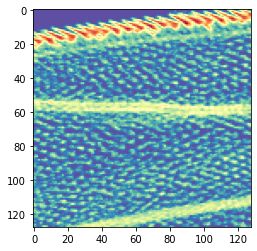

Epoch 40/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5200 - val_acc: 0.9947

Epoch 00040: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5199609150223553, 'val_acc': 0.9946524051421466, 'loss': 0.4816843120478938, 'acc': 1.0, 'lr': 1e-06}


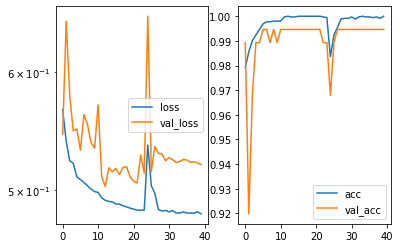

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.5838624]]
True positional value x 0.578125
y [[0.55842686]]
True positional value y 0.578125


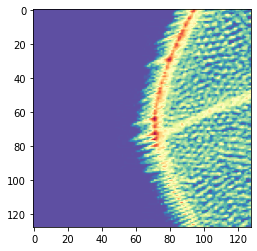

Epoch 41/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4827 - acc: 0.9994 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00041: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204491094153195, 'val_acc': 0.9946524051421466, 'loss': 0.4826916634397727, 'acc': 0.999435984073086, 'lr': 1e-06}


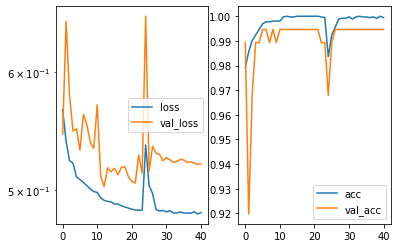

Predicted cell: Background Probability: [[0.99958354]]
True Cell type: Background
x [[0.5273813]]
True positional value x 0.5
y [[0.49658784]]
True positional value y 0.5


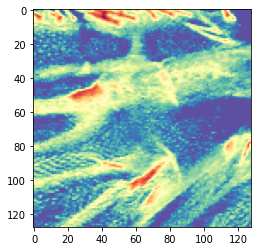

Epoch 42/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00042: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217633722300198, 'val_acc': 0.9946524051421466, 'loss': 0.48146263438970843, 'acc': 1.0, 'lr': 1e-06}


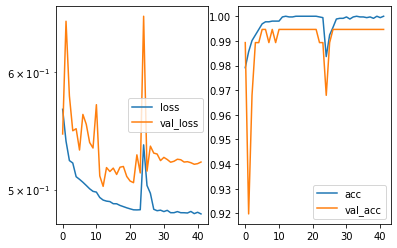

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.41717398]]
True positional value x 0.421875
y [[0.48449352]]
True positional value y 0.5


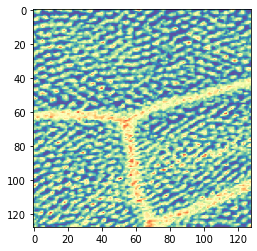

Epoch 43/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5227 - val_acc: 0.9947

Epoch 00043: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5227173912652674, 'val_acc': 0.9946524051421466, 'loss': 0.4817398517601112, 'acc': 1.0, 'lr': 1e-06}


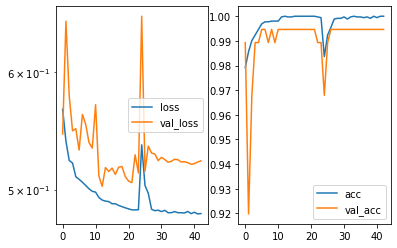

Predicted cell: Landmark Probability: [[0.9999919]]
True Cell type: Landmark
x [[0.48992938]]
True positional value x 0.5
y [[0.56187254]]
True positional value y 0.578125


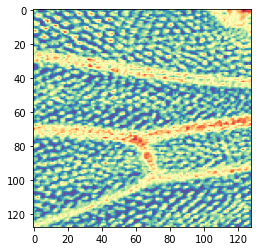

Epoch 44/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00044: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212338912614527, 'val_acc': 0.9946524051421466, 'loss': 0.4817914634657256, 'acc': 0.999717992036543, 'lr': 1e-06}


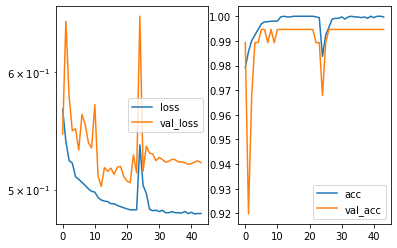

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49649855]]
True positional value x 0.5
y [[0.58292896]]
True positional value y 0.578125


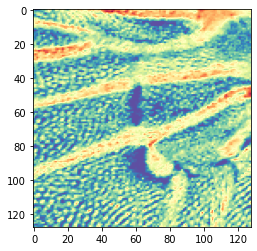

Epoch 45/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4821 - acc: 0.9997 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00045: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206578201788632, 'val_acc': 0.9946524051421466, 'loss': 0.4820679831962026, 'acc': 0.999717992036543, 'lr': 1e-06}


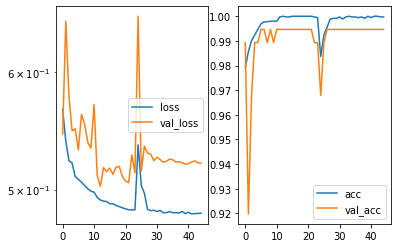

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5070752]]
True positional value x 0.5
y [[0.41244933]]
True positional value y 0.421875


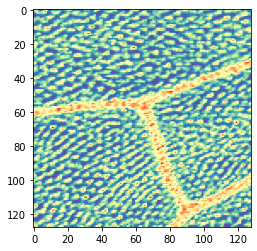

Epoch 46/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00046: ReduceLROnPlateau reducing learning rate to 9.999999974752428e-08.

Epoch 00046: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217486619949341, 'val_acc': 0.9946524051421466, 'loss': 0.4815362956620715, 'acc': 1.0, 'lr': 1e-06}


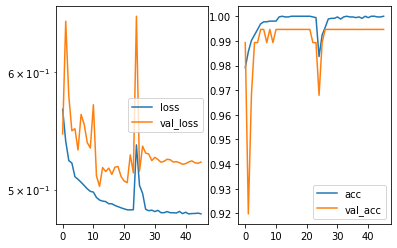

Predicted cell: Landmark Probability: [[0.99999845]]
True Cell type: Landmark
x [[0.5803041]]
True positional value x 0.578125
y [[0.50770617]]
True positional value y 0.5


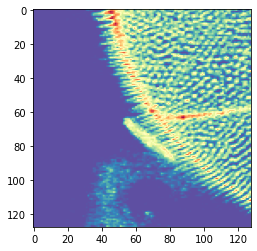

Epoch 47/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00047: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216054902038473, 'val_acc': 0.9946524051421466, 'loss': 0.4815527946009047, 'acc': 1.0, 'lr': 1e-07}


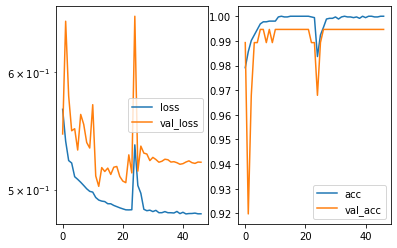

Predicted cell: Landmark Probability: [[0.9999858]]
True Cell type: Landmark
x [[0.49847344]]
True positional value x 0.5
y [[0.57715195]]
True positional value y 0.578125


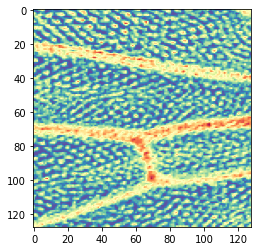

Epoch 48/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9994 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00048: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214467909246843, 'val_acc': 0.9946524051421466, 'loss': 0.4823120617792557, 'acc': 0.999435984073086, 'lr': 1e-07}


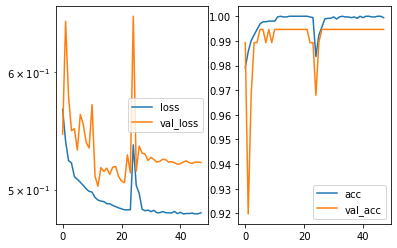

Predicted cell: Landmark Probability: [[0.9999995]]
True Cell type: Landmark
x [[0.57977796]]
True positional value x 0.578125
y [[0.5225277]]
True positional value y 0.5


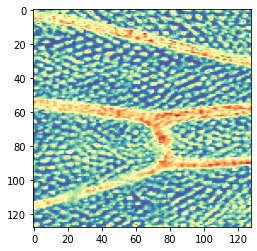

Epoch 49/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00049: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.520360152351665, 'val_acc': 0.9946524051421466, 'loss': 0.48187434286702774, 'acc': 0.999717992036543, 'lr': 1e-07}


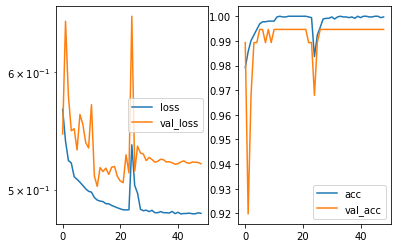

Predicted cell: Background Probability: [[0.9999776]]
True Cell type: Background
x [[0.51006687]]
True positional value x 0.5
y [[0.50814635]]
True positional value y 0.5


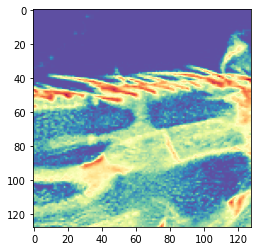

Epoch 50/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00050: ReduceLROnPlateau reducing learning rate to 1.0000000116860975e-08.

Epoch 00050: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213747421369196, 'val_acc': 0.9946524051421466, 'loss': 0.4815843077917524, 'acc': 1.0, 'lr': 1e-07}


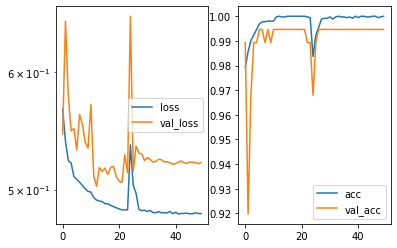

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.48880547]]
True positional value x 0.5
y [[0.52118725]]
True positional value y 0.5


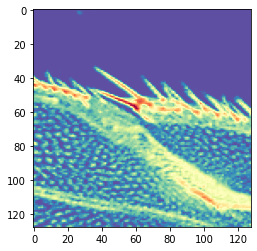

Epoch 51/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4829 - acc: 0.9994 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00051: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5210157720481648, 'val_acc': 0.9946524051421466, 'loss': 0.4829304118783072, 'acc': 0.999435984073086, 'lr': 1e-08}


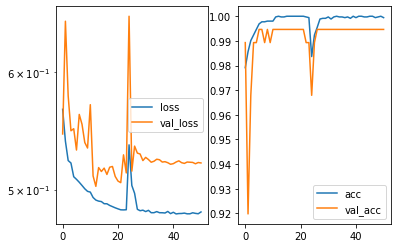

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.4828474]]
True positional value x 0.5
y [[0.4210289]]
True positional value y 0.421875


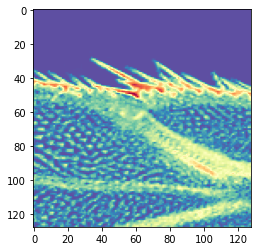

Epoch 52/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00052: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216808293592483, 'val_acc': 0.9946524051421466, 'loss': 0.4818373987450145, 'acc': 0.999717992036543, 'lr': 1e-08}


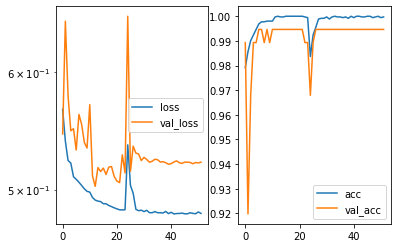

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5260585]]
True positional value x 0.5
y [[0.51284397]]
True positional value y 0.5


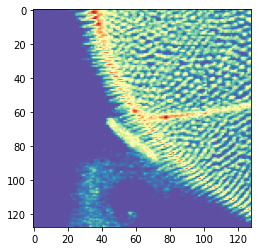

Epoch 53/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4821 - acc: 0.9994 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00053: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217462258542923, 'val_acc': 0.9946524051421466, 'loss': 0.48209453783866313, 'acc': 0.999435984073086, 'lr': 1e-08}


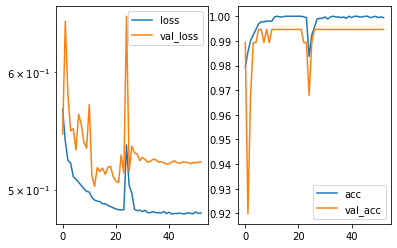

Predicted cell: Background Probability: [[0.97821885]]
True Cell type: Background
x [[0.4666536]]
True positional value x 0.5
y [[0.49239698]]
True positional value y 0.5


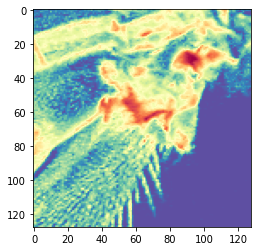

Epoch 54/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00054: ReduceLROnPlateau reducing learning rate to 9.999999939225292e-10.

Epoch 00054: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206869536223896, 'val_acc': 0.9946524051421466, 'loss': 0.4816126861581679, 'acc': 1.0, 'lr': 1e-08}


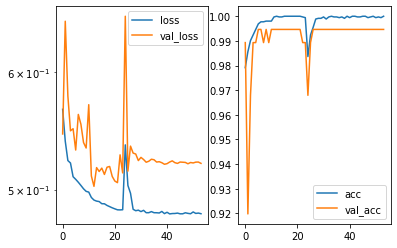

Predicted cell: Landmark Probability: [[0.9998976]]
True Cell type: Landmark
x [[0.58841074]]
True positional value x 0.578125
y [[0.55877686]]
True positional value y 0.578125


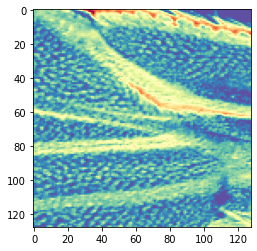

Epoch 55/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4828 - acc: 0.9994 - val_loss: 0.5223 - val_acc: 0.9947

Epoch 00055: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5222533920550729, 'val_acc': 0.9946524051421466, 'loss': 0.48279311111668577, 'acc': 0.999435984073086, 'lr': 1e-09}


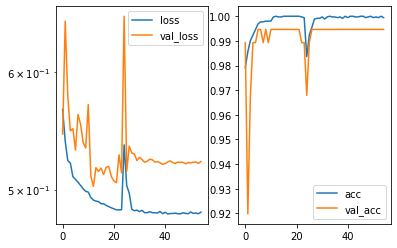

Predicted cell: Landmark Probability: [[0.99938536]]
True Cell type: Landmark
x [[0.5881785]]
True positional value x 0.578125
y [[0.5796366]]
True positional value y 0.578125


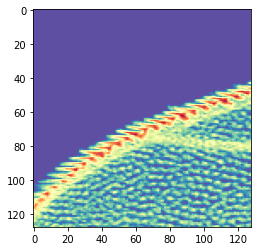

Epoch 56/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5230 - val_acc: 0.9947

Epoch 00056: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5230179848199222, 'val_acc': 0.9946524051421466, 'loss': 0.48152086503480157, 'acc': 1.0, 'lr': 1e-09}


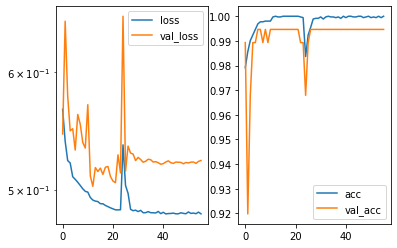

Predicted cell: Landmark Probability: [[0.9996178]]
True Cell type: Landmark
x [[0.44852075]]
True positional value x 0.421875
y [[0.58205336]]
True positional value y 0.578125


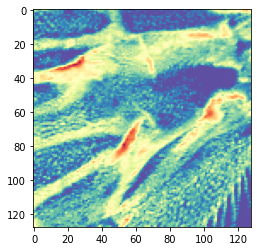

Epoch 57/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00057: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209403044399731, 'val_acc': 0.9946524051421466, 'loss': 0.4814536806828412, 'acc': 1.0, 'lr': 1e-09}


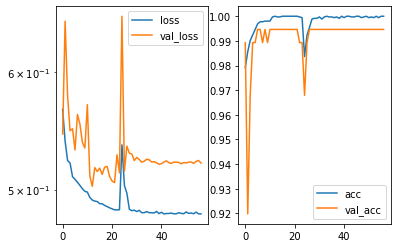

Predicted cell: Landmark Probability: [[0.9995771]]
True Cell type: Landmark
x [[0.44838476]]
True positional value x 0.421875
y [[0.5810865]]
True positional value y 0.578125


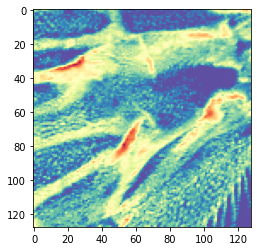

Epoch 58/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00058: ReduceLROnPlateau reducing learning rate to 9.999999717180686e-11.

Epoch 00058: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5208568136322307, 'val_acc': 0.9946524051421466, 'loss': 0.48155468272006385, 'acc': 1.0, 'lr': 1e-09}


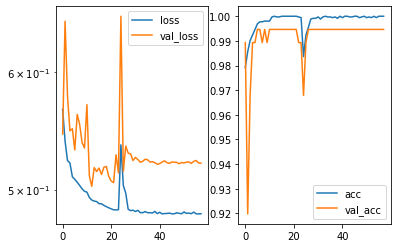

Predicted cell: Landmark Probability: [[0.9999989]]
True Cell type: Landmark
x [[0.56740886]]
True positional value x 0.578125
y [[0.5775228]]
True positional value y 0.578125


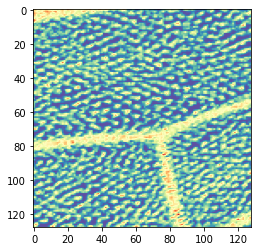

Epoch 59/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00059: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220464584342936, 'val_acc': 0.9946524051421466, 'loss': 0.48151920526564224, 'acc': 0.999717992036543, 'lr': 9.9999994e-11}


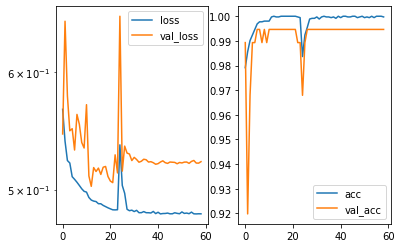

Predicted cell: Landmark Probability: [[0.9999914]]
True Cell type: Landmark
x [[0.41405174]]
True positional value x 0.421875
y [[0.5596142]]
True positional value y 0.578125


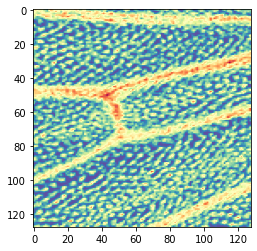

Epoch 60/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00060: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522114130264935, 'val_acc': 0.9946524051421466, 'loss': 0.48189289288808584, 'acc': 0.999717992036543, 'lr': 9.9999994e-11}


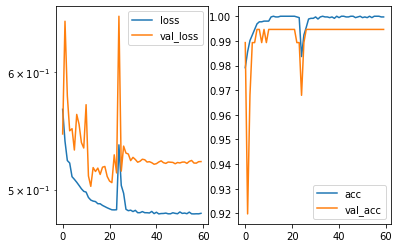

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5741827]]
True positional value x 0.578125
y [[0.48095003]]
True positional value y 0.5


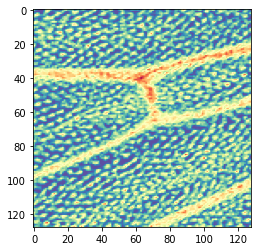

Epoch 61/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4821 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00061: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219907845086592, 'val_acc': 0.9946524051421466, 'loss': 0.48214938939121976, 'acc': 0.999717992036543, 'lr': 9.9999994e-11}


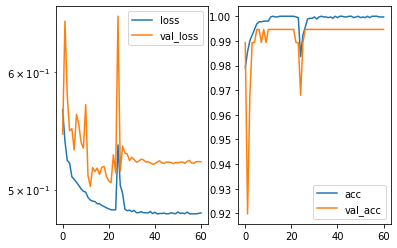

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4804276]]
True positional value x 0.5
y [[0.4243881]]
True positional value y 0.421875


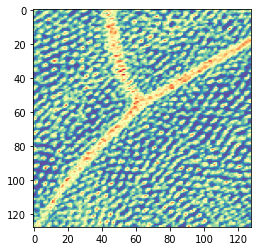

Epoch 62/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00062: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220498366151901, 'val_acc': 0.9946524051421466, 'loss': 0.4813156012283902, 'acc': 1.0, 'lr': 9.9999994e-11}


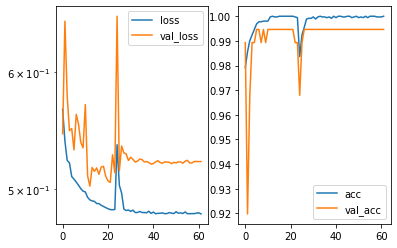

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5016745]]
True positional value x 0.5
y [[0.5037997]]
True positional value y 0.5


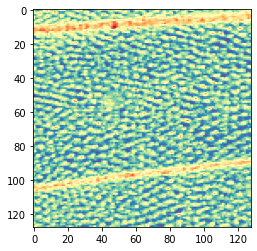

Epoch 63/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00063: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.520764980246039, 'val_acc': 0.9946524051421466, 'loss': 0.4818374072335497, 'acc': 1.0, 'lr': 9.9999994e-11}


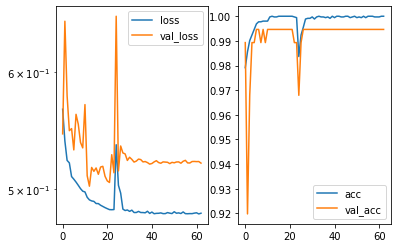

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5041647]]
True positional value x 0.5
y [[0.4865806]]
True positional value y 0.5


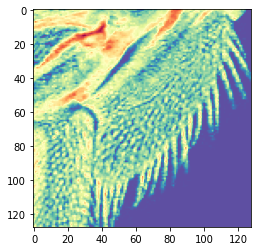

Epoch 64/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00064: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220321789782315, 'val_acc': 0.9946524051421466, 'loss': 0.4817008048682581, 'acc': 1.0, 'lr': 9.9999994e-11}


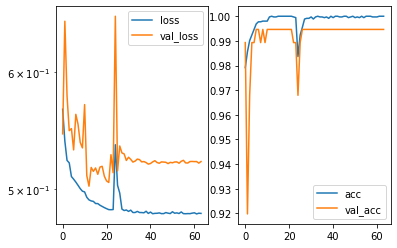

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.51304096]]
True positional value x 0.5
y [[0.5203678]]
True positional value y 0.5


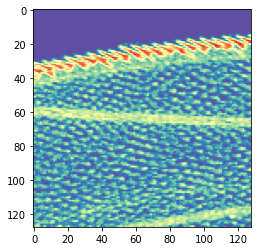

Epoch 65/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9997 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00065: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215352254117874, 'val_acc': 0.9946524051421466, 'loss': 0.48216746823974604, 'acc': 0.999717992036543, 'lr': 9.9999994e-11}


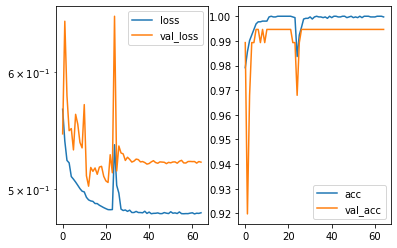

Predicted cell: Background Probability: [[0.99973744]]
True Cell type: Background
x [[0.5341614]]
True positional value x 0.5
y [[0.47829023]]
True positional value y 0.5


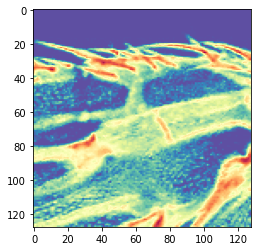

Epoch 66/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00066: ReduceLROnPlateau reducing learning rate to 9.99999943962493e-12.

Epoch 00066: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212254084367803, 'val_acc': 0.9946524051421466, 'loss': 0.48189992457208025, 'acc': 0.999717992036543, 'lr': 9.9999994e-11}


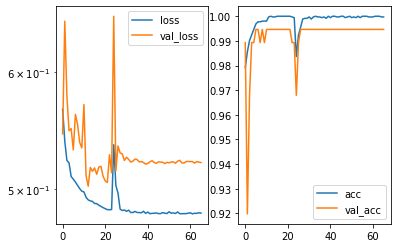

Predicted cell: Landmark Probability: [[0.9999442]]
True Cell type: Landmark
x [[0.47641042]]
True positional value x 0.5
y [[0.42151317]]
True positional value y 0.421875


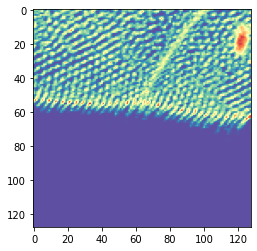

Epoch 67/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9994 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00067: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218499940346907, 'val_acc': 0.9946524051421466, 'loss': 0.4819828714110121, 'acc': 0.999435984073086, 'lr': 9.999999e-12}


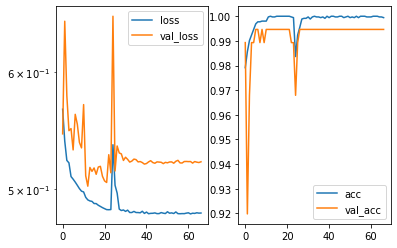

Predicted cell: Landmark Probability: [[0.9999933]]
True Cell type: Landmark
x [[0.5884308]]
True positional value x 0.578125
y [[0.48051688]]
True positional value y 0.5


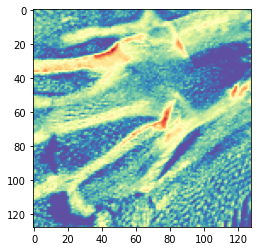

Epoch 68/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5203 - val_acc: 0.9947

Epoch 00068: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5203187256892097, 'val_acc': 0.9946524051421466, 'loss': 0.4819678429217911, 'acc': 0.999717992036543, 'lr': 9.999999e-12}


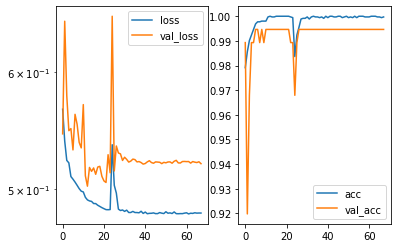

Predicted cell: Background Probability: [[0.9999993]]
True Cell type: Background
x [[0.4839927]]
True positional value x 0.5
y [[0.5078382]]
True positional value y 0.5


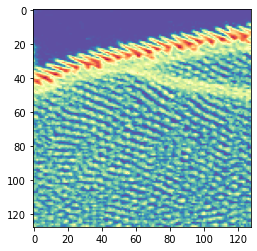

Epoch 69/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00069: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220172053033655, 'val_acc': 0.9946524051421466, 'loss': 0.481545164735722, 'acc': 1.0, 'lr': 9.999999e-12}


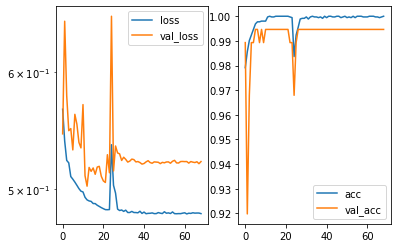

Predicted cell: Landmark Probability: [[0.9994885]]
True Cell type: Landmark
x [[0.4190656]]
True positional value x 0.421875
y [[0.4915187]]
True positional value y 0.5


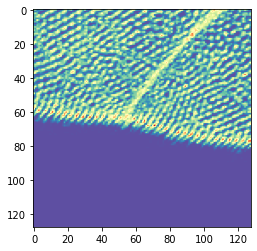

Epoch 70/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00070: ReduceLROnPlateau reducing learning rate to 9.999999092680235e-13.

Epoch 00070: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216504912325405, 'val_acc': 0.9946524051421466, 'loss': 0.4816758904124947, 'acc': 0.999717992036543, 'lr': 9.999999e-12}


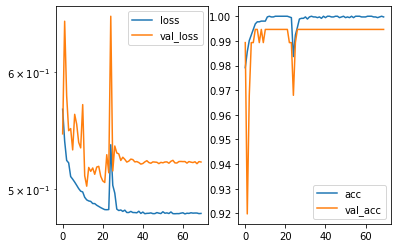

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47446212]]
True positional value x 0.5
y [[0.4869084]]
True positional value y 0.5


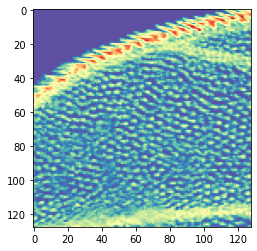

Epoch 71/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5226 - val_acc: 0.9947

Epoch 00071: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5225911691864544, 'val_acc': 0.9946524051421466, 'loss': 0.48141293668908314, 'acc': 1.0, 'lr': 9.999999e-13}


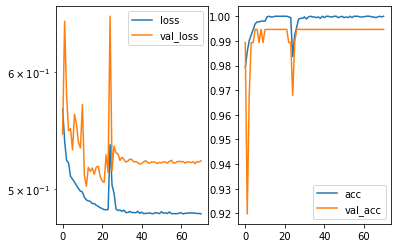

Predicted cell: Background Probability: [[0.99999964]]
True Cell type: Background
x [[0.47626436]]
True positional value x 0.5
y [[0.49456257]]
True positional value y 0.5


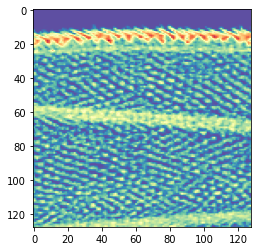

Epoch 72/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00072: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219087745735352, 'val_acc': 0.9946524051421466, 'loss': 0.4818126945359789, 'acc': 0.999717992036543, 'lr': 9.999999e-13}


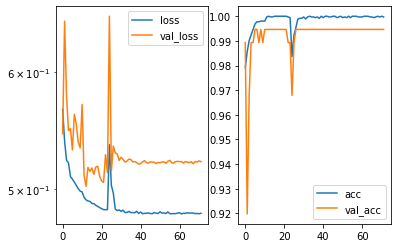

Predicted cell: Landmark Probability: [[0.9999989]]
True Cell type: Landmark
x [[0.5659215]]
True positional value x 0.578125
y [[0.57774276]]
True positional value y 0.578125


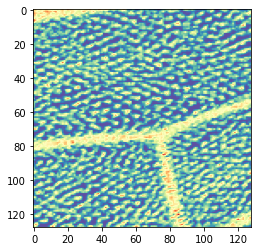

Epoch 73/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00073: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219404133245906, 'val_acc': 0.9946524051421466, 'loss': 0.48170520766132374, 'acc': 0.999717992036543, 'lr': 9.999999e-13}


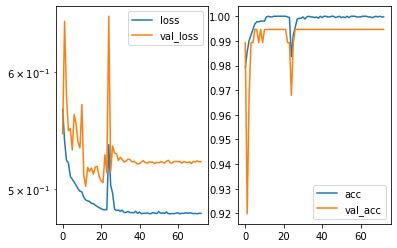

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5516264]]
True positional value x 0.5
y [[0.56573915]]
True positional value y 0.578125


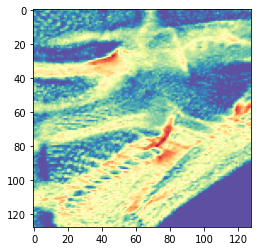

Epoch 74/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 0.9994 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00074: ReduceLROnPlateau reducing learning rate to 9.9999988758398e-14.

Epoch 00074: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209808427701021, 'val_acc': 0.9946524051421466, 'loss': 0.48235178059329437, 'acc': 0.999435984073086, 'lr': 9.999999e-13}


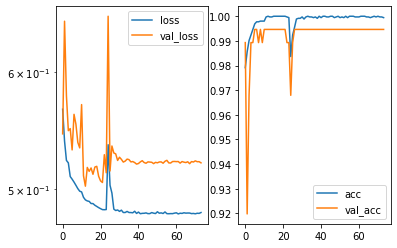

Predicted cell: Background Probability: [[0.9997546]]
True Cell type: Background
x [[0.5076617]]
True positional value x 0.5
y [[0.4946223]]
True positional value y 0.5


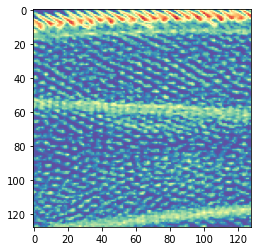

Epoch 75/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00075: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521557819556425, 'val_acc': 0.9946524051421466, 'loss': 0.48185407493454685, 'acc': 0.999717992036543, 'lr': 9.999999e-14}


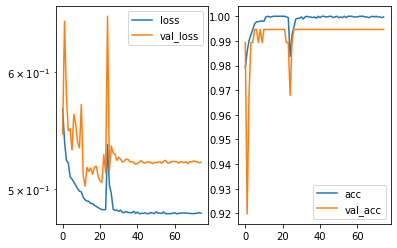

Predicted cell: Landmark Probability: [[0.99999666]]
True Cell type: Landmark
x [[0.40659773]]
True positional value x 0.421875
y [[0.56030273]]
True positional value y 0.578125


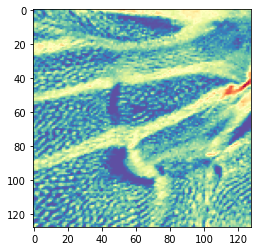

Epoch 76/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5227 - val_acc: 0.9947

Epoch 00076: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5227189121399334, 'val_acc': 0.9946524051421466, 'loss': 0.4816584242008799, 'acc': 1.0, 'lr': 9.999999e-14}


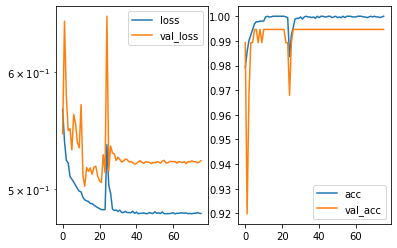

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5068976]]
True positional value x 0.5
y [[0.4826797]]
True positional value y 0.5


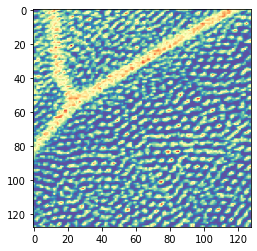

Epoch 77/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00077: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521472902540217, 'val_acc': 0.9946524051421466, 'loss': 0.4814931038605313, 'acc': 1.0, 'lr': 9.999999e-14}


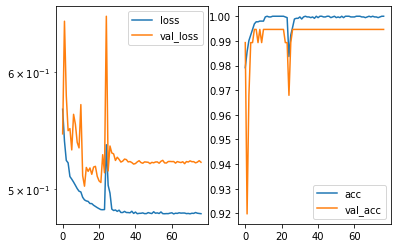

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4902884]]
True positional value x 0.5
y [[0.527348]]
True positional value y 0.578125


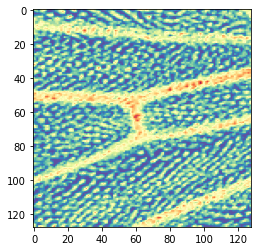

Epoch 78/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9994 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00078: ReduceLROnPlateau reducing learning rate to 9.999999146890344e-15.

Epoch 00078: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214816421110999, 'val_acc': 0.9946524051421466, 'loss': 0.4823183226538323, 'acc': 0.999435984073086, 'lr': 9.999999e-14}


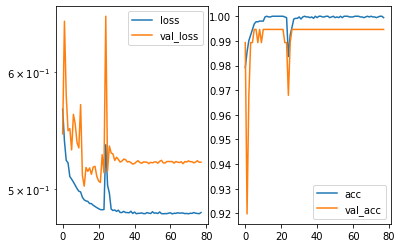

Predicted cell: Background Probability: [[0.9999924]]
True Cell type: Background
x [[0.54708904]]
True positional value x 0.5
y [[0.4829548]]
True positional value y 0.5


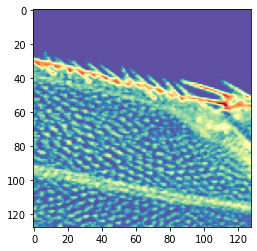

Epoch 79/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00079: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215059216009742, 'val_acc': 0.9946524051421466, 'loss': 0.4817737533053771, 'acc': 1.0, 'lr': 9.999999e-15}


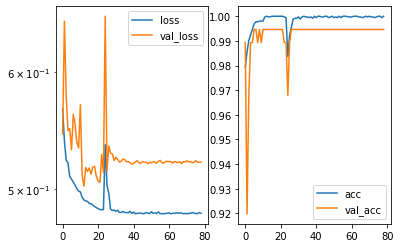

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5039843]]
True positional value x 0.5
y [[0.41092452]]
True positional value y 0.421875


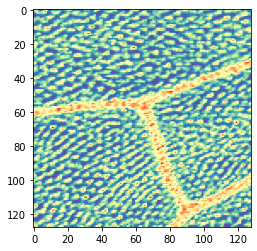

Epoch 80/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9997 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00080: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212188380606034, 'val_acc': 0.9946524051421466, 'loss': 0.482162522516611, 'acc': 0.999717992036543, 'lr': 9.999999e-15}


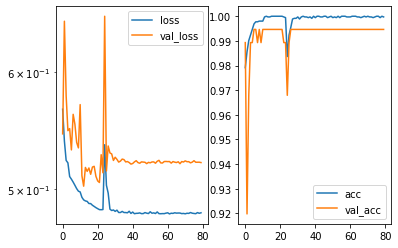

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48066565]]
True positional value x 0.5
y [[0.4369714]]
True positional value y 0.421875


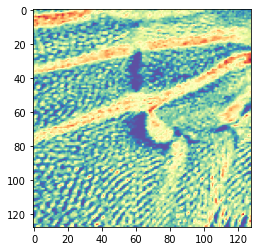

Epoch 81/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9992 - val_loss: 0.5213 - val_acc: 0.9947

Epoch 00081: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212680955621648, 'val_acc': 0.9946524051421466, 'loss': 0.48216345237260205, 'acc': 0.999153976109629, 'lr': 9.999999e-15}


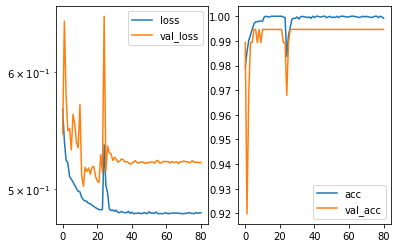

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5173046]]
True positional value x 0.5
y [[0.4945664]]
True positional value y 0.5


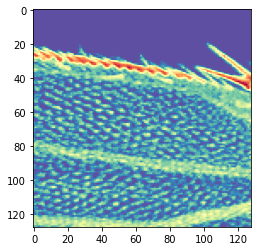

Epoch 82/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00082: ReduceLROnPlateau reducing learning rate to 9.999998977483753e-16.

Epoch 00082: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214065797826185, 'val_acc': 0.9946524051421466, 'loss': 0.48170720051724025, 'acc': 1.0, 'lr': 9.999999e-15}


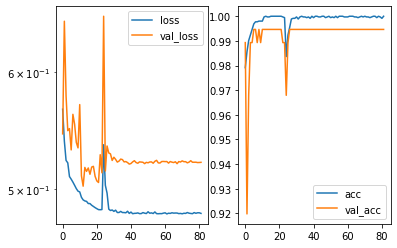

Predicted cell: Background Probability: [[0.99792886]]
True Cell type: Background
x [[0.47664267]]
True positional value x 0.5
y [[0.5008753]]
True positional value y 0.5


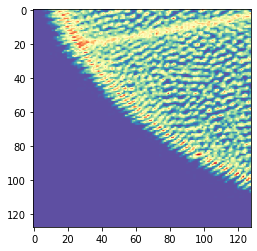

Epoch 83/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00083: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521556728663929, 'val_acc': 0.9946524051421466, 'loss': 0.48181474716462996, 'acc': 1.0, 'lr': 9.999999e-16}


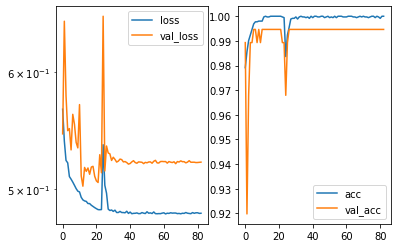

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.41082796]]
True positional value x 0.421875
y [[0.48656127]]
True positional value y 0.5


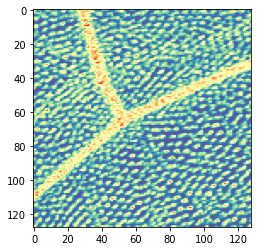

Epoch 84/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00084: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220009394507995, 'val_acc': 0.9946524051421466, 'loss': 0.4816134462602651, 'acc': 0.999717992036543, 'lr': 9.999999e-16}


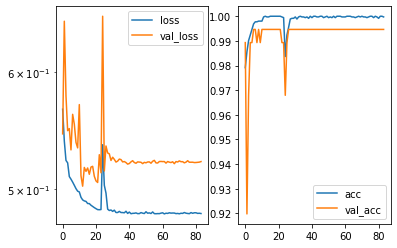

Predicted cell: Landmark Probability: [[0.99999785]]
True Cell type: Landmark
x [[0.41576535]]
True positional value x 0.421875
y [[0.5797492]]
True positional value y 0.578125


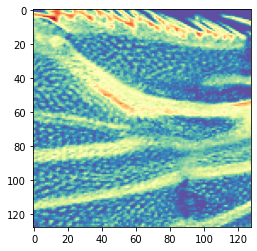

Epoch 85/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5225 - val_acc: 0.9947

Epoch 00085: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5224540235205768, 'val_acc': 0.9946524051421466, 'loss': 0.48164042501011206, 'acc': 1.0, 'lr': 9.999999e-16}


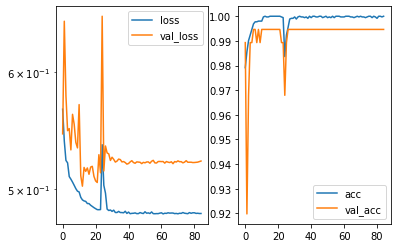

Predicted cell: Landmark Probability: [[0.99989915]]
True Cell type: Landmark
x [[0.57721865]]
True positional value x 0.578125
y [[0.49680617]]
True positional value y 0.5


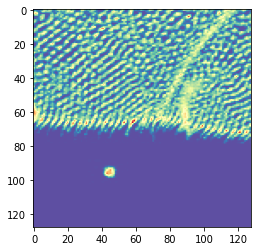

Epoch 86/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00086: ReduceLROnPlateau reducing learning rate to 9.999998977483754e-17.

Epoch 00086: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214293554504925, 'val_acc': 0.9946524051421466, 'loss': 0.4815748573122761, 'acc': 1.0, 'lr': 9.999999e-16}


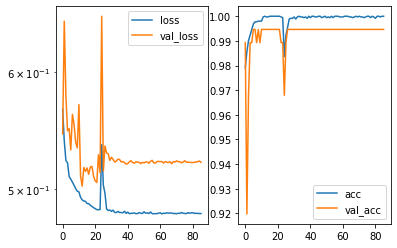

Predicted cell: Landmark Probability: [[0.9999901]]
True Cell type: Landmark
x [[0.43406487]]
True positional value x 0.421875
y [[0.4172877]]
True positional value y 0.421875


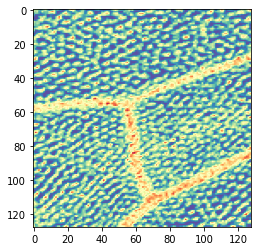

Epoch 87/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 0.9994 - val_loss: 0.5239 - val_acc: 0.9947

Epoch 00087: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5238994602213569, 'val_acc': 0.9946524051421466, 'loss': 0.4823891464358188, 'acc': 0.999435984073086, 'lr': 9.999999e-17}


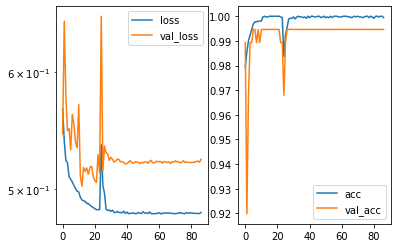

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.4105942]]
True positional value x 0.421875
y [[0.48969704]]
True positional value y 0.5


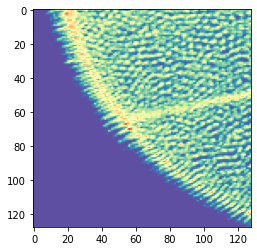

Epoch 88/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00088: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215014687833939, 'val_acc': 0.9946524051421466, 'loss': 0.481505506400395, 'acc': 1.0, 'lr': 9.999999e-17}


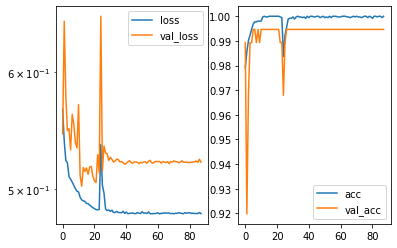

Predicted cell: Background Probability: [[0.99986124]]
True Cell type: Background
x [[0.5086149]]
True positional value x 0.5
y [[0.52131486]]
True positional value y 0.5


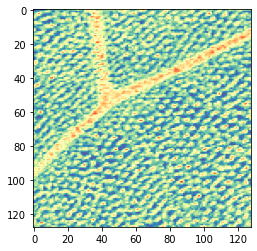

Epoch 89/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5195 - val_acc: 0.9947

Epoch 00089: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5194593361992249, 'val_acc': 0.9946524051421466, 'loss': 0.48146681224499727, 'acc': 1.0, 'lr': 9.999999e-17}


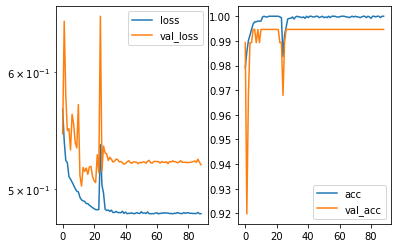

Predicted cell: Landmark Probability: [[0.999997]]
True Cell type: Landmark
x [[0.4072752]]
True positional value x 0.421875
y [[0.5625963]]
True positional value y 0.578125


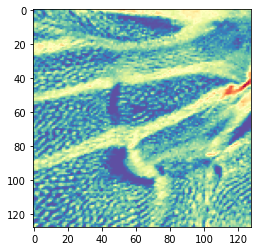

Epoch 90/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5234 - val_acc: 0.9947

Epoch 00090: ReduceLROnPlateau reducing learning rate to 9.999998845134856e-18.

Epoch 00090: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5234373729815458, 'val_acc': 0.9946524051421466, 'loss': 0.4815142518271851, 'acc': 1.0, 'lr': 9.999999e-17}


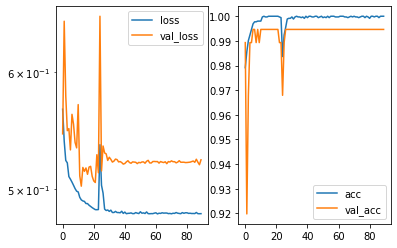

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4184341]]
True positional value x 0.421875
y [[0.4830418]]
True positional value y 0.5


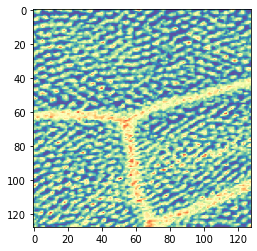

Epoch 91/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5224 - val_acc: 0.9947

Epoch 00091: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5224462314085527, 'val_acc': 0.9946524051421466, 'loss': 0.48163267423793277, 'acc': 1.0, 'lr': 9.999999e-18}


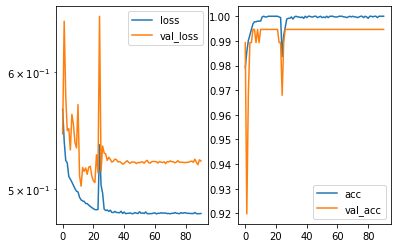

Predicted cell: Background Probability: [[0.9988427]]
True Cell type: Background
x [[0.46187007]]
True positional value x 0.5
y [[0.4934399]]
True positional value y 0.5


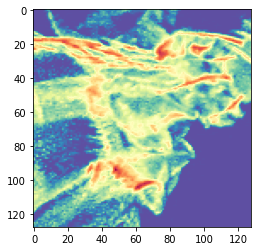

Epoch 92/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00092: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214880746316145, 'val_acc': 0.9946524051421466, 'loss': 0.48147210035025567, 'acc': 1.0, 'lr': 9.999999e-18}


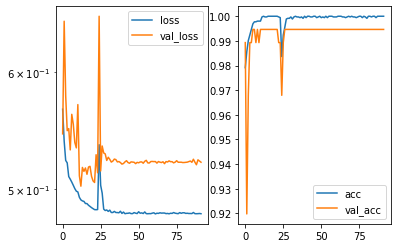

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4722323]]
True positional value x 0.5
y [[0.4530213]]
True positional value y 0.5


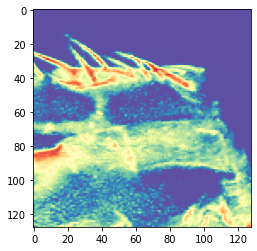

Epoch 93/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00093: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521569142367113, 'val_acc': 0.9946524051421466, 'loss': 0.48160405684781493, 'acc': 0.999717992036543, 'lr': 9.999999e-18}


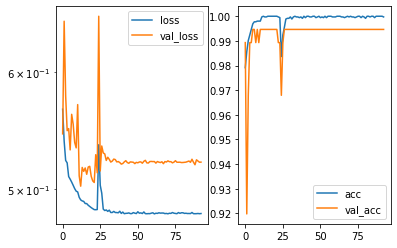

Predicted cell: Background Probability: [[0.9971413]]
True Cell type: Background
x [[0.491579]]
True positional value x 0.5
y [[0.49945116]]
True positional value y 0.5


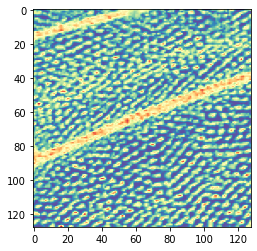

Epoch 94/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00094: ReduceLROnPlateau reducing learning rate to 9.999999010570977e-19.

Epoch 00094: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5211683027247057, 'val_acc': 0.9946524051421466, 'loss': 0.4814872601680411, 'acc': 1.0, 'lr': 9.999999e-18}


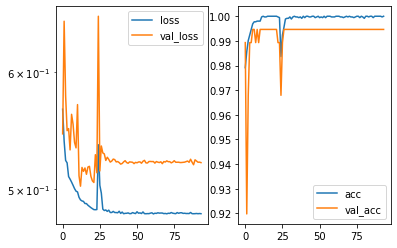

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4903472]]
True positional value x 0.5
y [[0.5268825]]
True positional value y 0.578125


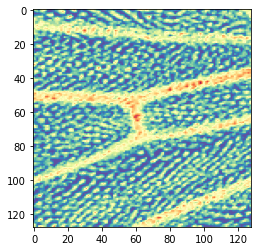

Epoch 95/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00095: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220228792193101, 'val_acc': 0.9946524051421466, 'loss': 0.48175589051948586, 'acc': 0.999717992036543, 'lr': 9.999999e-19}


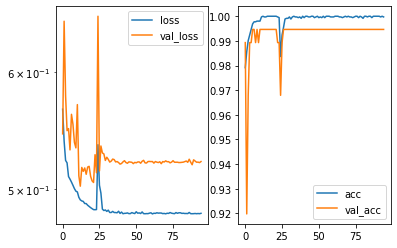

Predicted cell: Landmark Probability: [[0.9999746]]
True Cell type: Landmark
x [[0.50588775]]
True positional value x 0.5
y [[0.517211]]
True positional value y 0.5


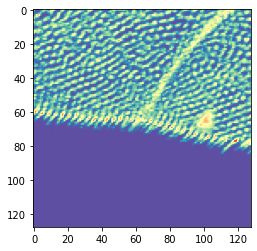

Epoch 96/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00096: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209935066852978, 'val_acc': 0.9946524051421466, 'loss': 0.4818029665570439, 'acc': 1.0, 'lr': 9.999999e-19}


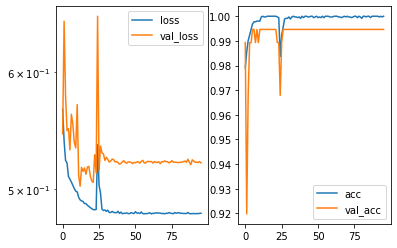

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5108263]]
True positional value x 0.5
y [[0.43042713]]
True positional value y 0.421875


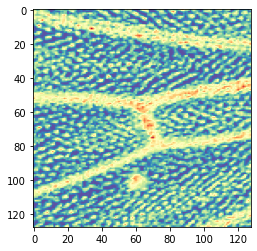

Epoch 97/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5198 - val_acc: 0.9947

Epoch 00097: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5198346398730966, 'val_acc': 0.9946524051421466, 'loss': 0.48178267122592483, 'acc': 0.999717992036543, 'lr': 9.999999e-19}


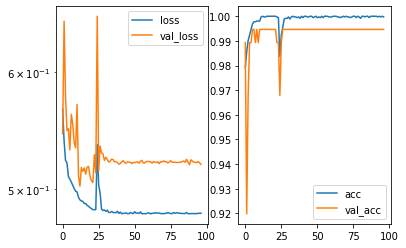

Predicted cell: Landmark Probability: [[0.9999038]]
True Cell type: Landmark
x [[0.5765993]]
True positional value x 0.578125
y [[0.4953544]]
True positional value y 0.5


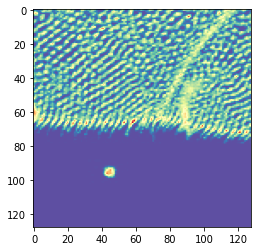

Epoch 98/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4812 - acc: 1.0000 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00098: ReduceLROnPlateau reducing learning rate to 9.999999424161285e-20.

Epoch 00098: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.520553635562805, 'val_acc': 0.9946524051421466, 'loss': 0.4812365914897198, 'acc': 1.0, 'lr': 9.999999e-19}


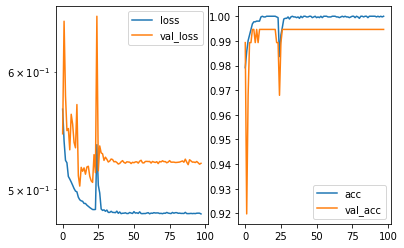

Predicted cell: Landmark Probability: [[0.9999778]]
True Cell type: Landmark
x [[0.5223727]]
True positional value x 0.5
y [[0.50329804]]
True positional value y 0.5


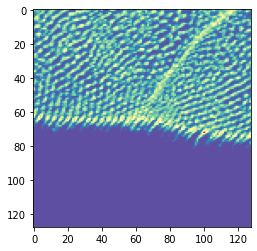

Epoch 99/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5229 - val_acc: 0.9947

Epoch 00099: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5229499574332314, 'val_acc': 0.9946524051421466, 'loss': 0.48187535569214646, 'acc': 0.999717992036543, 'lr': 1e-19}


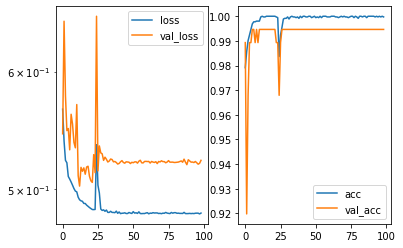

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.47638872]]
True positional value x 0.5
y [[0.5675883]]
True positional value y 0.578125


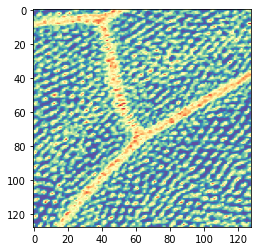

Epoch 100/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00100: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522125573241137, 'val_acc': 0.9946524051421466, 'loss': 0.48167480606516405, 'acc': 1.0, 'lr': 1e-19}


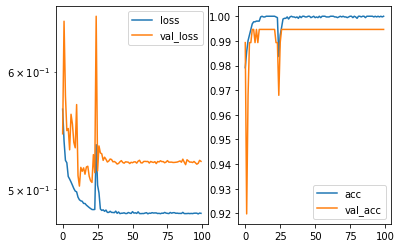

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48189986]]
True positional value x 0.5
y [[0.42425233]]
True positional value y 0.421875


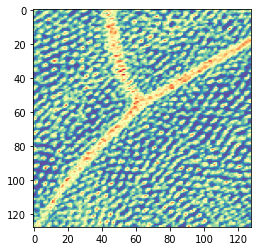

Epoch 101/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00101: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204222991186029, 'val_acc': 0.9946524051421466, 'loss': 0.48136419079697745, 'acc': 1.0, 'lr': 1e-19}


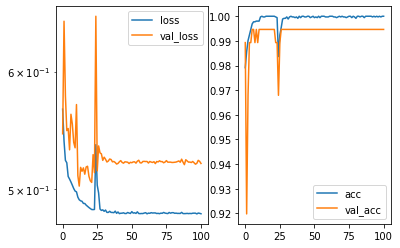

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47447908]]
True positional value x 0.5
y [[0.4872101]]
True positional value y 0.5


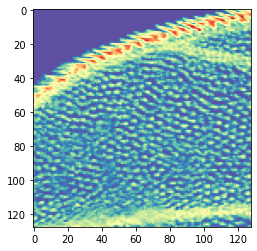

Epoch 102/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00102: ReduceLROnPlateau reducing learning rate to 9.999999682655225e-21.

Epoch 00102: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209080089222301, 'val_acc': 0.9946524051421466, 'loss': 0.4815440844897826, 'acc': 1.0, 'lr': 1e-19}


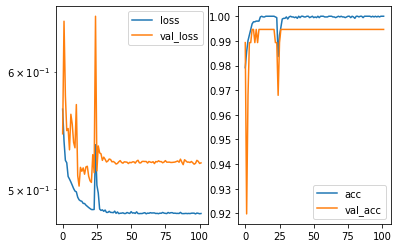

Predicted cell: Landmark Probability: [[0.9999858]]
True Cell type: Landmark
x [[0.60644436]]
True positional value x 0.578125
y [[0.5643538]]
True positional value y 0.578125


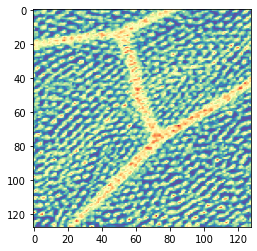

Epoch 103/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00103: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5205607999136104, 'val_acc': 0.9946524051421466, 'loss': 0.4815809377760653, 'acc': 0.999717992036543, 'lr': 1e-20}


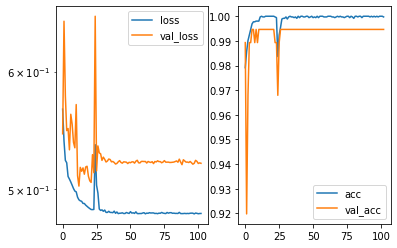

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5716165]]
True positional value x 0.578125
y [[0.58023345]]
True positional value y 0.578125


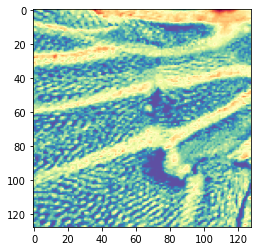

Epoch 104/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00104: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214550130188784, 'val_acc': 0.9946524051421466, 'loss': 0.481662570791465, 'acc': 1.0, 'lr': 1e-20}


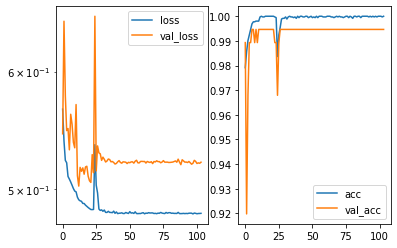

Predicted cell: Background Probability: [[0.9999999]]
True Cell type: Background
x [[0.48677945]]
True positional value x 0.5
y [[0.5146131]]
True positional value y 0.5


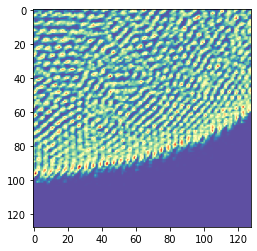

Epoch 105/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5224 - val_acc: 0.9947

Epoch 00105: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5224173223589831, 'val_acc': 0.9946524051421466, 'loss': 0.48135321290225414, 'acc': 1.0, 'lr': 1e-20}


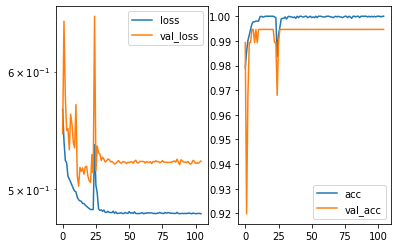

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5209706]]
True positional value x 0.5
y [[0.52417815]]
True positional value y 0.5


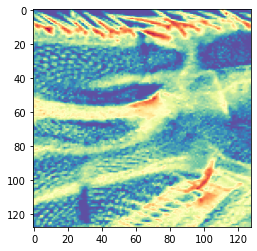

Epoch 106/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00106: ReduceLROnPlateau reducing learning rate to 9.999999682655225e-22.

Epoch 00106: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5208845527414332, 'val_acc': 0.9946524051421466, 'loss': 0.48171936877353405, 'acc': 0.999717992036543, 'lr': 1e-20}


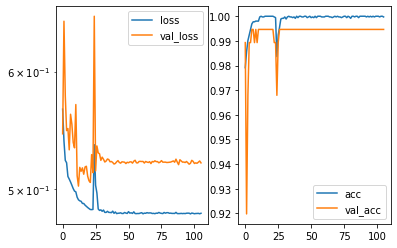

Predicted cell: Background Probability: [[0.99999964]]
True Cell type: Background
x [[0.4977627]]
True positional value x 0.5
y [[0.5045526]]
True positional value y 0.5


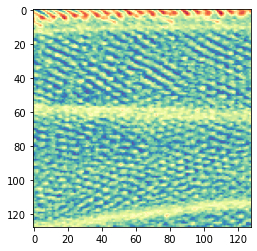

Epoch 107/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00107: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521674349824375, 'val_acc': 0.9946524051421466, 'loss': 0.48163881711346646, 'acc': 1.0, 'lr': 1e-21}


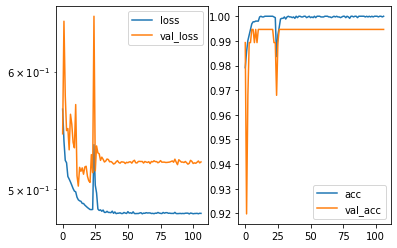

Predicted cell: Background Probability: [[0.999998]]
True Cell type: Background
x [[0.48572078]]
True positional value x 0.5
y [[0.50824106]]
True positional value y 0.5


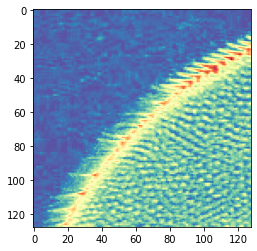

Epoch 108/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00108: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216242414426039, 'val_acc': 0.9946524051421466, 'loss': 0.48191167922660044, 'acc': 1.0, 'lr': 1e-21}


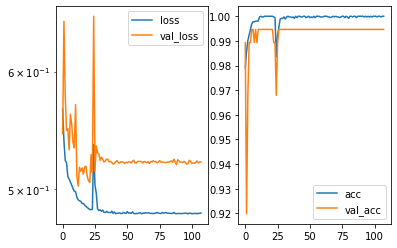

Predicted cell: Landmark Probability: [[0.99987733]]
True Cell type: Landmark
x [[0.40760672]]
True positional value x 0.421875
y [[0.49647015]]
True positional value y 0.5


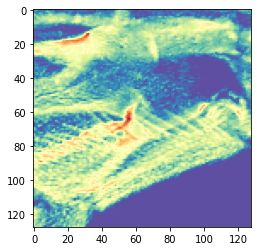

Epoch 109/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00109: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5221889395127322, 'val_acc': 0.9946524051421466, 'loss': 0.4817354801645134, 'acc': 1.0, 'lr': 1e-21}


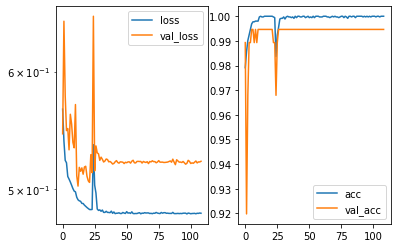

Predicted cell: Landmark Probability: [[0.9999442]]
True Cell type: Landmark
x [[0.47700238]]
True positional value x 0.5
y [[0.42155546]]
True positional value y 0.421875


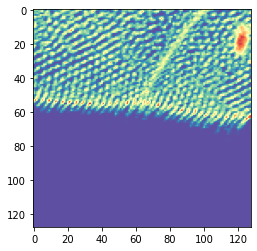

Epoch 110/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00110: ReduceLROnPlateau reducing learning rate to 9.999999682655225e-23.

Epoch 00110: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212391071459826, 'val_acc': 0.9946524051421466, 'loss': 0.4815422887023532, 'acc': 1.0, 'lr': 1e-21}


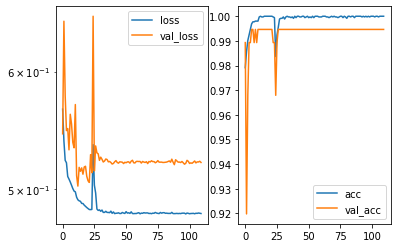

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49809527]]
True positional value x 0.5
y [[0.5837829]]
True positional value y 0.578125


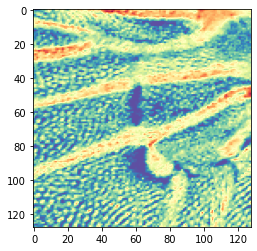

Epoch 111/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5223 - val_acc: 0.9947

Epoch 00111: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522309656608551, 'val_acc': 0.9946524051421466, 'loss': 0.48146713146434555, 'acc': 1.0, 'lr': 9.9999997e-23}


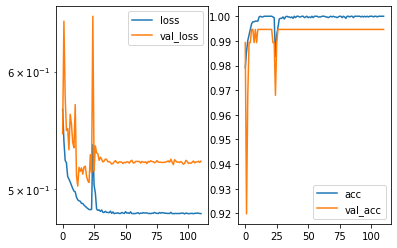

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5303423]]
True positional value x 0.578125
y [[0.5106495]]
True positional value y 0.5


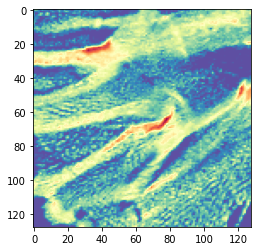

Epoch 112/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 1.0000 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00112: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216950138303685, 'val_acc': 0.9946524051421466, 'loss': 0.48186719930245925, 'acc': 1.0, 'lr': 9.9999997e-23}


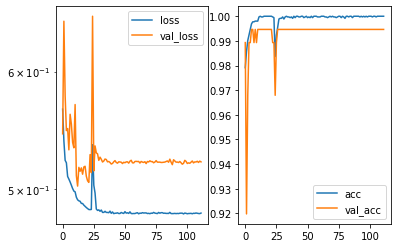

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.4171735]]
True positional value x 0.421875
y [[0.5152009]]
True positional value y 0.5


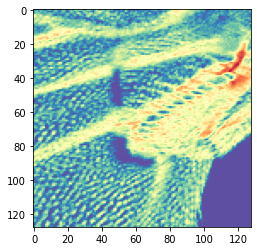

Epoch 113/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00113: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219189695177231, 'val_acc': 0.9946524051421466, 'loss': 0.48133137887706207, 'acc': 1.0, 'lr': 9.9999997e-23}


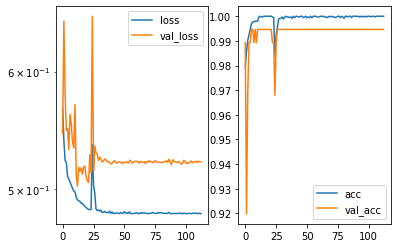

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.510352]]
True positional value x 0.5
y [[0.40902194]]
True positional value y 0.421875


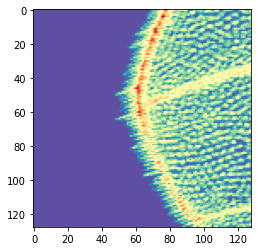

Epoch 114/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00114: ReduceLROnPlateau reducing learning rate to 9.999999682655227e-24.

Epoch 00114: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521965847455244, 'val_acc': 0.9946524051421466, 'loss': 0.4815951479536897, 'acc': 0.999717992036543, 'lr': 9.9999997e-23}


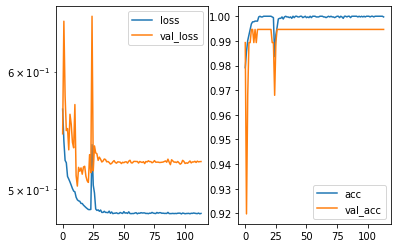

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.57078886]]
True positional value x 0.578125
y [[0.3889002]]
True positional value y 0.421875


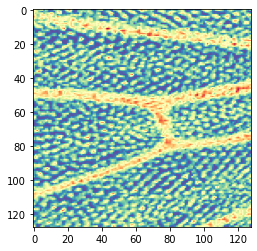

Epoch 115/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5225 - val_acc: 0.9947

Epoch 00115: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5224804279001002, 'val_acc': 0.9946524051421466, 'loss': 0.48184508660117986, 'acc': 0.999717992036543, 'lr': 1e-23}


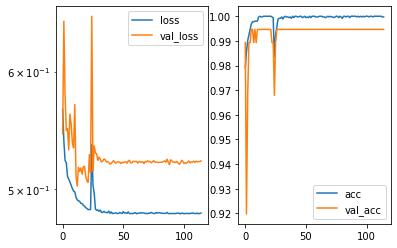

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5097285]]
True positional value x 0.5
y [[0.4999861]]
True positional value y 0.5


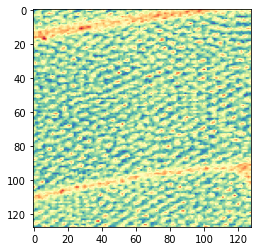

Epoch 116/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4830 - acc: 0.9997 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00116: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5221867242598917, 'val_acc': 0.9946524051421466, 'loss': 0.48298139442378224, 'acc': 0.999717992036543, 'lr': 1e-23}


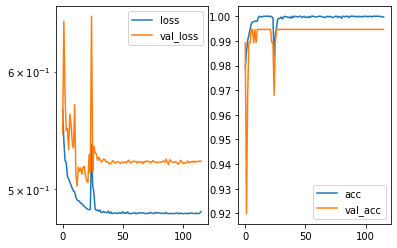

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49004316]]
True positional value x 0.5
y [[0.4944659]]
True positional value y 0.5


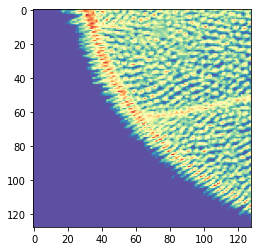

Epoch 117/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00117: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219371263037391, 'val_acc': 0.9946524051421466, 'loss': 0.48167112899983056, 'acc': 1.0, 'lr': 1e-23}


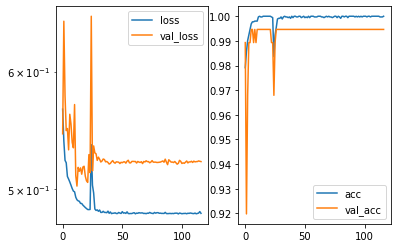

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.40870953]]
True positional value x 0.421875
y [[0.48884228]]
True positional value y 0.5


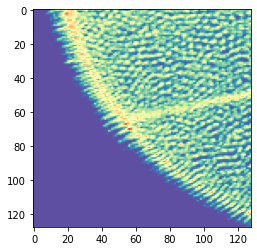

Epoch 118/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9994 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00118: ReduceLROnPlateau reducing learning rate to 9.999999998199588e-25.

Epoch 00118: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5203675532086011, 'val_acc': 0.9946524051421466, 'loss': 0.48195929760591366, 'acc': 0.999435984073086, 'lr': 1e-23}


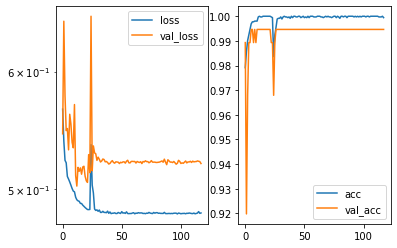

Predicted cell: Background Probability: [[0.9999989]]
True Cell type: Background
x [[0.4836095]]
True positional value x 0.5
y [[0.51768976]]
True positional value y 0.5


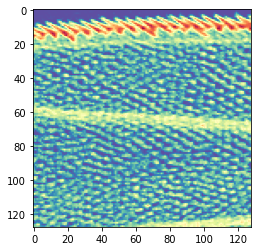

Epoch 119/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00119: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521711742814212, 'val_acc': 0.9946524051421466, 'loss': 0.4817995348523985, 'acc': 0.999717992036543, 'lr': 1e-24}


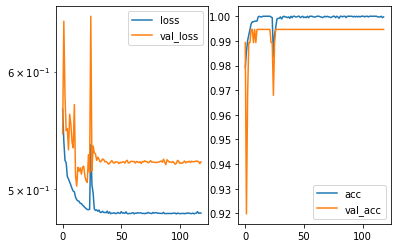

Predicted cell: Landmark Probability: [[0.9999654]]
True Cell type: Landmark
x [[0.42982563]]
True positional value x 0.421875
y [[0.5836868]]
True positional value y 0.578125


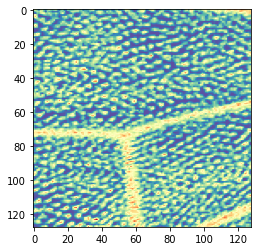

Epoch 120/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9994 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00120: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220949405973608, 'val_acc': 0.9946524051421466, 'loss': 0.48184544301880194, 'acc': 0.999435984073086, 'lr': 1e-24}


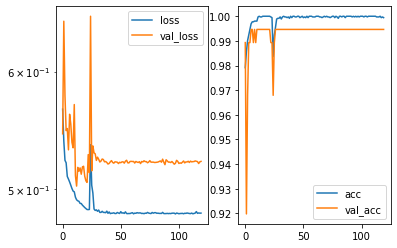

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4935992]]
True positional value x 0.5
y [[0.507864]]
True positional value y 0.5


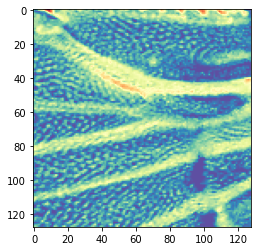

Epoch 121/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00121: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.52186152195548, 'val_acc': 0.9946524051421466, 'loss': 0.48131208211704624, 'acc': 1.0, 'lr': 1e-24}


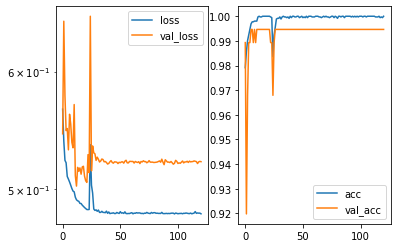

Predicted cell: Background Probability: [[0.999742]]
True Cell type: Background
x [[0.53316027]]
True positional value x 0.5
y [[0.4777903]]
True positional value y 0.5


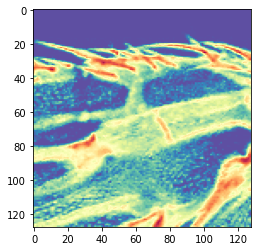

Epoch 122/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5228 - val_acc: 0.9947

Epoch 00122: ReduceLROnPlateau reducing learning rate to 1.0000000195414814e-25.

Epoch 00122: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5228334591987936, 'val_acc': 0.9946524051421466, 'loss': 0.48160572937499047, 'acc': 1.0, 'lr': 1e-24}


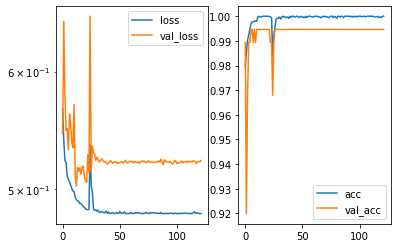

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4797621]]
True positional value x 0.5
y [[0.51970756]]
True positional value y 0.5


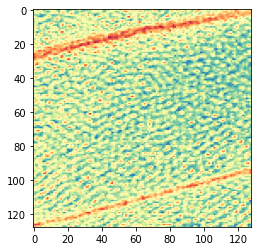

Epoch 123/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5205 - val_acc: 0.9947

Epoch 00123: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204768867734919, 'val_acc': 0.9946524051421466, 'loss': 0.4819966100463071, 'acc': 0.999717992036543, 'lr': 1e-25}


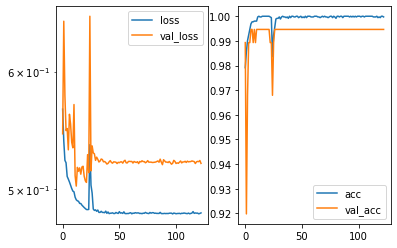

Predicted cell: Landmark Probability: [[0.9999913]]
True Cell type: Landmark
x [[0.4313483]]
True positional value x 0.421875
y [[0.46372253]]
True positional value y 0.421875


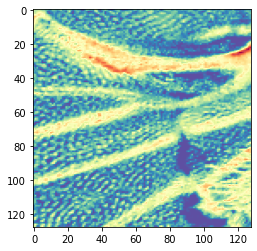

Epoch 124/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5223 - val_acc: 0.9947

Epoch 00124: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5222837893083134, 'val_acc': 0.9946524051421466, 'loss': 0.48170453765536186, 'acc': 0.999717992036543, 'lr': 1e-25}


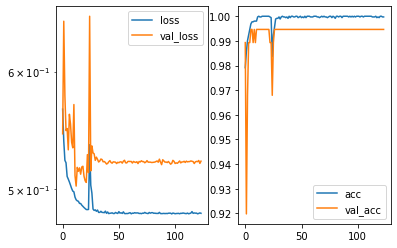

Predicted cell: Background Probability: [[0.9991573]]
True Cell type: Background
x [[0.51966536]]
True positional value x 0.5
y [[0.5082085]]
True positional value y 0.5


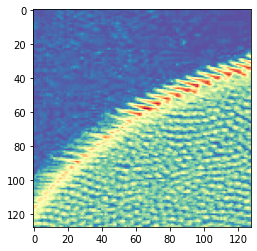

Epoch 125/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5229 - val_acc: 0.9947

Epoch 00125: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5229449042661942, 'val_acc': 0.9946524051421466, 'loss': 0.4813317426233996, 'acc': 1.0, 'lr': 1e-25}


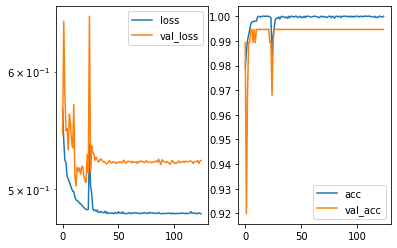

Predicted cell: Landmark Probability: [[0.99995065]]
True Cell type: Landmark
x [[0.47734576]]
True positional value x 0.5
y [[0.42205694]]
True positional value y 0.421875


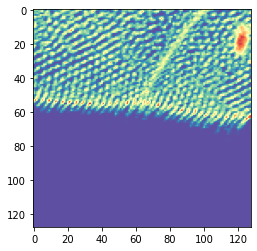

Epoch 126/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00126: ReduceLROnPlateau reducing learning rate to 1.0000000195414814e-26.

Epoch 00126: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220704292231065, 'val_acc': 0.9946524051421466, 'loss': 0.48176665784811074, 'acc': 0.999717992036543, 'lr': 1e-25}


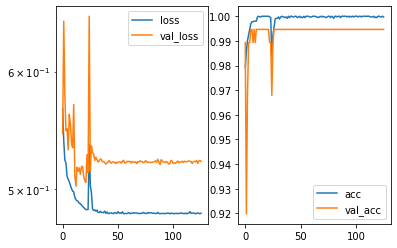

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.47935894]]
True positional value x 0.5
y [[0.49990562]]
True positional value y 0.5


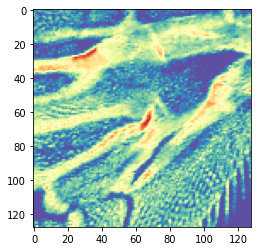

Epoch 127/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4821 - acc: 0.9997 - val_loss: 0.5225 - val_acc: 0.9947

Epoch 00127: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522518529770846, 'val_acc': 0.9946524051421466, 'loss': 0.482060146563751, 'acc': 0.999717992036543, 'lr': 1e-26}


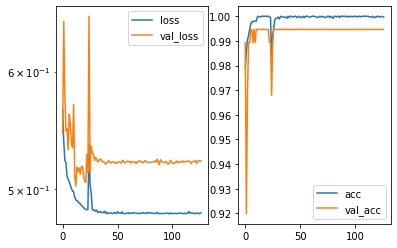

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5006065]]
True positional value x 0.5
y [[0.47323206]]
True positional value y 0.5


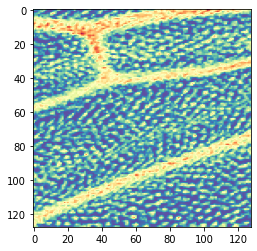

Epoch 128/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00128: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209561936995563, 'val_acc': 0.9946524051421466, 'loss': 0.48157514997343526, 'acc': 1.0, 'lr': 1e-26}


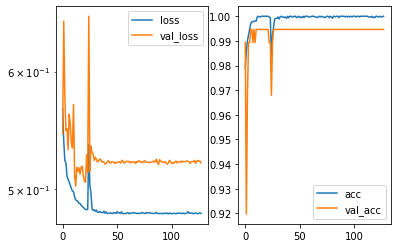

Predicted cell: Background Probability: [[0.99977213]]
True Cell type: Background
x [[0.5335578]]
True positional value x 0.5
y [[0.47769848]]
True positional value y 0.5


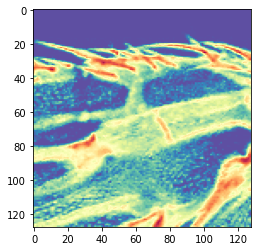

Epoch 129/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00129: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5207402578649674, 'val_acc': 0.9946524051421466, 'loss': 0.481428713530924, 'acc': 1.0, 'lr': 1e-26}


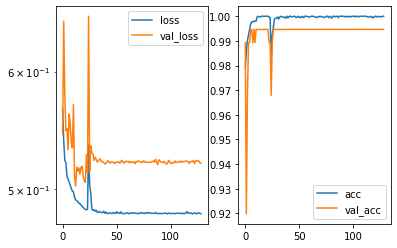

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5136974]]
True positional value x 0.5
y [[0.50313824]]
True positional value y 0.5


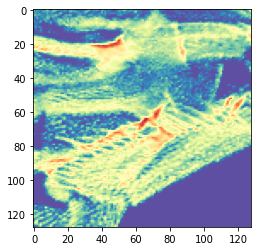

Epoch 130/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00130: ReduceLROnPlateau reducing learning rate to 9.999999887266024e-28.

Epoch 00130: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206972709632812, 'val_acc': 0.9946524051421466, 'loss': 0.48162544592248474, 'acc': 0.999717992036543, 'lr': 1e-26}


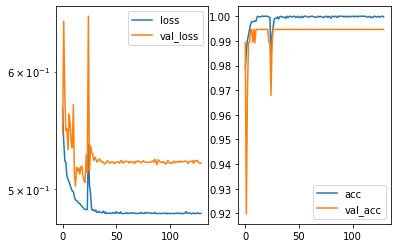

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.50691366]]
True positional value x 0.5
y [[0.4831853]]
True positional value y 0.5


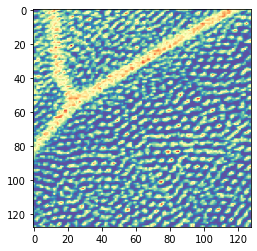

Epoch 131/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00131: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217101660004274, 'val_acc': 0.9946524051421466, 'loss': 0.48161874740929234, 'acc': 0.999717992036543, 'lr': 1e-27}


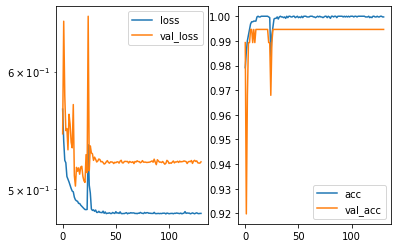

Predicted cell: Landmark Probability: [[0.9999908]]
True Cell type: Landmark
x [[0.5883286]]
True positional value x 0.578125
y [[0.57678497]]
True positional value y 0.578125


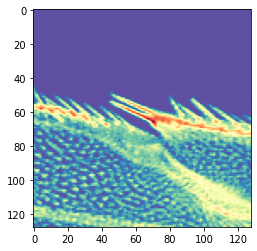

Epoch 132/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00132: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214382626793601, 'val_acc': 0.9946524051421466, 'loss': 0.48160863087396466, 'acc': 1.0, 'lr': 1e-27}


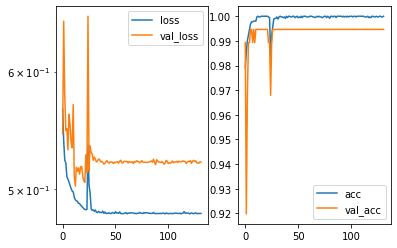

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.49038213]]
True positional value x 0.5
y [[0.49987116]]
True positional value y 0.5


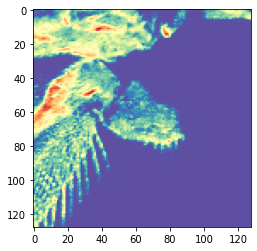

Epoch 133/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5200 - val_acc: 0.9947

Epoch 00133: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5199876811733858, 'val_acc': 0.9946524051421466, 'loss': 0.4818342739051167, 'acc': 0.999717992036543, 'lr': 1e-27}


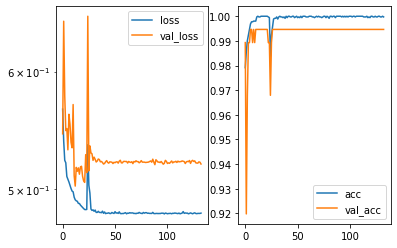

Predicted cell: Landmark Probability: [[0.9999987]]
True Cell type: Landmark
x [[0.55649173]]
True positional value x 0.578125
y [[0.42773008]]
True positional value y 0.421875


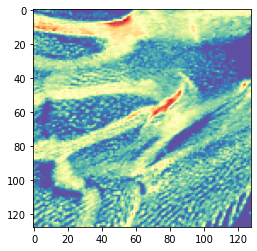

Epoch 134/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4829 - acc: 0.9997 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00134: ReduceLROnPlateau reducing learning rate to 1.0000000272452012e-28.

Epoch 00134: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522201297117427, 'val_acc': 0.9946524051421466, 'loss': 0.48285253851076204, 'acc': 0.999717992036543, 'lr': 1e-27}


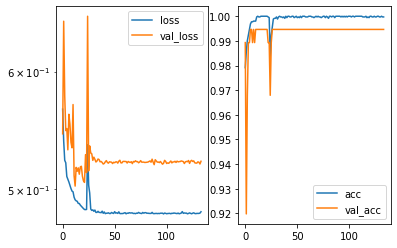

Predicted cell: Background Probability: [[0.9791765]]
True Cell type: Background
x [[0.46771833]]
True positional value x 0.5
y [[0.491722]]
True positional value y 0.5


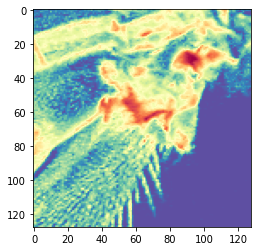

Epoch 135/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5213 - val_acc: 0.9947

Epoch 00135: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213040197915572, 'val_acc': 0.9946524051421466, 'loss': 0.4819437724113195, 'acc': 0.999717992036543, 'lr': 1e-28}


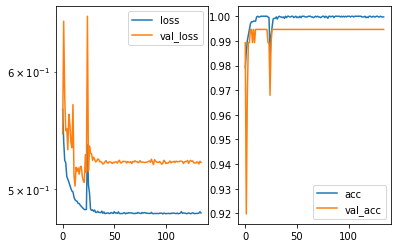

Predicted cell: Background Probability: [[0.99999917]]
True Cell type: Background
x [[0.50534093]]
True positional value x 0.5
y [[0.5117121]]
True positional value y 0.5


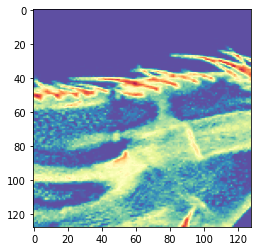

Epoch 136/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00136: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215440174156332, 'val_acc': 0.9946524051421466, 'loss': 0.4816445905612272, 'acc': 1.0, 'lr': 1e-28}


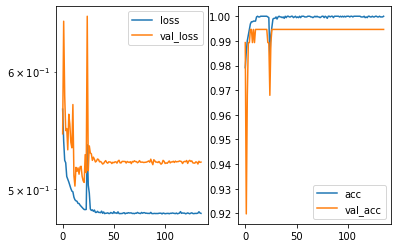

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.40302038]]
True positional value x 0.421875
y [[0.5654785]]
True positional value y 0.578125


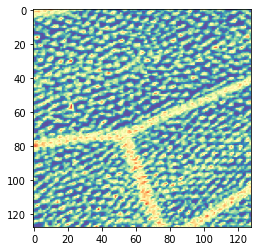

Epoch 137/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00137: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218234197659926, 'val_acc': 0.9946524051421466, 'loss': 0.48175899223022656, 'acc': 1.0, 'lr': 1e-28}


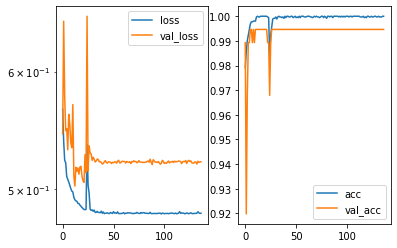

Predicted cell: Landmark Probability: [[0.9999981]]
True Cell type: Landmark
x [[0.411065]]
True positional value x 0.421875
y [[0.57859373]]
True positional value y 0.578125


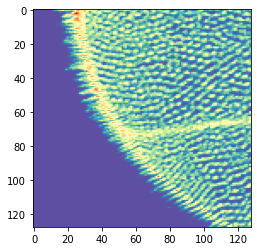

Epoch 138/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 0.9997 - val_loss: 0.5229 - val_acc: 0.9947

Epoch 00138: ReduceLROnPlateau reducing learning rate to 1.0000000031710769e-29.

Epoch 00138: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5228507308398976, 'val_acc': 0.9946524051421466, 'loss': 0.4823943860135506, 'acc': 0.999717992036543, 'lr': 1e-28}


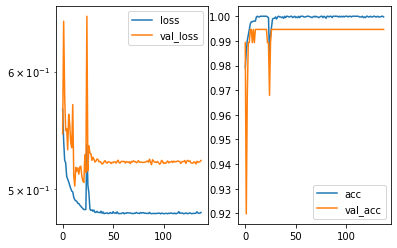

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47904631]]
True positional value x 0.5
y [[0.5198043]]
True positional value y 0.5


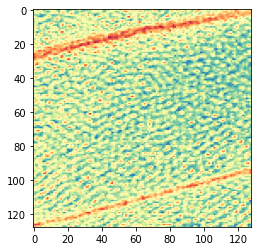

Epoch 139/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5211 - val_acc: 0.9947

Epoch 00139: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5211273952920169, 'val_acc': 0.9946524051421466, 'loss': 0.48155468382945654, 'acc': 1.0, 'lr': 1e-29}


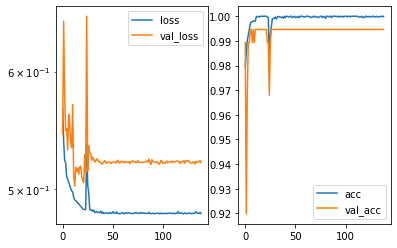

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.49764997]]
True positional value x 0.5
y [[0.5131231]]
True positional value y 0.5


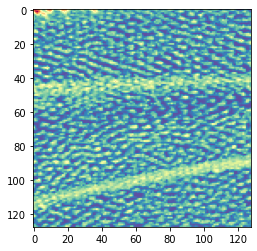

Epoch 140/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5223 - val_acc: 0.9947

Epoch 00140: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5223216213644507, 'val_acc': 0.9946524051421466, 'loss': 0.4816864876174281, 'acc': 0.999717992036543, 'lr': 1e-29}


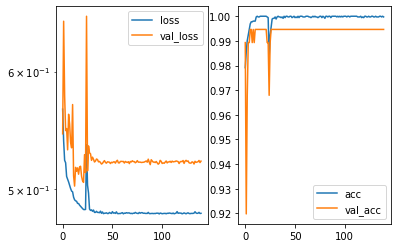

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5048818]]
True positional value x 0.5
y [[0.40953976]]
True positional value y 0.421875


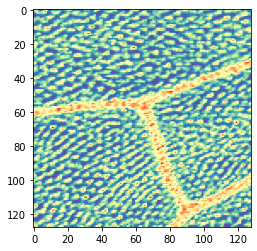

Epoch 141/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00141: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5221354217134058, 'val_acc': 0.9946524051421466, 'loss': 0.4820171562514598, 'acc': 0.999717992036543, 'lr': 1e-29}


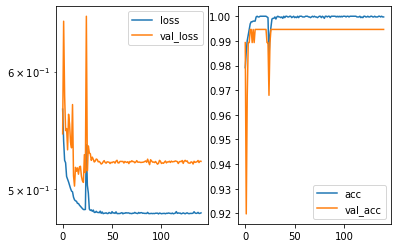

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5096045]]
True positional value x 0.5
y [[0.50037134]]
True positional value y 0.5


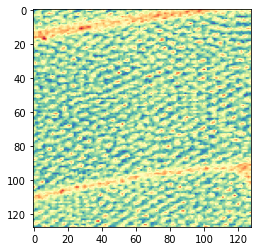

Epoch 142/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00142: ReduceLROnPlateau reducing learning rate to 1.0000000031710769e-30.

Epoch 00142: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217149401093549, 'val_acc': 0.9946524051421466, 'loss': 0.481597370033673, 'acc': 1.0, 'lr': 1e-29}


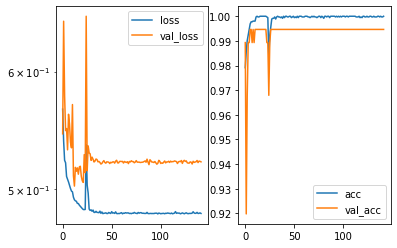

Predicted cell: Background Probability: [[0.99999964]]
True Cell type: Background
x [[0.49673563]]
True positional value x 0.5
y [[0.5031457]]
True positional value y 0.5


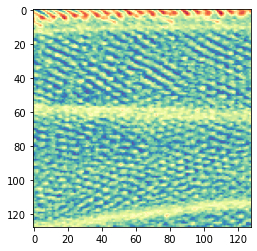

Epoch 143/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00143: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219628393331314, 'val_acc': 0.9946524051421466, 'loss': 0.4814090371232751, 'acc': 1.0, 'lr': 1e-30}


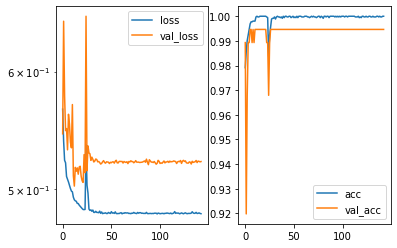

Predicted cell: Background Probability: [[0.9999987]]
True Cell type: Background
x [[0.49922064]]
True positional value x 0.5
y [[0.5046635]]
True positional value y 0.5


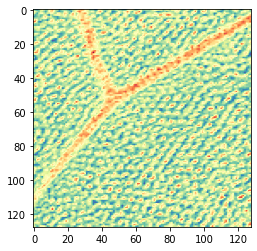

Epoch 144/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9994 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00144: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215118618253718, 'val_acc': 0.9946524051421466, 'loss': 0.4817824026016078, 'acc': 0.999435984073086, 'lr': 1e-30}


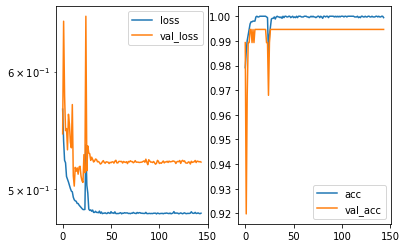

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.55162746]]
True positional value x 0.5
y [[0.56469035]]
True positional value y 0.578125


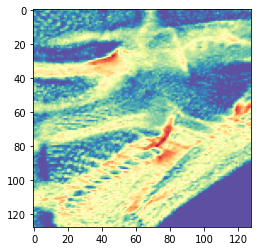

Epoch 145/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00145: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220317379994825, 'val_acc': 0.9946524051421466, 'loss': 0.4817211994732159, 'acc': 0.999717992036543, 'lr': 1e-30}


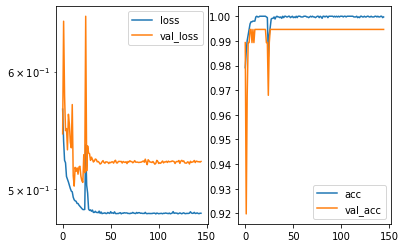

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49424016]]
True positional value x 0.5
y [[0.4949468]]
True positional value y 0.5


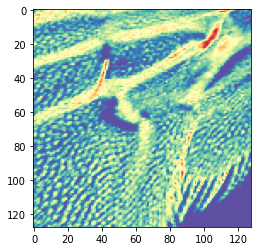

Epoch 146/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4824 - acc: 0.9997 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00146: ReduceLROnPlateau reducing learning rate to 1.000000003171077e-31.

Epoch 00146: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5205683811781878, 'val_acc': 0.9946524051421466, 'loss': 0.48236931587300996, 'acc': 0.999717992036543, 'lr': 1e-30}


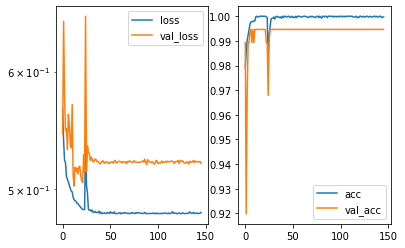

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.54904324]]
True positional value x 0.5
y [[0.5086273]]
True positional value y 0.5


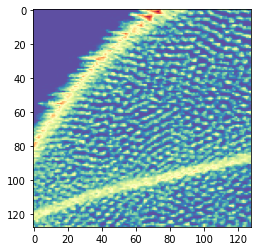

Epoch 147/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9994 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00147: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219049010684783, 'val_acc': 0.9946524051421466, 'loss': 0.48183019471854327, 'acc': 0.999435984073086, 'lr': 1e-31}


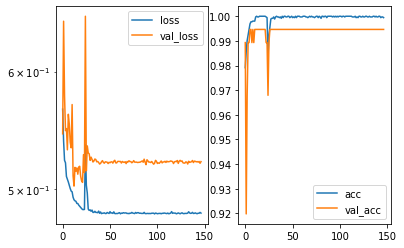

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5025826]]
True positional value x 0.5
y [[0.4905904]]
True positional value y 0.5


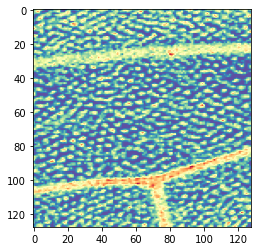

Epoch 148/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5213 - val_acc: 0.9947

Epoch 00148: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212797138461455, 'val_acc': 0.9946524051421466, 'loss': 0.48184146571145914, 'acc': 0.999717992036543, 'lr': 1e-31}


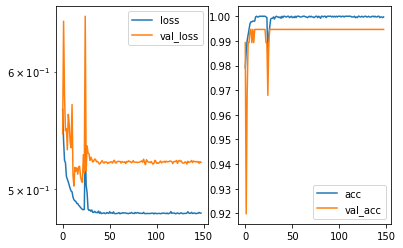

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4408562]]
True positional value x 0.421875
y [[0.49128392]]
True positional value y 0.5


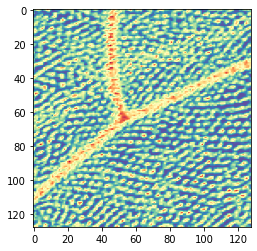

Epoch 149/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00149: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206695677124881, 'val_acc': 0.9946524051421466, 'loss': 0.48157586874224945, 'acc': 1.0, 'lr': 1e-31}


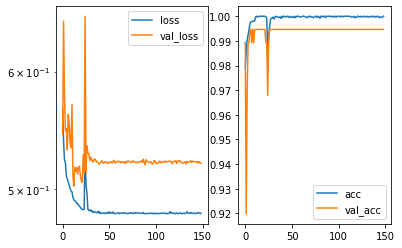

Predicted cell: Background Probability: [[0.9999949]]
True Cell type: Background
x [[0.5030716]]
True positional value x 0.5
y [[0.5015394]]
True positional value y 0.5


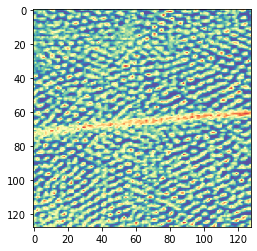

Epoch 150/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9997 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00150: ReduceLROnPlateau reducing learning rate to 9.999999796611899e-33.

Epoch 00150: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5221595906000086, 'val_acc': 0.9946524051421466, 'loss': 0.48219117681925, 'acc': 0.999717992036543, 'lr': 1e-31}


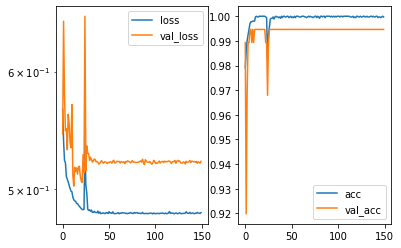

Predicted cell: Landmark Probability: [[0.9999982]]
True Cell type: Landmark
x [[0.44442636]]
True positional value x 0.421875
y [[0.57548034]]
True positional value y 0.578125


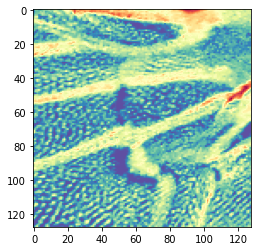

Epoch 151/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9994 - val_loss: 0.5205 - val_acc: 0.9947

Epoch 00151: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204716629204266, 'val_acc': 0.9946524051421466, 'loss': 0.4822984150722749, 'acc': 0.999435984073086, 'lr': 9.9999995e-33}


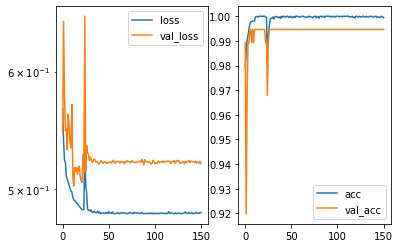

Predicted cell: Background Probability: [[0.9999813]]
True Cell type: Background
x [[0.51114154]]
True positional value x 0.5
y [[0.51055264]]
True positional value y 0.5


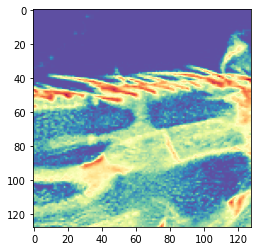

Epoch 152/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00152: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209671733851101, 'val_acc': 0.9946524051421466, 'loss': 0.4818917046612558, 'acc': 0.999717992036543, 'lr': 9.9999995e-33}


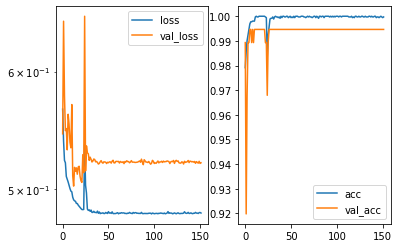

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4092975]]
True positional value x 0.421875
y [[0.5020764]]
True positional value y 0.5


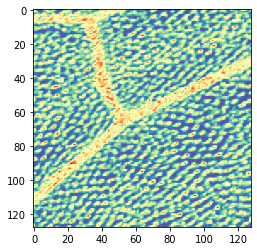

Epoch 153/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00153: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5208386703927249, 'val_acc': 0.9946524051421466, 'loss': 0.48192780914107625, 'acc': 0.999717992036543, 'lr': 9.9999995e-33}


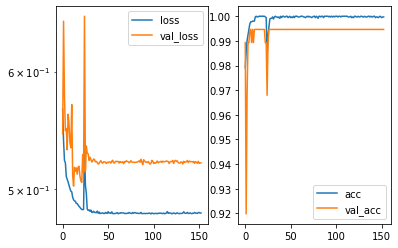

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.41826886]]
True positional value x 0.421875
y [[0.51955044]]
True positional value y 0.5


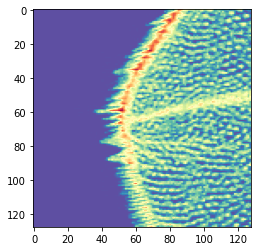

Epoch 154/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00154: ReduceLROnPlateau reducing learning rate to 9.999999502738312e-34.

Epoch 00154: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5222223533347329, 'val_acc': 0.9946524051421466, 'loss': 0.4819615475215686, 'acc': 0.999717992036543, 'lr': 9.9999995e-33}


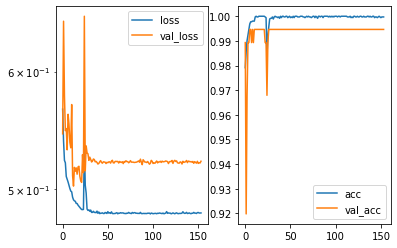

Predicted cell: Background Probability: [[0.9975769]]
True Cell type: Background
x [[0.47638866]]
True positional value x 0.5
y [[0.50096667]]
True positional value y 0.5


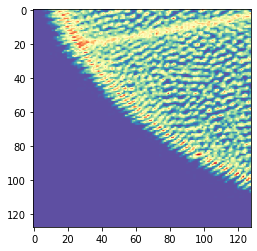

Epoch 155/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4821 - acc: 0.9994 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00155: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215111362105385, 'val_acc': 0.9946524051421466, 'loss': 0.4821391748259179, 'acc': 0.999435984073086, 'lr': 9.999999e-34}


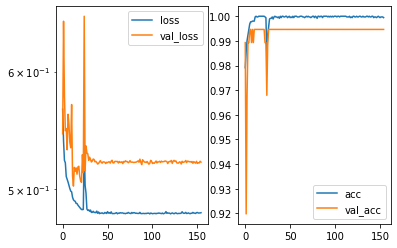

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.5106281]]
True positional value x 0.5
y [[0.4157632]]
True positional value y 0.421875


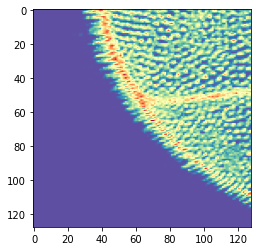

Epoch 156/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00156: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5211660686661216, 'val_acc': 0.9946524051421466, 'loss': 0.4815835627505017, 'acc': 1.0, 'lr': 9.999999e-34}


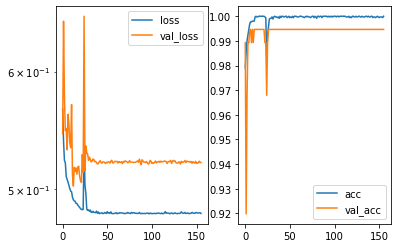

Predicted cell: Background Probability: [[0.99999905]]
True Cell type: Background
x [[0.48365226]]
True positional value x 0.5
y [[0.51739764]]
True positional value y 0.5


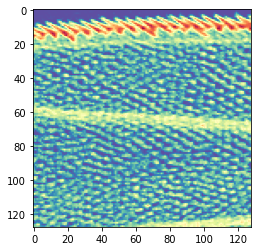

Epoch 157/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5205 - val_acc: 0.9947

Epoch 00157: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.52054131620708, 'val_acc': 0.9946524051421466, 'loss': 0.48141473141754676, 'acc': 1.0, 'lr': 9.999999e-34}


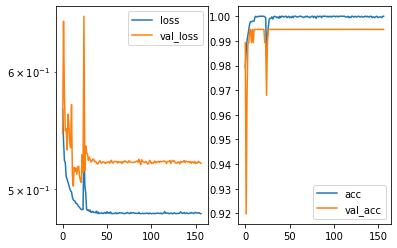

Predicted cell: Landmark Probability: [[0.992718]]
True Cell type: Landmark
x [[0.4086064]]
True positional value x 0.421875
y [[0.42717248]]
True positional value y 0.421875


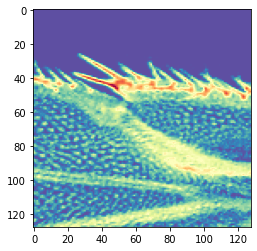

Epoch 158/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9994 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00158: ReduceLROnPlateau reducing learning rate to 9.999999319067318e-35.

Epoch 00158: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217825161582008, 'val_acc': 0.9946524051421466, 'loss': 0.4821711701823706, 'acc': 0.999435984073086, 'lr': 9.999999e-34}


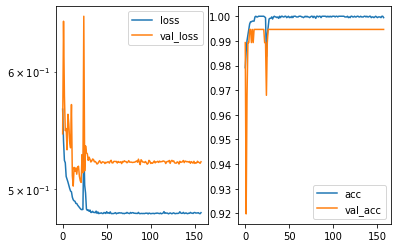

Predicted cell: Background Probability: [[0.99999285]]
True Cell type: Background
x [[0.54850763]]
True positional value x 0.5
y [[0.4812121]]
True positional value y 0.5


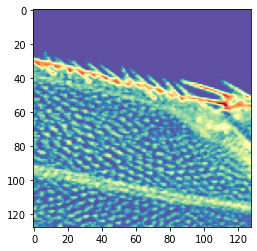

Epoch 159/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 1.0000 - val_loss: 0.5202 - val_acc: 0.9947

Epoch 00159: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5202463879623515, 'val_acc': 0.9946524051421466, 'loss': 0.4819129325714208, 'acc': 1.0, 'lr': 9.999999e-35}


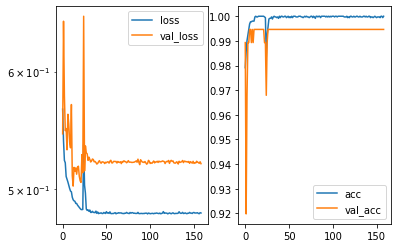

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48689666]]
True positional value x 0.5
y [[0.48114946]]
True positional value y 0.5


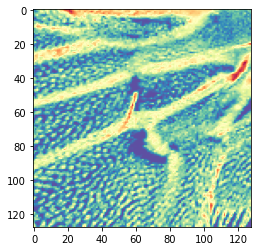

Epoch 160/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9992 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00160: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521858551604225, 'val_acc': 0.9946524051421466, 'loss': 0.4823221330479989, 'acc': 0.999153976109629, 'lr': 9.999999e-35}


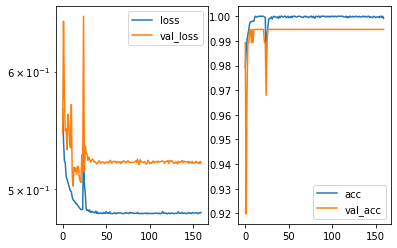

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4740766]]
True positional value x 0.5
y [[0.4865042]]
True positional value y 0.5


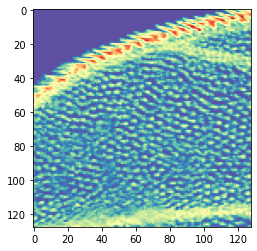

Epoch 161/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4825 - acc: 0.9994 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00161: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213823291388425, 'val_acc': 0.9946524051421466, 'loss': 0.4824554097060759, 'acc': 0.999435984073086, 'lr': 9.999999e-35}


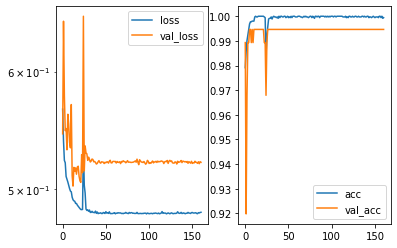

Predicted cell: Background Probability: [[0.99999845]]
True Cell type: Background
x [[0.4986135]]
True positional value x 0.5
y [[0.5044399]]
True positional value y 0.5


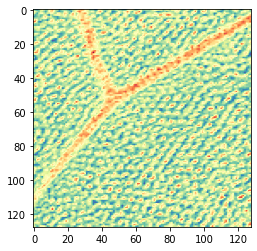

Epoch 162/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00162: ReduceLROnPlateau reducing learning rate to 9.999999319067319e-36.

Epoch 00162: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206430281866044, 'val_acc': 0.9946524051421466, 'loss': 0.48162937643362586, 'acc': 1.0, 'lr': 9.999999e-35}


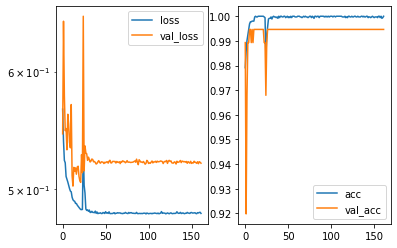

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.50623393]]
True positional value x 0.5
y [[0.4102957]]
True positional value y 0.421875


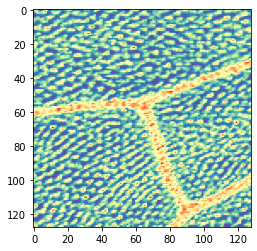

Epoch 163/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00163: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216454624492217, 'val_acc': 0.9946524051421466, 'loss': 0.4819471727504074, 'acc': 0.999717992036543, 'lr': 9.9999995e-36}


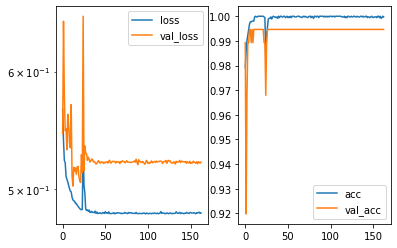

Predicted cell: Landmark Probability: [[0.9999988]]
True Cell type: Landmark
x [[0.55594]]
True positional value x 0.578125
y [[0.5111755]]
True positional value y 0.5


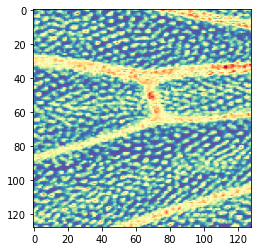

Epoch 164/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00164: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217521887093304, 'val_acc': 0.9946524051421466, 'loss': 0.48156701025825666, 'acc': 1.0, 'lr': 9.9999995e-36}


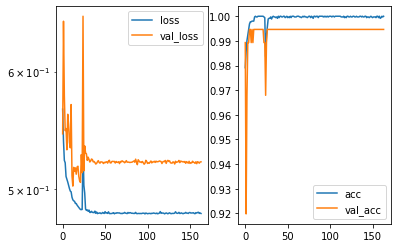

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.41853887]]
True positional value x 0.421875
y [[0.48406366]]
True positional value y 0.5


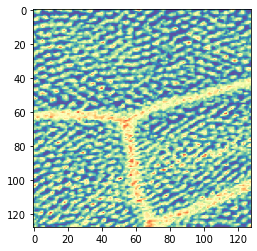

Epoch 165/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00165: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5207548072950088, 'val_acc': 0.9946524051421466, 'loss': 0.48134706224416246, 'acc': 1.0, 'lr': 9.9999995e-36}


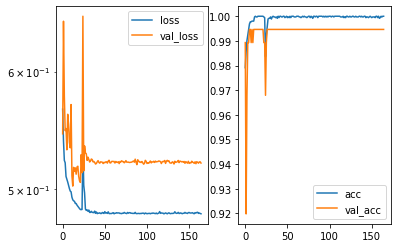

Predicted cell: Background Probability: [[0.9998913]]
True Cell type: Background
x [[0.47668824]]
True positional value x 0.5
y [[0.5224576]]
True positional value y 0.5


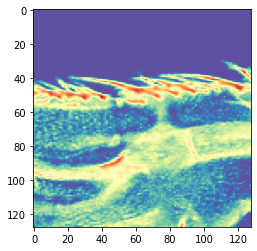

Epoch 166/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5227 - val_acc: 0.9947

Epoch 00166: ReduceLROnPlateau reducing learning rate to 9.999999462560281e-37.

Epoch 00166: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5226888838298818, 'val_acc': 0.9946524051421466, 'loss': 0.48130451130181195, 'acc': 1.0, 'lr': 9.9999995e-36}


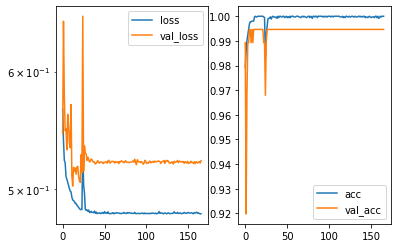

Predicted cell: Landmark Probability: [[0.9999958]]
True Cell type: Landmark
x [[0.5099375]]
True positional value x 0.5
y [[0.59090114]]
True positional value y 0.578125


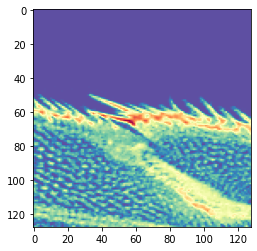

Epoch 167/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00167: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215348319255094, 'val_acc': 0.9946524051421466, 'loss': 0.4812807641793158, 'acc': 1.0, 'lr': 9.9999995e-37}


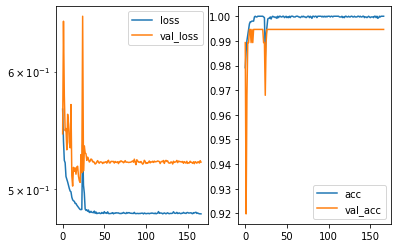

Predicted cell: Landmark Probability: [[0.99978155]]
True Cell type: Landmark
x [[0.5667554]]
True positional value x 0.578125
y [[0.49179372]]
True positional value y 0.5


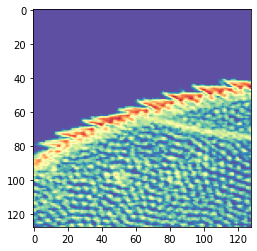

Epoch 168/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00168: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213526648314879, 'val_acc': 0.9946524051421466, 'loss': 0.48165323064613663, 'acc': 1.0, 'lr': 9.9999995e-37}


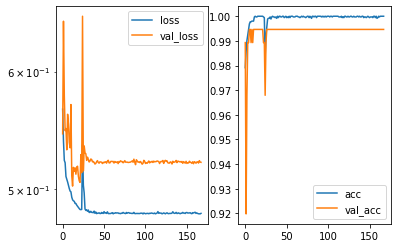

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.40340427]]
True positional value x 0.421875
y [[0.5658391]]
True positional value y 0.578125


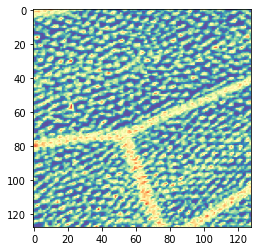

Epoch 169/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00169: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5211544476728388, 'val_acc': 0.9946524051421466, 'loss': 0.48192827279999373, 'acc': 0.999717992036543, 'lr': 9.9999995e-37}


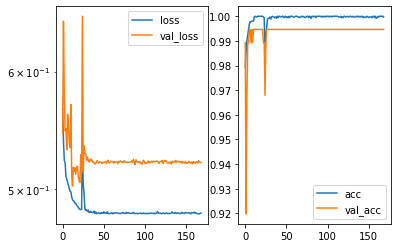

Predicted cell: Background Probability: [[0.999747]]
True Cell type: Background
x [[0.5322503]]
True positional value x 0.5
y [[0.47756615]]
True positional value y 0.5


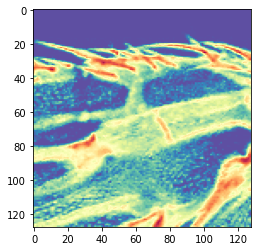

Epoch 170/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9994 - val_loss: 0.5213 - val_acc: 0.9947

Epoch 00170: ReduceLROnPlateau reducing learning rate to 9.99999946256028e-38.

Epoch 00170: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212926332325859, 'val_acc': 0.9946524051421466, 'loss': 0.48231629093555295, 'acc': 0.999435984073086, 'lr': 9.9999995e-37}


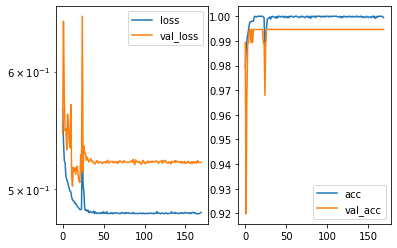

Predicted cell: Landmark Probability: [[0.9999733]]
True Cell type: Landmark
x [[0.5061051]]
True positional value x 0.5
y [[0.51633745]]
True positional value y 0.5


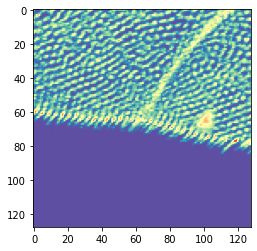

Epoch 171/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4820 - acc: 0.9994 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00171: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218465038161865, 'val_acc': 0.9946524051421466, 'loss': 0.482035121504896, 'acc': 0.999435984106704, 'lr': 1e-37}


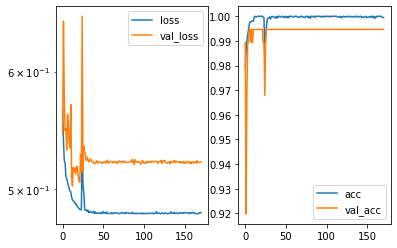

Predicted cell: Landmark Probability: [[0.99999356]]
True Cell type: Landmark
x [[0.58924]]
True positional value x 0.578125
y [[0.48098227]]
True positional value y 0.5


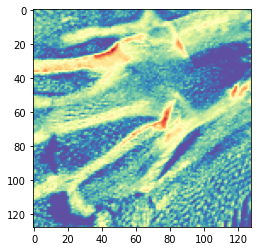

Epoch 172/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5203 - val_acc: 0.9947

Epoch 00172: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5202725266709047, 'val_acc': 0.9946524051421466, 'loss': 0.48176493043961394, 'acc': 0.999717992036543, 'lr': 1e-37}


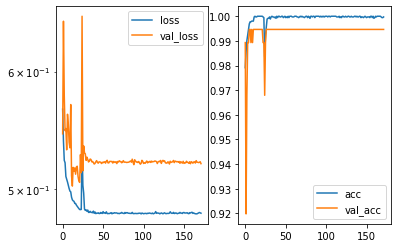

Predicted cell: Landmark Probability: [[0.99943227]]
True Cell type: Landmark
x [[0.59051996]]
True positional value x 0.578125
y [[0.57984287]]
True positional value y 0.578125


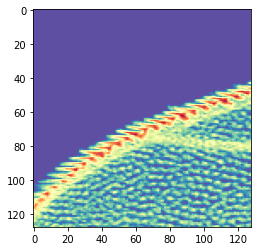

Epoch 173/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5203 - val_acc: 0.9947

Epoch 00173: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5202558447014202, 'val_acc': 0.9946524051421466, 'loss': 0.4816039064410576, 'acc': 0.999717992036543, 'lr': 1e-37}


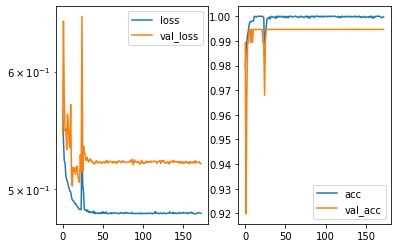

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5121621]]
True positional value x 0.5
y [[0.5199672]]
True positional value y 0.5


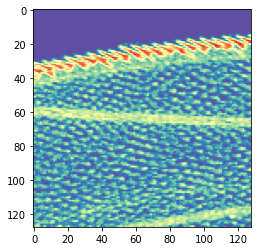

Epoch 174/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00174: ReduceLROnPlateau reducing learning rate to 9.99999991097579e-39.

Epoch 00174: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.520899471433405, 'val_acc': 0.9946524051421466, 'loss': 0.4819038216333502, 'acc': 0.999717992036543, 'lr': 1e-37}


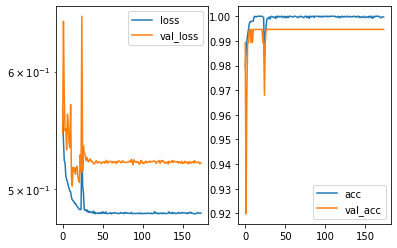

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49814937]]
True positional value x 0.5
y [[0.58327407]]
True positional value y 0.578125


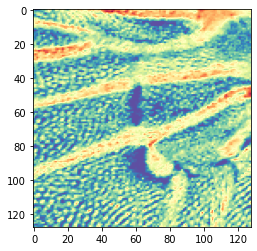

Epoch 175/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00175: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5208305145967453, 'val_acc': 0.9946524051421466, 'loss': 0.48153161743705175, 'acc': 1.0, 'lr': 1e-38}


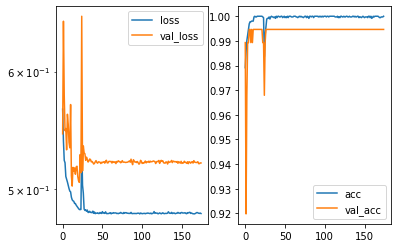

Predicted cell: Background Probability: [[0.99999833]]
True Cell type: Background
x [[0.5184456]]
True positional value x 0.5
y [[0.51871866]]
True positional value y 0.5


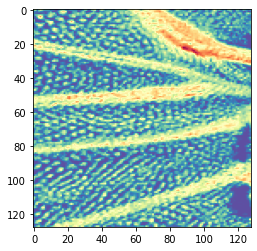

Epoch 176/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00176: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216493149173451, 'val_acc': 0.9946524051421466, 'loss': 0.48160249894107726, 'acc': 1.0, 'lr': 1e-38}


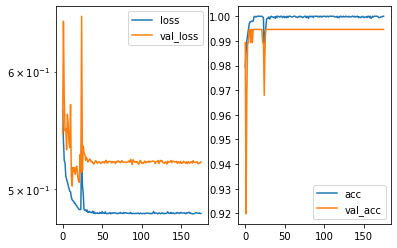

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.4832153]]
True positional value x 0.5
y [[0.47968048]]
True positional value y 0.5


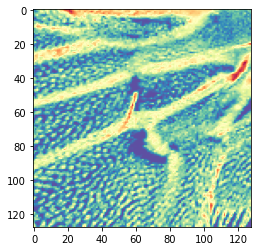

Epoch 177/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5213 - val_acc: 0.9947

Epoch 00177: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213375352920695, 'val_acc': 0.9946524051421466, 'loss': 0.48180042934229467, 'acc': 0.999717992036543, 'lr': 1e-38}


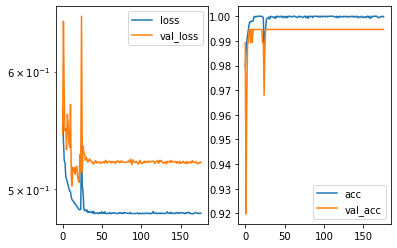

Predicted cell: Landmark Probability: [[0.9994844]]
True Cell type: Landmark
x [[0.41873997]]
True positional value x 0.421875
y [[0.49044508]]
True positional value y 0.5


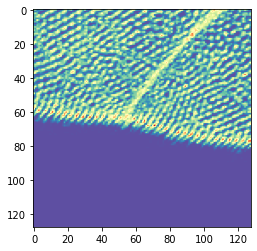

Epoch 178/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00178: ReduceLROnPlateau reducing learning rate to 9.999999350456405e-40.

Epoch 00178: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218544219904405, 'val_acc': 0.9946524051421466, 'loss': 0.4817105961498136, 'acc': 0.999717992036543, 'lr': 1e-38}


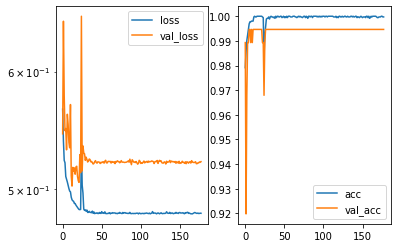

Predicted cell: Background Probability: [[0.9999721]]
True Cell type: Background
x [[0.4782779]]
True positional value x 0.5
y [[0.4931677]]
True positional value y 0.5


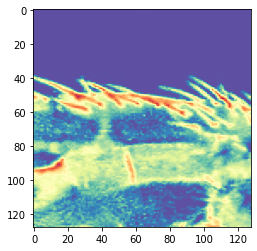

Epoch 179/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4819 - acc: 0.9994 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00179: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219118509063109, 'val_acc': 0.9946524051421466, 'loss': 0.4819297154139343, 'acc': 0.999435984073086, 'lr': 1e-39}


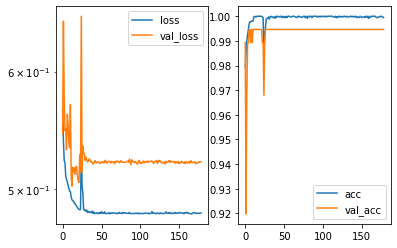

Predicted cell: Background Probability: [[0.9999907]]
True Cell type: Background
x [[0.5048297]]
True positional value x 0.5
y [[0.5100758]]
True positional value y 0.5


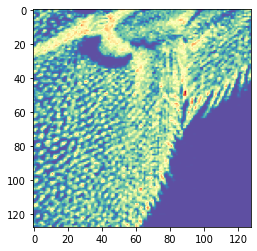

Epoch 180/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9997 - val_loss: 0.5224 - val_acc: 0.9947

Epoch 00180: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5223902513317883, 'val_acc': 0.9946524051421466, 'loss': 0.48232665612612885, 'acc': 0.999717992036543, 'lr': 1e-39}


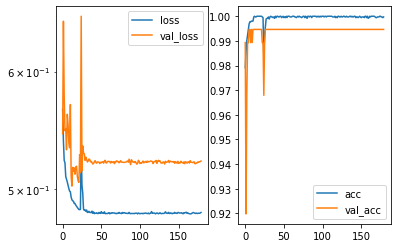

Predicted cell: Landmark Probability: [[0.99999774]]
True Cell type: Landmark
x [[0.44503012]]
True positional value x 0.421875
y [[0.53407484]]
True positional value y 0.5


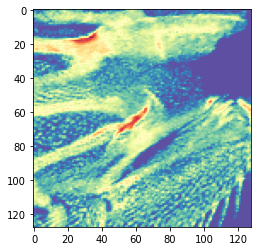

Epoch 181/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5230 - val_acc: 0.9947

Epoch 00181: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5229598694944126, 'val_acc': 0.9946524051421466, 'loss': 0.48179429567808224, 'acc': 0.999717992036543, 'lr': 1e-39}


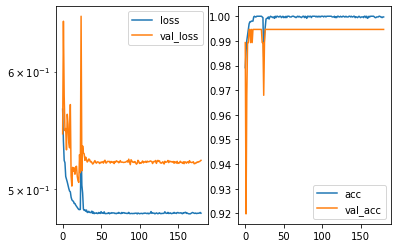

Predicted cell: Landmark Probability: [[0.99999726]]
True Cell type: Landmark
x [[0.42080018]]
True positional value x 0.421875
y [[0.57616043]]
True positional value y 0.578125


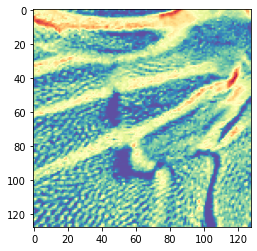

Epoch 182/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00182: ReduceLROnPlateau reducing learning rate to 1.0000002153053334e-40.

Epoch 00182: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217480399710609, 'val_acc': 0.9946524051421466, 'loss': 0.4814090019420789, 'acc': 1.0, 'lr': 1e-39}


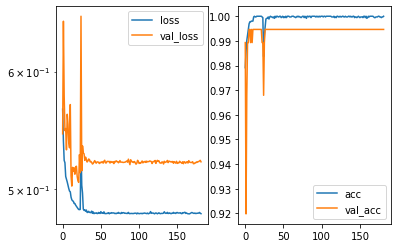

Predicted cell: Landmark Probability: [[0.99999595]]
True Cell type: Landmark
x [[0.51030916]]
True positional value x 0.5
y [[0.591647]]
True positional value y 0.578125


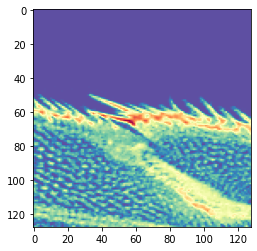

Epoch 183/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00183: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209791464282867, 'val_acc': 0.9946524051421466, 'loss': 0.4814946423024696, 'acc': 1.0, 'lr': 1e-40}


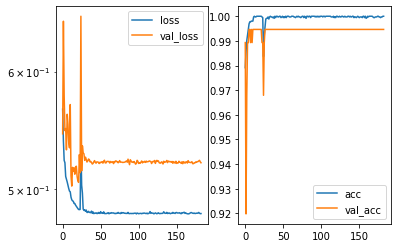

Predicted cell: Landmark Probability: [[0.99999285]]
True Cell type: Landmark
x [[0.4290332]]
True positional value x 0.421875
y [[0.46356022]]
True positional value y 0.421875


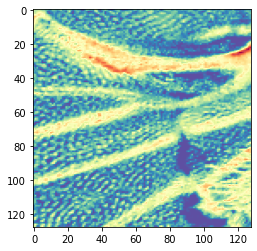

Epoch 184/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9994 - val_loss: 0.5225 - val_acc: 0.9947

Epoch 00184: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5224919727141845, 'val_acc': 0.9946524051421466, 'loss': 0.4822634132447649, 'acc': 0.999435984073086, 'lr': 1e-40}


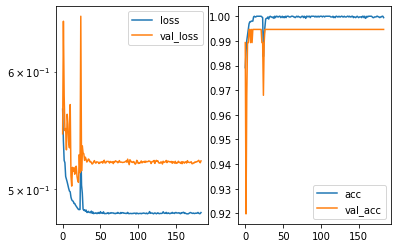

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49198148]]
True positional value x 0.5
y [[0.49931952]]
True positional value y 0.5


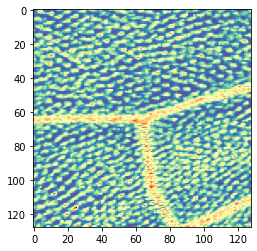

Epoch 185/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4819 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00185: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218408801020148, 'val_acc': 0.9946524051421466, 'loss': 0.4819039585593052, 'acc': 1.0, 'lr': 1e-40}


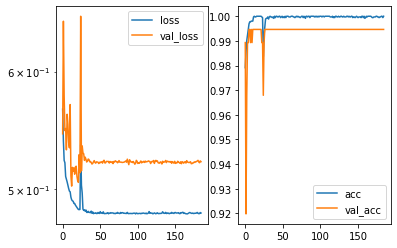

Predicted cell: Landmark Probability: [[0.9999981]]
True Cell type: Landmark
x [[0.40964982]]
True positional value x 0.421875
y [[0.5804002]]
True positional value y 0.578125


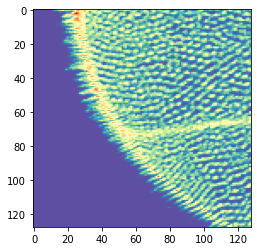

Epoch 186/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00186: ReduceLROnPlateau reducing learning rate to 9.99994610111476e-42.

Epoch 00186: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220051801459674, 'val_acc': 0.9946524051421466, 'loss': 0.48149948577657636, 'acc': 1.0, 'lr': 1e-40}


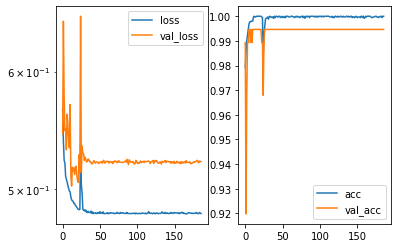

Predicted cell: Landmark Probability: [[0.9999801]]
True Cell type: Landmark
x [[0.40376768]]
True positional value x 0.421875
y [[0.49672508]]
True positional value y 0.5


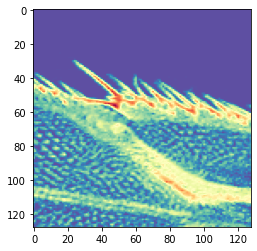

Epoch 187/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4823 - acc: 0.9992 - val_loss: 0.5224 - val_acc: 0.9947

Epoch 00187: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522365706170944, 'val_acc': 0.9946524051421466, 'loss': 0.4822563296882567, 'acc': 0.999153976109629, 'lr': 1e-41}


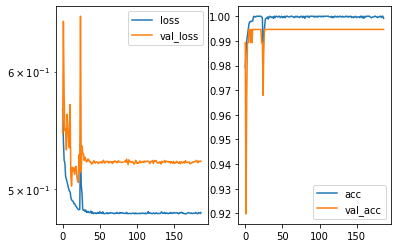

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48178354]]
True positional value x 0.5
y [[0.42425284]]
True positional value y 0.421875


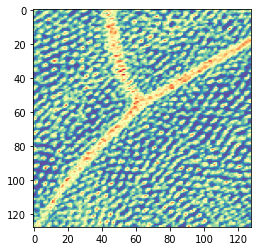

Epoch 188/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00188: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5222037861691439, 'val_acc': 0.9946524051421466, 'loss': 0.48180362514970804, 'acc': 0.999717992036543, 'lr': 1e-41}


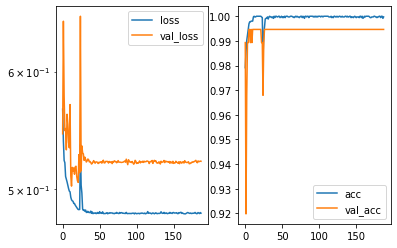

Predicted cell: Background Probability: [[0.99976355]]
True Cell type: Background
x [[0.5329039]]
True positional value x 0.5
y [[0.47769973]]
True positional value y 0.5


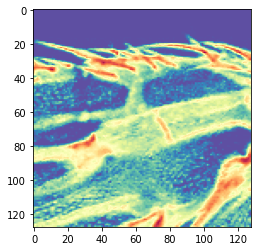

Epoch 189/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5226 - val_acc: 0.9947

Epoch 00189: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5225798046206408, 'val_acc': 0.9946524051421466, 'loss': 0.4816839108343388, 'acc': 0.999717992036543, 'lr': 1e-41}


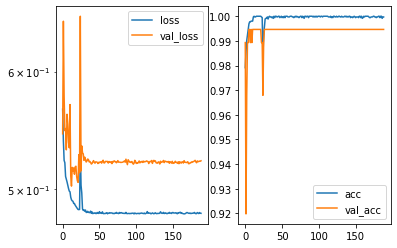

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.58098835]]
True positional value x 0.578125
y [[0.5563045]]
True positional value y 0.578125


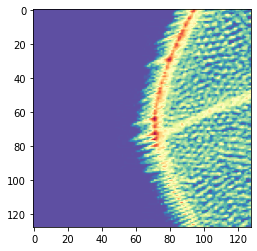

Epoch 190/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5228 - val_acc: 0.9947

Epoch 00190: ReduceLROnPlateau reducing learning rate to 9.999665841421895e-43.

Epoch 00190: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522760261666966, 'val_acc': 0.9946524051421466, 'loss': 0.48202539349234313, 'acc': 0.999717992036543, 'lr': 1e-41}


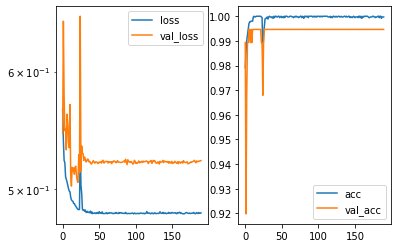

Predicted cell: Landmark Probability: [[0.99999213]]
True Cell type: Landmark
x [[0.41344735]]
True positional value x 0.421875
y [[0.55962795]]
True positional value y 0.578125


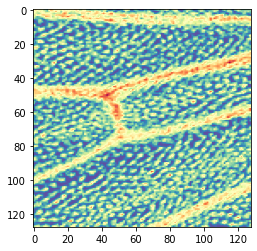

Epoch 191/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4822 - acc: 0.9994 - val_loss: 0.5213 - val_acc: 0.9947

Epoch 00191: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5212984188673968, 'val_acc': 0.9946524051421466, 'loss': 0.48221335722710273, 'acc': 0.999435984073086, 'lr': 1e-42}


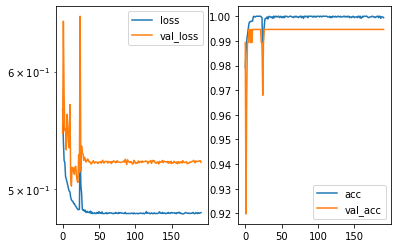

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.47395772]]
True positional value x 0.5
y [[0.45233122]]
True positional value y 0.5


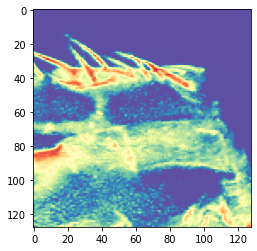

Epoch 192/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4813 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00192: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220193056499257, 'val_acc': 0.9946524051421466, 'loss': 0.48132328262990703, 'acc': 1.0, 'lr': 1e-42}


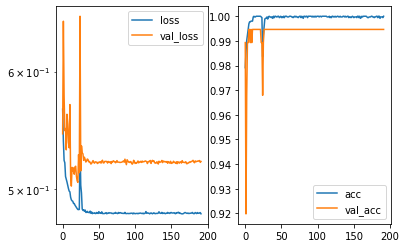

Predicted cell: Landmark Probability: [[0.99999845]]
True Cell type: Landmark
x [[0.4440678]]
True positional value x 0.421875
y [[0.5775551]]
True positional value y 0.578125


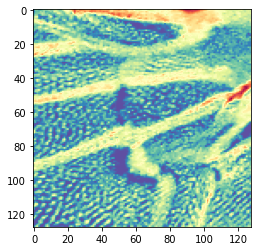

Epoch 193/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00193: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216898455976803, 'val_acc': 0.9946524051421466, 'loss': 0.4818294979694934, 'acc': 0.999717992036543, 'lr': 1e-42}


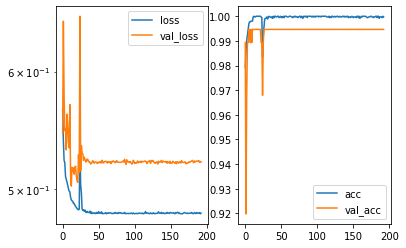

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5095305]]
True positional value x 0.5
y [[0.5006532]]
True positional value y 0.5


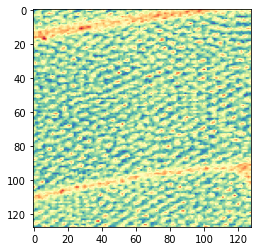

Epoch 194/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00194: ReduceLROnPlateau reducing learning rate to 1.0005271035279195e-43.

Epoch 00194: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5205677328581478, 'val_acc': 0.9946524051421466, 'loss': 0.4816171363021315, 'acc': 1.0, 'lr': 1e-42}


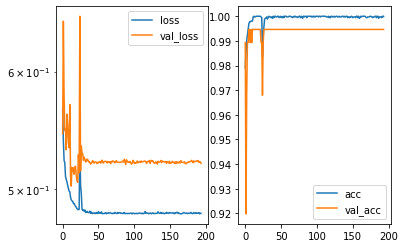

Predicted cell: Landmark Probability: [[0.999998]]
True Cell type: Landmark
x [[0.4152162]]
True positional value x 0.421875
y [[0.57995915]]
True positional value y 0.578125


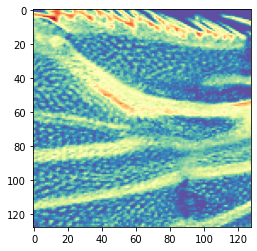

Epoch 195/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00195: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5208405790163234, 'val_acc': 0.9946524051421466, 'loss': 0.4814815343233131, 'acc': 1.0, 'lr': 1e-43}


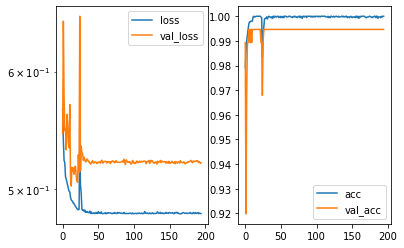

Predicted cell: Background Probability: [[0.9999995]]
True Cell type: Background
x [[0.4971234]]
True positional value x 0.5
y [[0.50311255]]
True positional value y 0.5


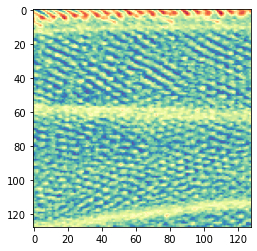

Epoch 196/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5226 - val_acc: 0.9947

Epoch 00196: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5226152861182065, 'val_acc': 0.9946524051421466, 'loss': 0.48156021280740524, 'acc': 1.0, 'lr': 1e-43}


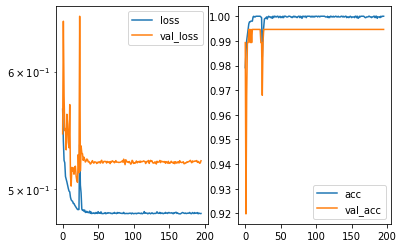

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5037751]]
True positional value x 0.5
y [[0.49070403]]
True positional value y 0.5


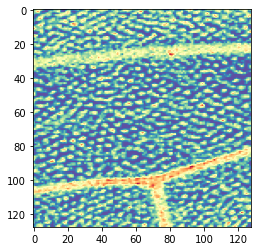

Epoch 197/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5226 - val_acc: 0.9947

Epoch 00197: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5225888905040721, 'val_acc': 0.9946524051421466, 'loss': 0.48166946096065283, 'acc': 1.0, 'lr': 1e-43}


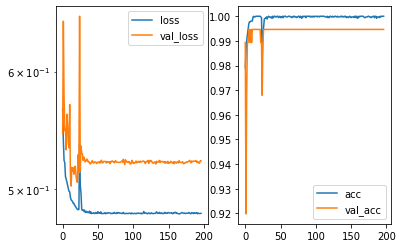

Predicted cell: Background Probability: [[0.99999833]]
True Cell type: Background
x [[0.5204382]]
True positional value x 0.5
y [[0.51868045]]
True positional value y 0.5


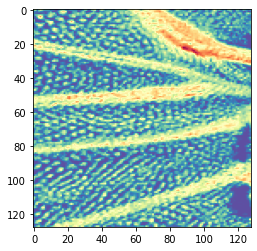

Epoch 198/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5205 - val_acc: 0.9947

Epoch 00198: ReduceLROnPlateau reducing learning rate to 9.949219096706202e-45.

Epoch 00198: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204933755856784, 'val_acc': 0.9946524051421466, 'loss': 0.481768217788735, 'acc': 0.999717992036543, 'lr': 1e-43}


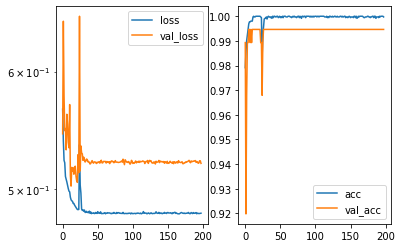

Predicted cell: Background Probability: [[0.9999993]]
True Cell type: Background
x [[0.5047395]]
True positional value x 0.5
y [[0.5095081]]
True positional value y 0.5


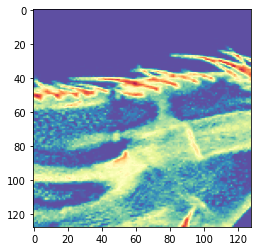

Epoch 199/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00199: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218696932104182, 'val_acc': 0.9946524051421466, 'loss': 0.4818491873200573, 'acc': 0.999717992036543, 'lr': 1e-44}


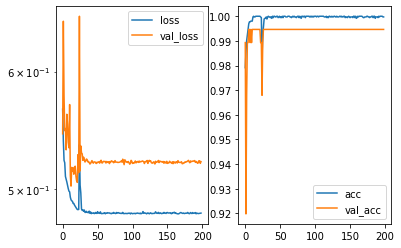

Predicted cell: Background Probability: [[0.99994385]]
True Cell type: Background
x [[0.49542445]]
True positional value x 0.5
y [[0.4860845]]
True positional value y 0.5


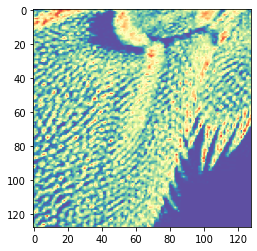

Epoch 200/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00200: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204341105598816, 'val_acc': 0.9946524051421466, 'loss': 0.4815541147109955, 'acc': 1.0, 'lr': 1e-44}


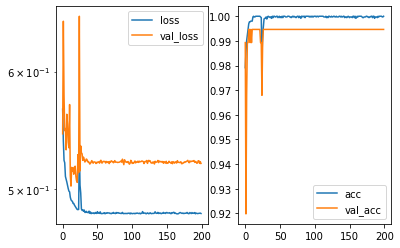

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5311087]]
True positional value x 0.578125
y [[0.5110023]]
True positional value y 0.5


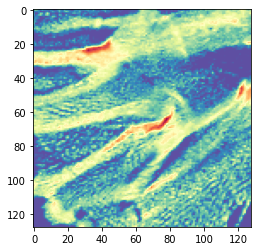

Epoch 201/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4825 - acc: 0.9994 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00201: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219584319362028, 'val_acc': 0.9946524051421466, 'loss': 0.4824515155023326, 'acc': 0.999435984073086, 'lr': 1e-44}


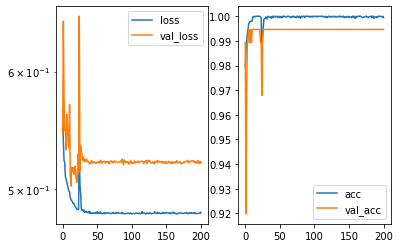

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.49984705]]
True positional value x 0.5
y [[0.42530626]]
True positional value y 0.421875


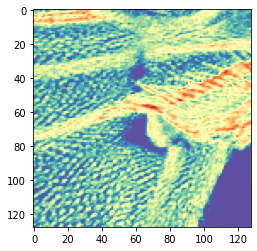

Epoch 202/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00202: ReduceLROnPlateau reducing learning rate to 9.80908925027372e-46.

Epoch 00202: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220983516086232, 'val_acc': 0.9946524051421466, 'loss': 0.48200235577605904, 'acc': 0.999717992036543, 'lr': 1e-44}


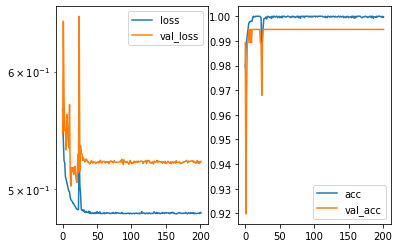

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.47179875]]
True positional value x 0.5
y [[0.50139976]]
True positional value y 0.5


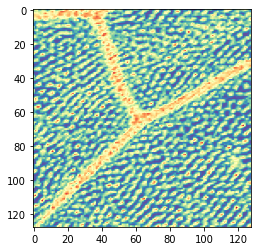

Epoch 203/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5225 - val_acc: 0.9947

Epoch 00203: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5225044594091528, 'val_acc': 0.9946524051421466, 'loss': 0.48168972637178664, 'acc': 1.0, 'lr': 1e-45}


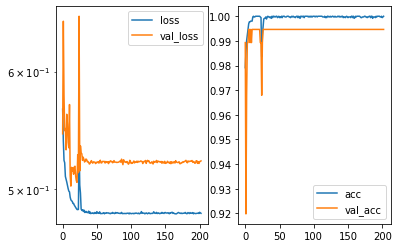

Predicted cell: Landmark Probability: [[0.9953811]]
True Cell type: Landmark
x [[0.43936142]]
True positional value x 0.421875
y [[0.5580977]]
True positional value y 0.578125


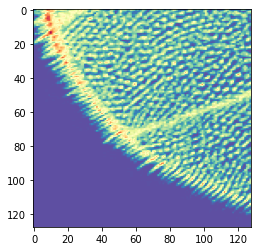

Epoch 204/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00204: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215879219738557, 'val_acc': 0.9946524051421466, 'loss': 0.4816724427225088, 'acc': 1.0, 'lr': 1e-45}


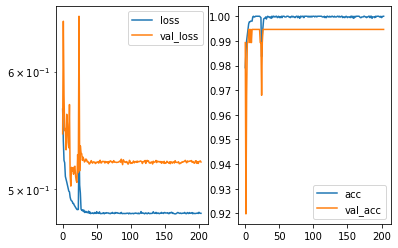

Predicted cell: Landmark Probability: [[0.9999908]]
True Cell type: Landmark
x [[0.51798624]]
True positional value x 0.5
y [[0.5819343]]
True positional value y 0.578125


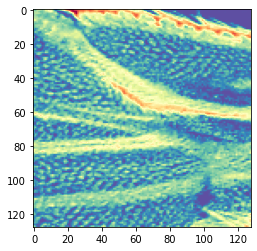

Epoch 205/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00205: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521507054567337, 'val_acc': 0.9946524051421466, 'loss': 0.48201435253032504, 'acc': 1.0, 'lr': 1e-45}


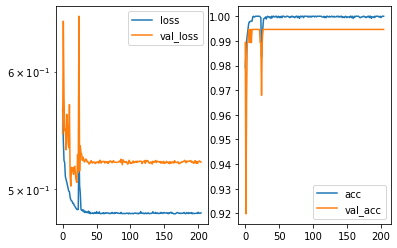

Predicted cell: Landmark Probability: [[0.9999795]]
True Cell type: Landmark
x [[0.52236575]]
True positional value x 0.5
y [[0.5026482]]
True positional value y 0.5


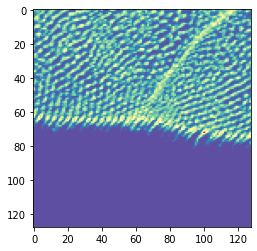

Epoch 206/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5223 - val_acc: 0.9947

Epoch 00206: ReduceLROnPlateau reducing learning rate to 1.4012984643248171e-46.

Epoch 00206: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.522260660793692, 'val_acc': 0.9946524051421466, 'loss': 0.4814868607026201, 'acc': 1.0, 'lr': 1e-45}


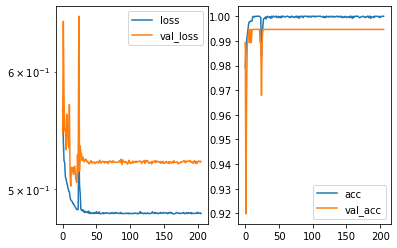

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5304349]]
True positional value x 0.578125
y [[0.5113773]]
True positional value y 0.5


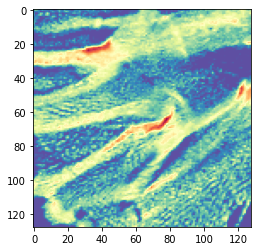

Epoch 207/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4826 - acc: 0.9994 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00207: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216149274996895, 'val_acc': 0.9946524051421466, 'loss': 0.4825790054335543, 'acc': 0.999435984073086, 'lr': 0.0}


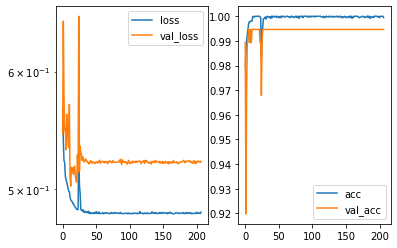

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.43220946]]
True positional value x 0.421875
y [[0.50301784]]
True positional value y 0.5


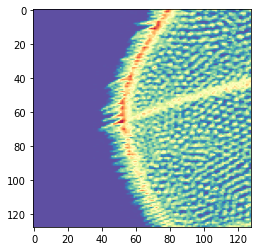

Epoch 208/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00208: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5207172692778276, 'val_acc': 0.9946524051421466, 'loss': 0.4819536268778326, 'acc': 0.999717992036543, 'lr': 0.0}


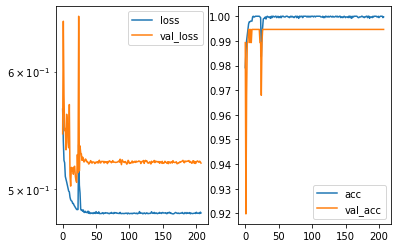

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49875718]]
True positional value x 0.5
y [[0.578244]]
True positional value y 0.578125


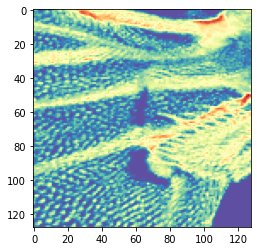

Epoch 209/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4821 - acc: 0.9994 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00209: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5208044651357885, 'val_acc': 0.9946524051421466, 'loss': 0.482062607415302, 'acc': 0.999435984073086, 'lr': 0.0}


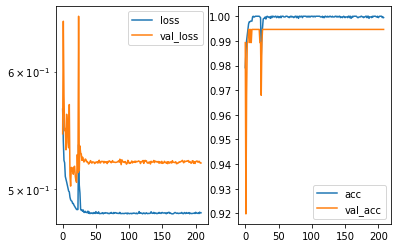

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5960441]]
True positional value x 0.578125
y [[0.5095618]]
True positional value y 0.5


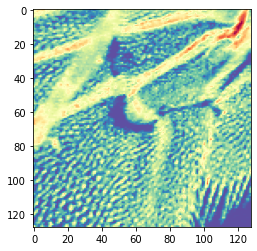

Epoch 210/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00210: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5204196205751144, 'val_acc': 0.9946524051421466, 'loss': 0.4814197113133391, 'acc': 1.0, 'lr': 0.0}


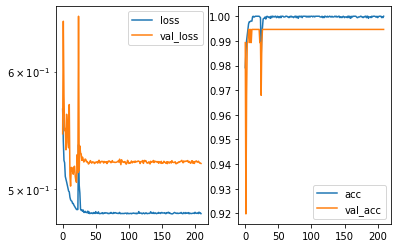

Predicted cell: Background Probability: [[0.9999993]]
True Cell type: Background
x [[0.5040481]]
True positional value x 0.5
y [[0.51019096]]
True positional value y 0.5


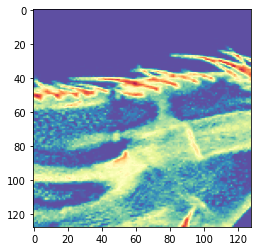

Epoch 211/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5224 - val_acc: 0.9947

Epoch 00211: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5223865150449111, 'val_acc': 0.9946524051421466, 'loss': 0.48189903243544135, 'acc': 0.999717992036543, 'lr': 0.0}


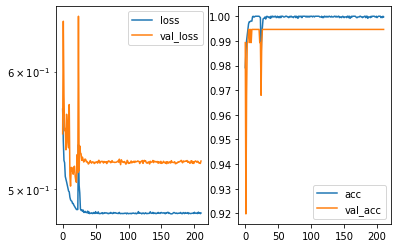

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5715974]]
True positional value x 0.578125
y [[0.38925692]]
True positional value y 0.421875


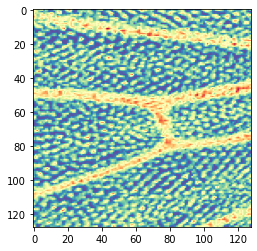

Epoch 212/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4822 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00212: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216510805854185, 'val_acc': 0.9946524051421466, 'loss': 0.4822023105332223, 'acc': 0.999717992036543, 'lr': 0.0}


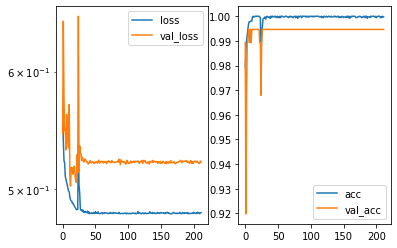

Predicted cell: Background Probability: [[0.9997621]]
True Cell type: Background
x [[0.47121271]]
True positional value x 0.5
y [[0.50251794]]
True positional value y 0.5


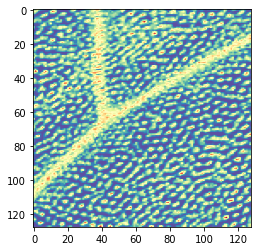

Epoch 213/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 0.9997 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00213: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.520870425643768, 'val_acc': 0.9946524051421466, 'loss': 0.4815893943405259, 'acc': 0.999717992036543, 'lr': 0.0}


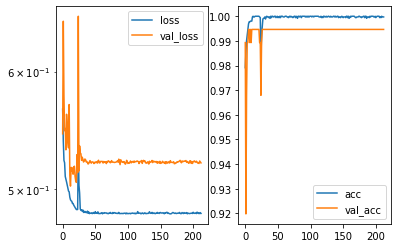

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.49979135]]
True positional value x 0.5
y [[0.5040815]]
True positional value y 0.5


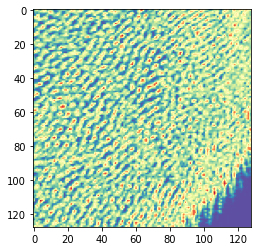

Epoch 214/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5233 - val_acc: 0.9947

Epoch 00214: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5233297391052552, 'val_acc': 0.9946524051421466, 'loss': 0.4815657447269255, 'acc': 1.0, 'lr': 0.0}


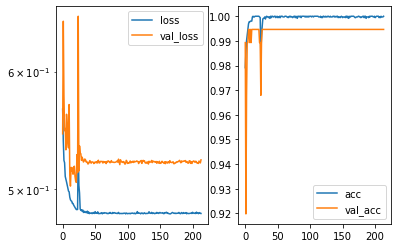

Predicted cell: Landmark Probability: [[0.99999976]]
True Cell type: Landmark
x [[0.47697484]]
True positional value x 0.5
y [[0.49907237]]
True positional value y 0.5


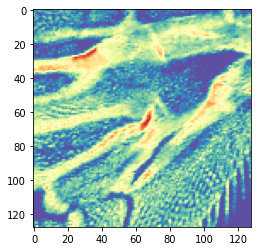

Epoch 215/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00215: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213757826682718, 'val_acc': 0.9946524051421466, 'loss': 0.48156002037819673, 'acc': 1.0, 'lr': 0.0}


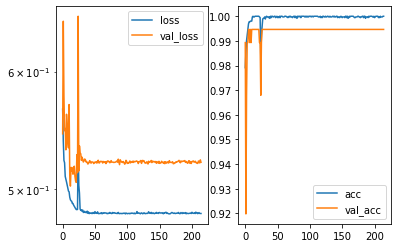

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.43620583]]
True positional value x 0.421875
y [[0.56008387]]
True positional value y 0.578125


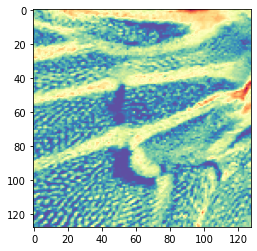

Epoch 216/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4826 - acc: 0.9997 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00216: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217467071538303, 'val_acc': 0.9946524051421466, 'loss': 0.48262862672055434, 'acc': 0.999717992036543, 'lr': 0.0}


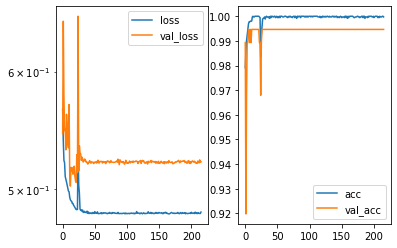

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.5202747]]
True positional value x 0.5
y [[0.48377743]]
True positional value y 0.5


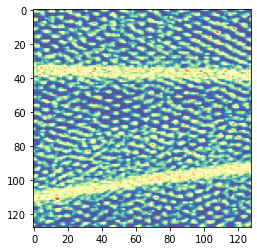

Epoch 217/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00217: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219038823709131, 'val_acc': 0.9946524051421466, 'loss': 0.481465055101414, 'acc': 1.0, 'lr': 0.0}


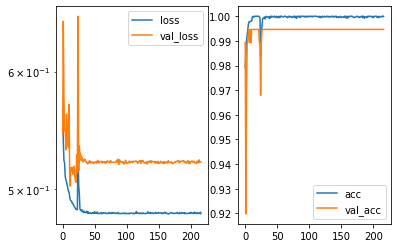

Predicted cell: Background Probability: [[0.999869]]
True Cell type: Background
x [[0.47905427]]
True positional value x 0.5
y [[0.5239005]]
True positional value y 0.5


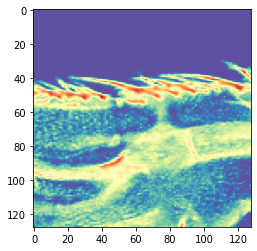

Epoch 218/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00218: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5217864126126397, 'val_acc': 0.9946524051421466, 'loss': 0.481493508822489, 'acc': 1.0, 'lr': 0.0}


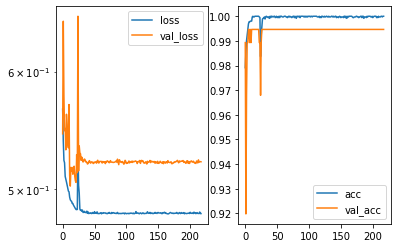

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.50945807]]
True positional value x 0.5
y [[0.5003004]]
True positional value y 0.5


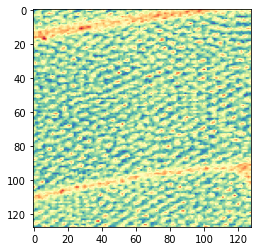

Epoch 219/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00219: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5214630147033834, 'val_acc': 0.9946524051421466, 'loss': 0.48151385599250385, 'acc': 1.0, 'lr': 0.0}


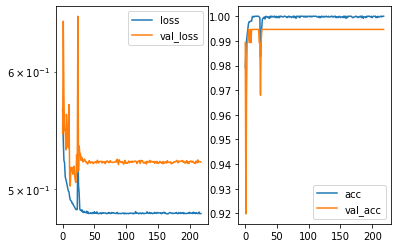

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5106768]]
True positional value x 0.5
y [[0.4147033]]
True positional value y 0.421875


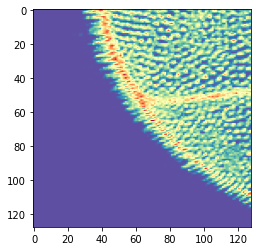

Epoch 220/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4825 - acc: 0.9997 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00220: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5211540890887459, 'val_acc': 0.9946524051421466, 'loss': 0.4825075357496839, 'acc': 0.999717992036543, 'lr': 0.0}


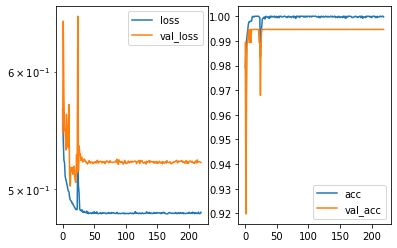

Predicted cell: Landmark Probability: [[0.9995203]]
True Cell type: Landmark
x [[0.41855627]]
True positional value x 0.421875
y [[0.4907443]]
True positional value y 0.5


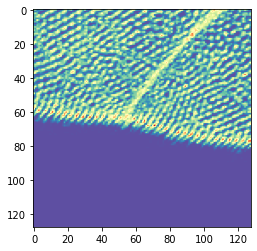

Epoch 221/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5195 - val_acc: 0.9947

Epoch 00221: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5195234609160194, 'val_acc': 0.9946524051421466, 'loss': 0.4815774256236393, 'acc': 1.0, 'lr': 0.0}


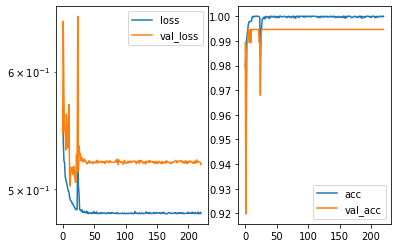

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48007825]]
True positional value x 0.5
y [[0.4358328]]
True positional value y 0.421875


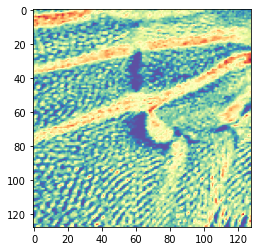

Epoch 222/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4819 - acc: 1.0000 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00222: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206127566768524, 'val_acc': 0.9946524051421466, 'loss': 0.4818518878676699, 'acc': 1.0, 'lr': 0.0}


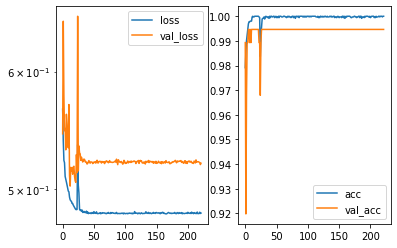

Predicted cell: Background Probability: [[0.9999995]]
True Cell type: Background
x [[0.49336338]]
True positional value x 0.5
y [[0.47885048]]
True positional value y 0.5


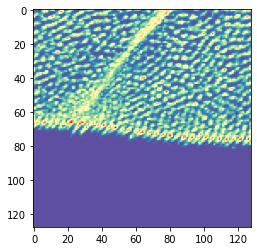

Epoch 223/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00223: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220462997010685, 'val_acc': 0.9946524051421466, 'loss': 0.4815784692428103, 'acc': 1.0, 'lr': 0.0}


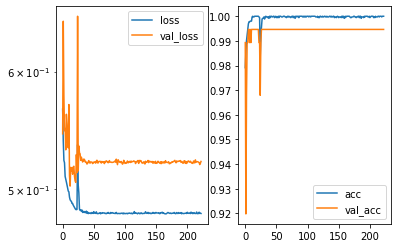

Predicted cell: Landmark Probability: [[0.9999821]]
True Cell type: Landmark
x [[0.40413946]]
True positional value x 0.421875
y [[0.49700415]]
True positional value y 0.5


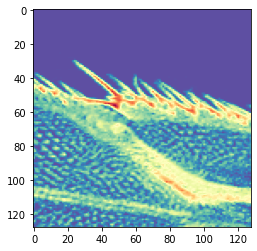

Epoch 224/250
3546/3546 [==============================] - 82s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5209 - val_acc: 0.9947

Epoch 00224: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.520929897851485, 'val_acc': 0.9946524051421466, 'loss': 0.48155059754949336, 'acc': 1.0, 'lr': 0.0}


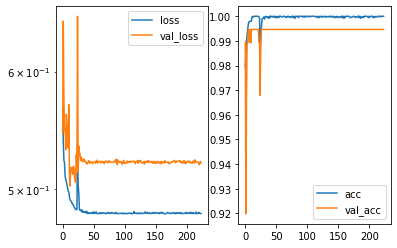

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.41622448]]
True positional value x 0.421875
y [[0.5199684]]
True positional value y 0.5


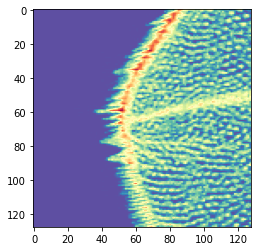

Epoch 225/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5214 - val_acc: 0.9947

Epoch 00225: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5213680538264188, 'val_acc': 0.9946524051421466, 'loss': 0.4813653386990633, 'acc': 1.0, 'lr': 0.0}


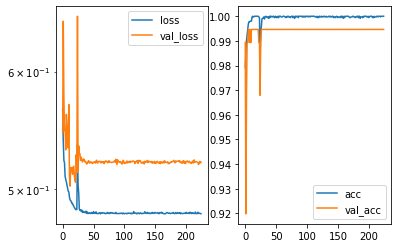

Predicted cell: Landmark Probability: [[0.999959]]
True Cell type: Landmark
x [[0.42101556]]
True positional value x 0.421875
y [[0.56974125]]
True positional value y 0.578125


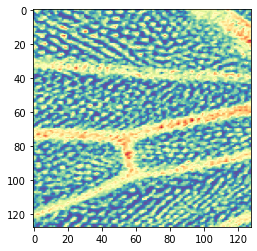

Epoch 226/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4826 - acc: 0.9997 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00226: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5205608909142846, 'val_acc': 0.9946524051421466, 'loss': 0.4826111003327894, 'acc': 0.999717992036543, 'lr': 0.0}


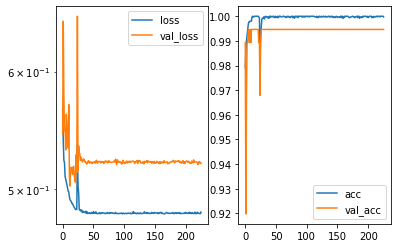

Predicted cell: Landmark Probability: [[0.9999994]]
True Cell type: Landmark
x [[0.5537269]]
True positional value x 0.578125
y [[0.44950306]]
True positional value y 0.421875


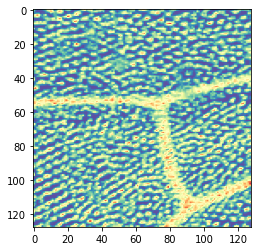

Epoch 227/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4828 - acc: 0.9994 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00227: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5222174848783463, 'val_acc': 0.9946524051421466, 'loss': 0.48278429441981846, 'acc': 0.999435984073086, 'lr': 0.0}


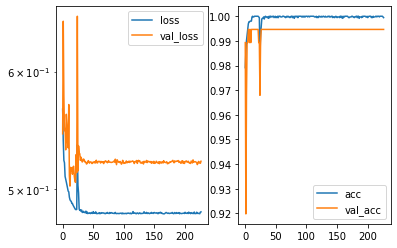

Predicted cell: Background Probability: [[0.9995983]]
True Cell type: Background
x [[0.5223966]]
True positional value x 0.5
y [[0.49629843]]
True positional value y 0.5


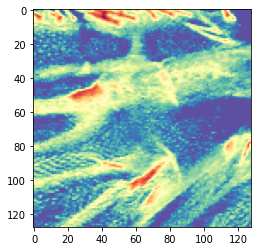

Epoch 228/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00228: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218035691880925, 'val_acc': 0.9946524051421466, 'loss': 0.48152026532399606, 'acc': 1.0, 'lr': 0.0}


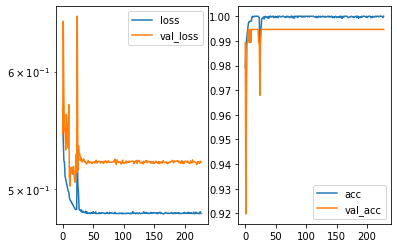

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.48884478]]
True positional value x 0.5
y [[0.49494207]]
True positional value y 0.5


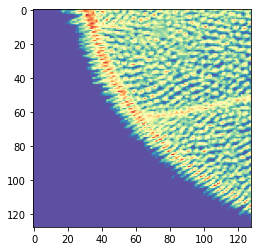

Epoch 229/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5217 - val_acc: 0.9947

Epoch 00229: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216775724594606, 'val_acc': 0.9946524051421466, 'loss': 0.4814449501824258, 'acc': 1.0, 'lr': 0.0}


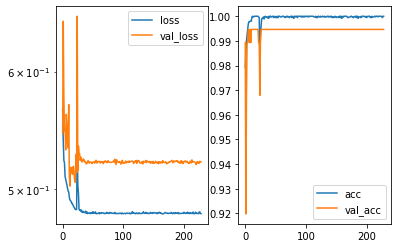

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.49001965]]
True positional value x 0.5
y [[0.49439776]]
True positional value y 0.5


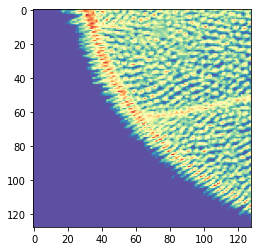

Epoch 230/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00230: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5215910942477976, 'val_acc': 0.9946524051421466, 'loss': 0.48146075430524193, 'acc': 1.0, 'lr': 0.0}


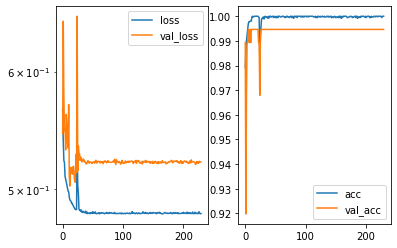

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.5207986]]
True positional value x 0.5
y [[0.521407]]
True positional value y 0.5


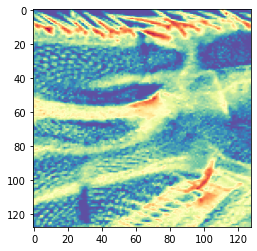

Epoch 231/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 1.0000 - val_loss: 0.5206 - val_acc: 0.9947

Epoch 00231: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5206010845255724, 'val_acc': 0.9946524051421466, 'loss': 0.4815172550709182, 'acc': 1.0, 'lr': 0.0}


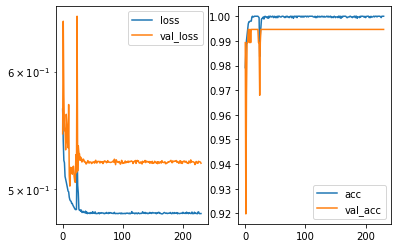

Predicted cell: Landmark Probability: [[0.99999845]]
True Cell type: Landmark
x [[0.44601575]]
True positional value x 0.421875
y [[0.57624596]]
True positional value y 0.578125


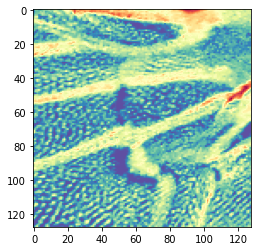

Epoch 232/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5197 - val_acc: 0.9947

Epoch 00232: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5197357546518193, 'val_acc': 0.9946524051421466, 'loss': 0.48159132498640567, 'acc': 1.0, 'lr': 0.0}


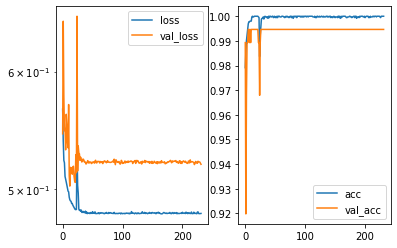

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5052407]]
True positional value x 0.421875
y [[0.5418312]]
True positional value y 0.421875


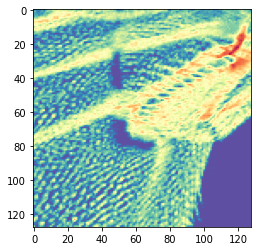

Epoch 233/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4815 - acc: 0.9997 - val_loss: 0.5207 - val_acc: 0.9947

Epoch 00233: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5207278564333279, 'val_acc': 0.9946524051421466, 'loss': 0.4814705546132199, 'acc': 0.999717992036543, 'lr': 0.0}


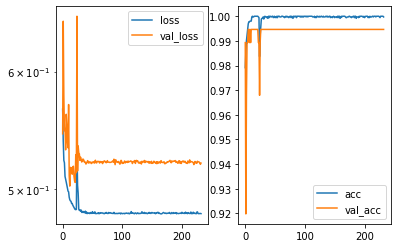

Predicted cell: Landmark Probability: [[0.99999857]]
True Cell type: Landmark
x [[0.57861066]]
True positional value x 0.578125
y [[0.5058824]]
True positional value y 0.5


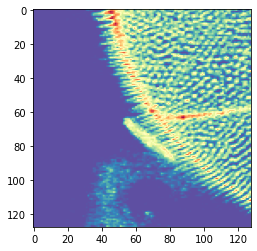

Epoch 234/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4818 - acc: 0.9997 - val_loss: 0.5212 - val_acc: 0.9947

Epoch 00234: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5211705375801433, 'val_acc': 0.9946524051421466, 'loss': 0.4818220433715502, 'acc': 0.999717992036543, 'lr': 0.0}


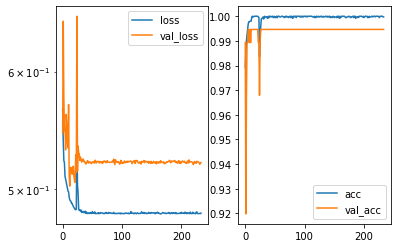

Predicted cell: Background Probability: [[0.99044317]]
True Cell type: Background
x [[0.48011646]]
True positional value x 0.5
y [[0.47045353]]
True positional value y 0.5


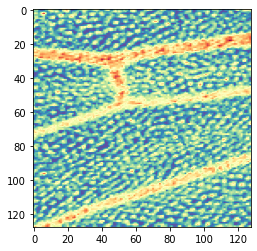

Epoch 235/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4817 - acc: 0.9997 - val_loss: 0.5231 - val_acc: 0.9947

Epoch 00235: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5231194633213594, 'val_acc': 0.9946524051421466, 'loss': 0.4816774610436306, 'acc': 0.999717992036543, 'lr': 0.0}


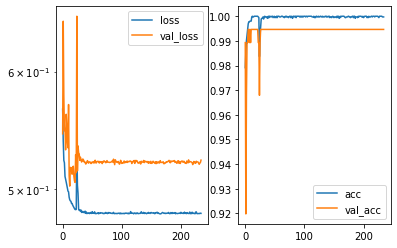

Predicted cell: Landmark Probability: [[0.9999585]]
True Cell type: Landmark
x [[0.59396636]]
True positional value x 0.578125
y [[0.39368838]]
True positional value y 0.421875


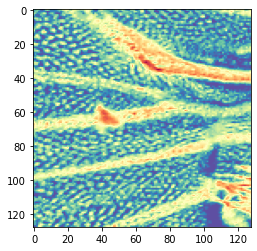

Epoch 236/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4830 - acc: 0.9989 - val_loss: 0.5229 - val_acc: 0.9947

Epoch 00236: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5228913555489504, 'val_acc': 0.9946524051421466, 'loss': 0.48304078959504293, 'acc': 0.998871968146172, 'lr': 0.0}


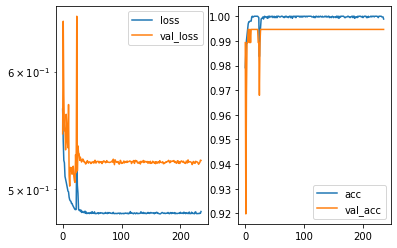

Predicted cell: Landmark Probability: [[0.99999106]]
True Cell type: Landmark
x [[0.40562767]]
True positional value x 0.421875
y [[0.58957464]]
True positional value y 0.578125


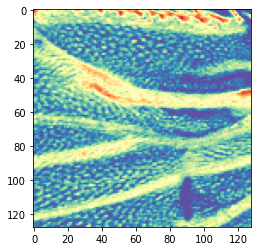

Epoch 237/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00237: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218529608797899, 'val_acc': 0.9946524051421466, 'loss': 0.48138773804388674, 'acc': 1.0, 'lr': 0.0}


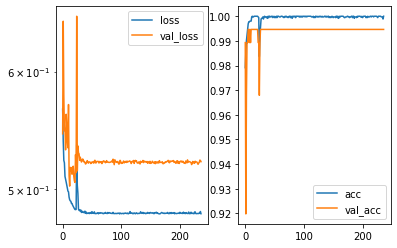

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.520418]]
True positional value x 0.5
y [[0.49197772]]
True positional value y 0.5


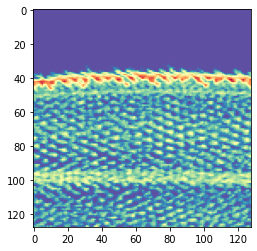

Epoch 238/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5220 - val_acc: 0.9947

Epoch 00238: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5219512360299973, 'val_acc': 0.9946524051421466, 'loss': 0.48167061920026166, 'acc': 1.0, 'lr': 0.0}


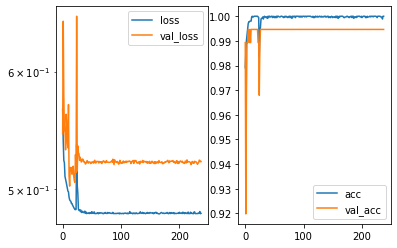

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.50397456]]
True positional value x 0.421875
y [[0.54228204]]
True positional value y 0.421875


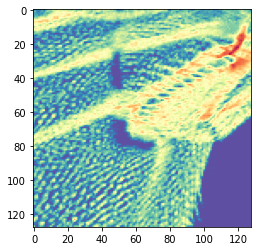

Epoch 239/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4817 - acc: 1.0000 - val_loss: 0.5203 - val_acc: 0.9947

Epoch 00239: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5203184303752879, 'val_acc': 0.9946524051421466, 'loss': 0.4816878227715565, 'acc': 1.0, 'lr': 0.0}


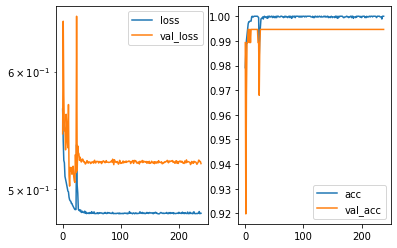

Predicted cell: Background Probability: [[0.99999976]]
True Cell type: Background
x [[0.48669258]]
True positional value x 0.5
y [[0.51492137]]
True positional value y 0.5


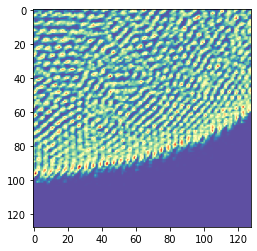

Epoch 240/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5218 - val_acc: 0.9947

Epoch 00240: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521805454862309, 'val_acc': 0.9946524051421466, 'loss': 0.4817799367914076, 'acc': 1.0, 'lr': 0.0}


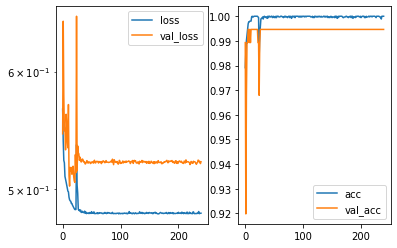

Predicted cell: Background Probability: [[0.999803]]
True Cell type: Background
x [[0.5073775]]
True positional value x 0.5
y [[0.4942318]]
True positional value y 0.5


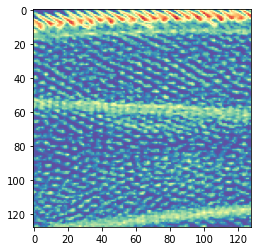

Epoch 241/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5208 - val_acc: 0.9947

Epoch 00241: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5207989944174966, 'val_acc': 0.9946524051421466, 'loss': 0.48143945295664126, 'acc': 1.0, 'lr': 0.0}


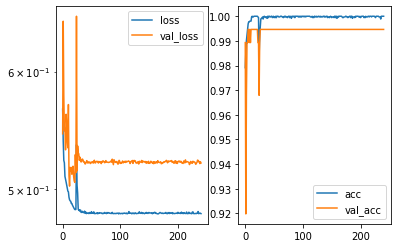

Predicted cell: Background Probability: [[0.9997925]]
True Cell type: Background
x [[0.53148556]]
True positional value x 0.5
y [[0.47719494]]
True positional value y 0.5


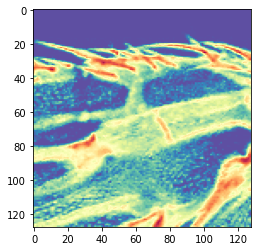

Epoch 242/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4816 - acc: 1.0000 - val_loss: 0.5204 - val_acc: 0.9947

Epoch 00242: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5203603485370065, 'val_acc': 0.9946524051421466, 'loss': 0.4815561197198049, 'acc': 1.0, 'lr': 0.0}


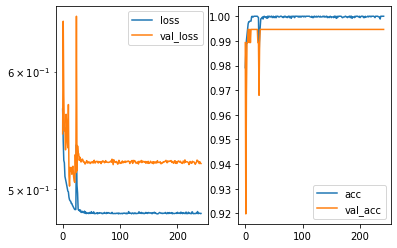

Predicted cell: Landmark Probability: [[0.9999987]]
True Cell type: Landmark
x [[0.5564389]]
True positional value x 0.578125
y [[0.51151675]]
True positional value y 0.5


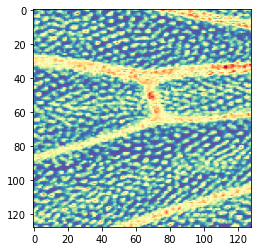

Epoch 243/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4819 - acc: 0.9997 - val_loss: 0.5216 - val_acc: 0.9947

Epoch 00243: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5216130402317659, 'val_acc': 0.9946524051421466, 'loss': 0.48193590547227616, 'acc': 0.999717992036543, 'lr': 0.0}


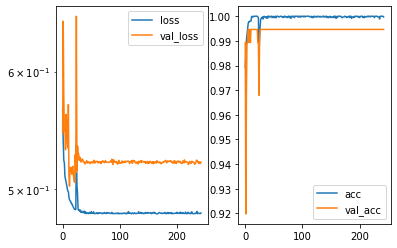

Predicted cell: Landmark Probability: [[0.99946934]]
True Cell type: Background
x [[0.5081391]]
True positional value x 0.5
y [[0.46530026]]
True positional value y 0.5


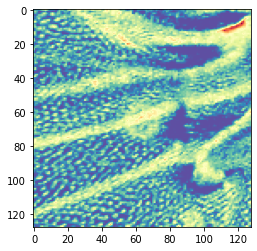

Epoch 244/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5222 - val_acc: 0.9947

Epoch 00244: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5222237132449838, 'val_acc': 0.9946524051421466, 'loss': 0.48144027696648223, 'acc': 1.0, 'lr': 0.0}


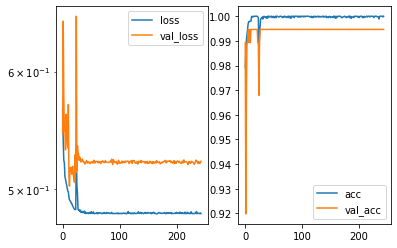

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.58160675]]
True positional value x 0.578125
y [[0.4202835]]
True positional value y 0.421875


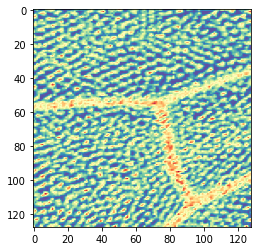

Epoch 245/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5215 - val_acc: 0.9947

Epoch 00245: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.521511763493645, 'val_acc': 0.9946524051421466, 'loss': 0.4813952517422054, 'acc': 1.0, 'lr': 0.0}


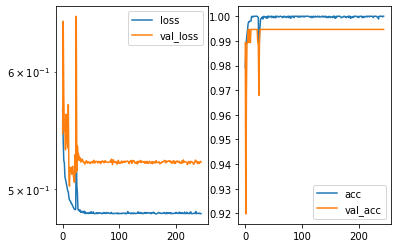

Predicted cell: Landmark Probability: [[1.]]
True Cell type: Landmark
x [[0.51056105]]
True positional value x 0.5
y [[0.4096805]]
True positional value y 0.421875


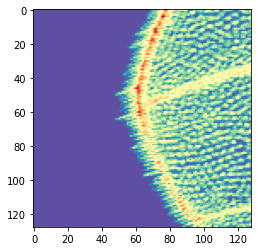

Epoch 246/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5211 - val_acc: 0.9947

Epoch 00246: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5210644835456807, 'val_acc': 0.9946524051421466, 'loss': 0.48180105367825654, 'acc': 1.0, 'lr': 0.0}


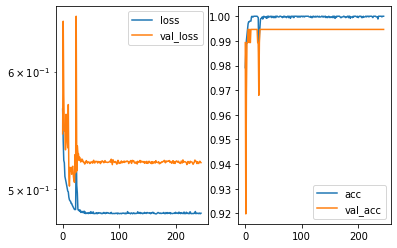

Predicted cell: Landmark Probability: [[0.9999999]]
True Cell type: Landmark
x [[0.5921785]]
True positional value x 0.578125
y [[0.5819708]]
True positional value y 0.578125


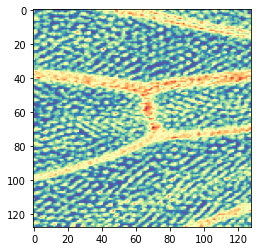

Epoch 247/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4823 - acc: 0.9997 - val_loss: 0.5201 - val_acc: 0.9947

Epoch 00247: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5201057770991708, 'val_acc': 0.9946524051421466, 'loss': 0.4823487803751778, 'acc': 0.999717992036543, 'lr': 0.0}


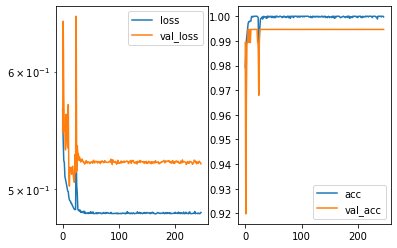

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.4975394]]
True positional value x 0.5
y [[0.49832714]]
True positional value y 0.5


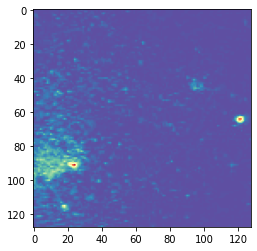

Epoch 248/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4818 - acc: 1.0000 - val_loss: 0.5221 - val_acc: 0.9947

Epoch 00248: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5220904530369662, 'val_acc': 0.9946524051421466, 'loss': 0.48177875755738214, 'acc': 1.0, 'lr': 0.0}


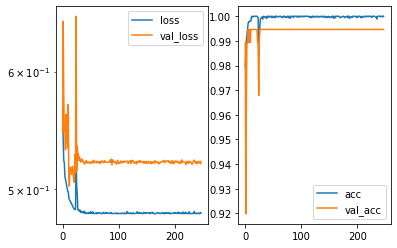

Predicted cell: Background Probability: [[1.]]
True Cell type: Background
x [[0.52032137]]
True positional value x 0.5
y [[0.49154878]]
True positional value y 0.5


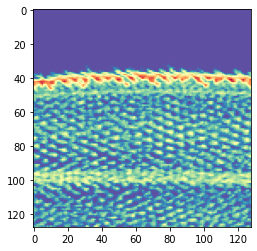

Epoch 249/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4820 - acc: 0.9997 - val_loss: 0.5210 - val_acc: 0.9947

Epoch 00249: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5209874190429953, 'val_acc': 0.9946524051421466, 'loss': 0.48196419715477934, 'acc': 0.999717992036543, 'lr': 0.0}


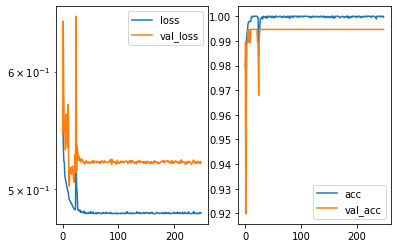

Predicted cell: Landmark Probability: [[0.9995376]]
True Cell type: Landmark
x [[0.59767723]]
True positional value x 0.578125
y [[0.43622342]]
True positional value y 0.421875


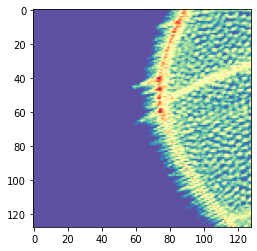

Epoch 250/250
3546/3546 [==============================] - 81s 23ms/step - loss: 0.4814 - acc: 1.0000 - val_loss: 0.5219 - val_acc: 0.9947

Epoch 00250: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128K7s48d56.h5
{'val_loss': 0.5218526735344035, 'val_acc': 0.9946524051421466, 'loss': 0.4814230813962621, 'acc': 1.0, 'lr': 0.0}


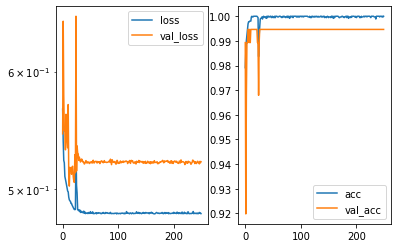

Predicted cell: Landmark Probability: [[0.99999964]]
True Cell type: Landmark
x [[0.48364547]]
True positional value x 0.5
y [[0.4210177]]
True positional value y 0.421875


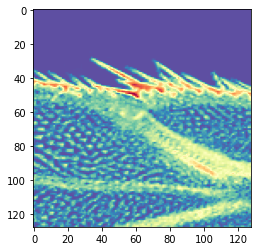

In [5]:
static_model = NEATStatic(config, model_dir, model_name)

static_model.loadData()

static_model.TrainModel()
